In [139]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
import keras
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(123)
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers
from sklearn.decomposition import PCA
from matplotlib.pyplot import figure
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta
from sklearn.metrics import accuracy_score, f1_score

In [140]:
x_train_scaled = pd.read_csv('data/260_sample_train_scaled.csv').set_index("Patient_ID")
x_train_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.0,0.71077,0.0,0.564155,0.0,0.410548,0.0,0.466889,0.0,1.000000
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.0,0.00000,0.0,0.619646,0.0,0.576526,0.0,0.247033,0.0,0.008198
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.0,0.00000,0.0,0.978062,0.0,0.322280,0.0,0.809681,0.0,0.618383
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.0,0.00000,0.0,0.630496,0.0,0.633583,0.0,0.568599,0.0,0.208173
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.0,0.00000,0.0,0.575404,0.0,0.754246,0.0,0.349619,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.0,0.00000,0.0,0.424522,0.0,0.647019,0.0,0.358576,0.0,0.000000
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.0,0.00000,0.0,0.643529,0.0,0.676222,0.0,0.534238,0.0,0.646805
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.0,0.00000,0.0,0.592646,0.0,0.784037,0.0,0.401977,0.0,0.232271


In [141]:
x_test_scaled = pd.read_csv('data/260_sample_test_scaled.csv').set_index("Patient_ID")
x_test_scaled

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
Patient_ID,,,,,,,,,,,,,,,,,,,,,
253_CD_plain,0.869185,0.841880,0.930171,0.886737,0.835678,0.297964,0.668498,0.266670,0.278122,0.933520,...,0.0,0.0,0.0,0.790435,0.0,0.849076,0.0,0.686223,0.0,0.395101
105_CD_plain,0.853562,0.933532,0.942213,0.794578,0.890482,0.206529,0.298987,0.350745,0.495663,0.849038,...,0.0,0.0,0.0,0.917793,0.0,0.604771,0.0,0.668052,0.0,0.671177
2_CD_plain,0.165531,0.141475,0.263684,0.198091,0.160503,0.888878,0.000000,0.134461,0.989132,0.202203,...,0.0,0.0,0.0,0.063827,0.0,0.703353,0.0,0.826523,0.0,0.000000
184_CD_plain,0.717121,0.660314,0.769417,0.752737,0.694874,0.514735,0.692365,0.271127,0.650742,0.694599,...,0.0,0.0,0.0,0.650608,0.0,0.749070,0.0,0.548091,0.0,0.134641
312_CD_plain,0.730072,0.722909,0.713076,0.743545,0.679258,0.308459,0.399235,0.129019,0.597529,0.720390,...,0.0,0.0,0.0,0.481745,0.0,0.717561,0.0,0.541235,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.0,0.0,0.0,0.486418,0.0,0.625206,0.0,0.722622,0.0,0.000000
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.0,0.0,0.0,0.217050,0.0,0.889784,0.0,0.514313,0.0,0.000000
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.0,0.0,0.0,0.492356,0.0,0.744538,0.0,0.494143,0.0,0.165054


In [142]:
full_ds = pd.concat([x_train_scaled, x_test_scaled])
full_ds

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.0,0.71077,0.0,0.564155,0.0,0.410548,0.0,0.466889,0.0,1.000000
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.0,0.00000,0.0,0.619646,0.0,0.576526,0.0,0.247033,0.0,0.008198
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.0,0.00000,0.0,0.978062,0.0,0.322280,0.0,0.809681,0.0,0.618383
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.0,0.00000,0.0,0.630496,0.0,0.633583,0.0,0.568599,0.0,0.208173
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.0,0.00000,0.0,0.575404,0.0,0.754246,0.0,0.349619,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.0,0.00000,0.0,0.486418,0.0,0.625206,0.0,0.722622,0.0,0.000000
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.0,0.00000,0.0,0.217050,0.0,0.889784,0.0,0.514313,0.0,0.000000
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.0,0.00000,0.0,0.492356,0.0,0.744538,0.0,0.494143,0.0,0.165054


In [143]:
x_test_scaled.isnull().values.any()

False

In [144]:
# np.random.seed(37)
# full_ds = full_ds.sample(frac=1)

In [145]:
val_split_pt = int(0.85*len(full_ds))
split_pt = int(0.7*len(full_ds))

In [146]:
train_set = full_ds[:split_pt]
val_set = full_ds[split_pt:val_split_pt]
test_set = full_ds[val_split_pt:]

In [147]:
train_set

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.0,0.71077,0.0,0.564155,0.0,0.410548,0.0,0.466889,0.0,1.000000
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.0,0.00000,0.0,0.619646,0.0,0.576526,0.0,0.247033,0.0,0.008198
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.0,0.00000,0.0,0.978062,0.0,0.322280,0.0,0.809681,0.0,0.618383
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.0,0.00000,0.0,0.630496,0.0,0.633583,0.0,0.568599,0.0,0.208173
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.0,0.00000,0.0,0.575404,0.0,0.754246,0.0,0.349619,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.0,0.00000,0.0,0.424522,0.0,0.647019,0.0,0.358576,0.0,0.000000
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.0,0.00000,0.0,0.643529,0.0,0.676222,0.0,0.534238,0.0,0.646805
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.0,0.00000,0.0,0.592646,0.0,0.784037,0.0,0.401977,0.0,0.232271


### Dimensionality reduction with PCA

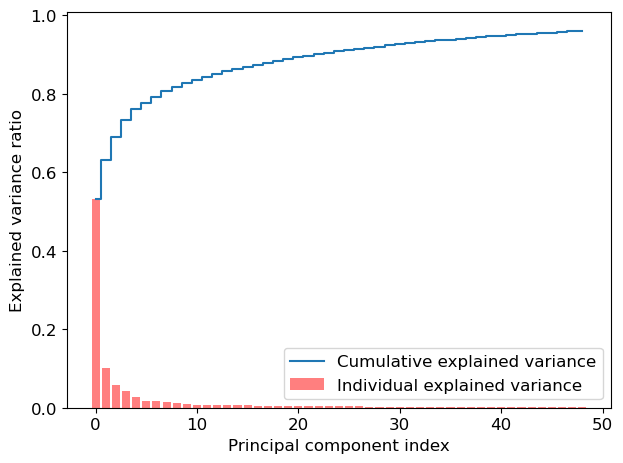

In [148]:
#https://vitalflux.com/pca-explained-variance-concept-python-example/#google_vignette

pca = PCA()
pca = PCA(n_components=.96)
#
# Determine transformed features
#
X_train_pca = pca.fit_transform(train_set)
#
# Determine explained variance using explained_variance_ration_ attribute
#
exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', color='r',label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [149]:
# https://www.datacamp.com/tutorial/principal-component-analysis-in-python

def encode_pca(dataset):
    pca_x_test = PCA(n_components=32)
    principalComponents_x_test = pca_x_test.fit_transform(dataset)
    if isinstance(dataset,np.ndarray):
        index = None
    else:
        index=dataset.index
    pca_x_test_ds = pd.DataFrame(data = principalComponents_x_test, 
                                       index=index)
    return pca_x_test_ds, pca_x_test

# full_pca_dataset, pca_x = encode_pca(full_ds)
# split_pt = int(0.7 * len(full_pca_dataset))
# pca_test_dataset = full_pca_dataset[split_pt:]
# pca_train_dataset = full_pca_dataset[:split_pt]

In [150]:
full_pca_dataset, pca_x = encode_pca(full_ds)
pca_train_dataset = full_pca_dataset[:split_pt]
pca_val_dataset = full_pca_dataset[split_pt:val_split_pt]
pca_test_dataset = full_pca_dataset[val_split_pt:]

In [151]:
train_patient_ids = np.array(pca_train_dataset.index)
val_patient_ids = np.array(pca_val_dataset.index)
test_patient_ids = np.array(pca_test_dataset.index)

In [152]:
train_patient_ids.shape

(182,)

In [153]:
val_patient_ids.shape

(39,)

In [154]:
test_patient_ids.shape

(39,)

In [155]:
# pca_train_dataset.to_csv("pca_train_dataset.csv")

In [156]:
print('Explained variation per principal component: {}'.format(pca_x.explained_variance_ratio_))
print("Total variance explained:",np.sum(pca_x.explained_variance_ratio_))

Explained variation per principal component: [0.53853596 0.0919702  0.05892519 0.0407716  0.03058612 0.01598435
 0.01549314 0.01317914 0.01031886 0.0091349  0.00813014 0.00683253
 0.00642106 0.00603761 0.005815   0.00549894 0.00526735 0.00496973
 0.00466845 0.00434881 0.00421487 0.00378063 0.00366651 0.00349665
 0.00329195 0.0032376  0.00302065 0.00295815 0.00288437 0.00278022
 0.00268527 0.00256023]
Total variance explained: 0.9214662023233582


In [157]:
# pc1_var, pc2_var = np.round(pca_x_test.explained_variance_ratio_ * 100, 1)
# pc1_var

### Dimensionality reduction with autoencoder

In [158]:
def load_encoder():
    n_inputs = 220
    n_bottleneck = 32
    encoder = Sequential(
                [

#                     Input(shape=(n_inputs,)),
                    # encoder level 1
                    Dense(n_inputs*2),
                    BatchNormalization(),
                    LeakyReLU(),
                    # encoder level 2
                    Dense(n_inputs),
                    BatchNormalization(),
                    LeakyReLU(),
                    # bottleneck
                    Dense(n_bottleneck)
                ]
            )

    sh = test_set.head(1).shape
    encoder.load_weights("data/models/cd_encoder")
    encoder.build(sh) 
#     encoder.summary()
    return encoder

In [159]:
def ae_encode_dataset(dataset):
    encoder = load_encoder()
    latent_var = np.arange(32)
    print(type(dataset))
    if isinstance(dataset,np.ndarray):
        recon = encoder(dataset)
        index=None
    else:
        recon = encoder(dataset.values)
        index = dataset.index
    r = pd.DataFrame(recon, columns=latent_var, index=index)
    return r
    
full_ae_dataset = ae_encode_dataset(full_ds)

# split_pt = int(0.7 * len(full_ae_dataset))
# ae_test_dataset = full_ae_dataset[split_pt:]
# ae_train_dataset = full_ae_dataset[:split_pt]

<class 'pandas.core.frame.DataFrame'>


In [160]:
# ae_train_dataset

## True labels

In [161]:
def classify(x):
    if "_control" in x: # control
        return 0
    elif "CD_plain" in x: # Crohn's Disease no deep ulcer
#         print(x)
        return 1
    elif "CD_deep_ulcer" in x: # Crohn's Disease deep ulcer
#         print(x)
        return 2
    else:
        return 3 # Ulcerative Collitis

vec = np.vectorize(classify)

train_disease_labels = vec(train_patient_ids)
val_disease_labels = vec(val_patient_ids)
test_disease_labels = vec(test_patient_ids)

In [162]:
full_disease_labels = np.concatenate([train_disease_labels, val_disease_labels, test_disease_labels])

In [163]:
full_disease_labels.shape

(260,)

In [164]:
with open("data/d_labels", "wb") as fp:   #Pickling
    pickle.dump(full_disease_labels, fp)

In [165]:
import matplotlib.pyplot as plt

from matplotlib.ticker import NullFormatter
from sklearn import manifold, datasets
from time import time

## KMeans clustering

### Fit KMeans (PCA & tSNE dimensionality reduction)

In [166]:
def compute_silh_scores(datapoints, cluster_labels):
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(datapoints, cluster_labels)


    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(datapoints, cluster_labels)
    
    return silhouette_avg, sample_silhouette_values

def plot_silhouette(n_clusters, cluster_labels, sample_silhouette_values, silhouette_avg, ax):
    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax.set_title("The silhouette plot for the various clusters.")
    ax.set_xlabel("The silhouette coefficient values")
    ax.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax.set_yticks([])  # Clear the yaxis labels / ticks
    ax.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

In [167]:
train_disease_labels.shape

(182,)

In [168]:
# https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html


def plot_kmeans(X, X_val, disease_labels, val_disease_labels, k_labels, k_labels_val, centers, radii, reduction, num_c=4, test_set=True, plot_sil=False):

    num_rows = 2 if plot_sil else 1
    dim_h = 12 if plot_sil else 6
    dim_w = 15 if plot_sil else 15
    (fig, subplots) = plt.subplots(num_rows, 2, figsize=(dim_w, dim_h))
    


    label_sets = [k_labels, disease_labels]
    num_clusters = 3
    dset = "test" if test_set else "train"


    for i, label_set in enumerate(label_sets):
        
        ax = subplots[0][i] if plot_sil else subplots[i]

        dset = "test" if test_set else "train"

        if i==0:
            num_clusters = num_c
            cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
            colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
            ax.set_title("KMeans clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        else:
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("KMeans clustering on " + dset + " set with true labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        for i in range(num_clusters):
            ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 



        for c, r in zip(centers, radii):
            ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

#         if selected_patient_idx is not None:
#             ax.scatter(Y[selected_patient_idx, 0], Y[selected_patient_idx, 1], c="cyan", s=400, marker='*',edgecolor='black', linewidth=.7, label="Selected patient")

        ax.legend()

        ax.axis("tight")
        
    if plot_sil:
        silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val, k_labels_val)
        plot_silhouette(num_c, k_labels_val, sample_silhouette_values, silhouette_avg, subplots[1][0])
        acc = accuracy_score(val_disease_labels, k_labels_val)
        f1 = f1_score(val_disease_labels, k_labels_val, average='weighted')
        ax = subplots[1][1]
        num_clusters = num_c
        cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
        colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
        ax.set_title("KMeans clustering on validation set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                     wrap=True)
        for i in range(num_clusters):
            ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 
        for c, r in zip(centers, radii):
            ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

        ax.legend()

    
    plt.show()
    if plot_sil:
        print("The average silhouette_score is :",silhouette_avg)
        print("Accuracy:",acc)
        print("F1 score:",f1)
        
        return silhouette_avg, acc, f1
        




### Training

In [169]:
def train_kmeans(full_dataset, perplexity):
    # compress to 2D with tSNE
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=perplexity,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_dataset)
    split_pt = int(0.85 * len(full_dataset))
    val_split_pt = int(0.7 * len(full_dataset))
    X_test = X[split_pt:]
    X_train = X[:val_split_pt]
    X_val = X[val_split_pt:split_pt]
    # X_train = np.concatenate([X[:split_pt], X[-num_c:]])

    num_c=4
    kmeans = KMeans(num_c, random_state=0).fit(X_train)
    k_labels_train = kmeans.predict(X_train)
    k_labels_val = kmeans.predict(X_val)
    k_labels_test = kmeans.predict(X_test)


    # representation of the KMeans model (both)
    # centers = X[-num_c:]
    centers = kmeans.cluster_centers_
    radii = [cdist(X_train[k_labels_train == i], [center]).max()
             for i, center in enumerate(centers)]
    
    return kmeans, X_train, X_val, X_test, k_labels_train, k_labels_val, k_labels_test, centers, radii

In [170]:
def plot_val_scores(sil_scores, acc_scores, f1_scores, reduction):
    plt.figure()
    plt.plot(perplexities, sil_scores, label="Avg silhouette score")
    plt.plot(perplexities, acc_scores, label="Accuracy")
    plt.plot(perplexities, f1_scores, label="F1-score")
    plt.xlabel("Perplexity")
    plt.ylabel("Score")
    plt.title("Effect of tSNE perplexity value on clustering evaluation over validation set ("+reduction+" reduction)")

    plt.legend()
    plt.show()

In [171]:
np.arange(0, 251, 10)[1:]

array([ 10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120, 130,
       140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250])

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


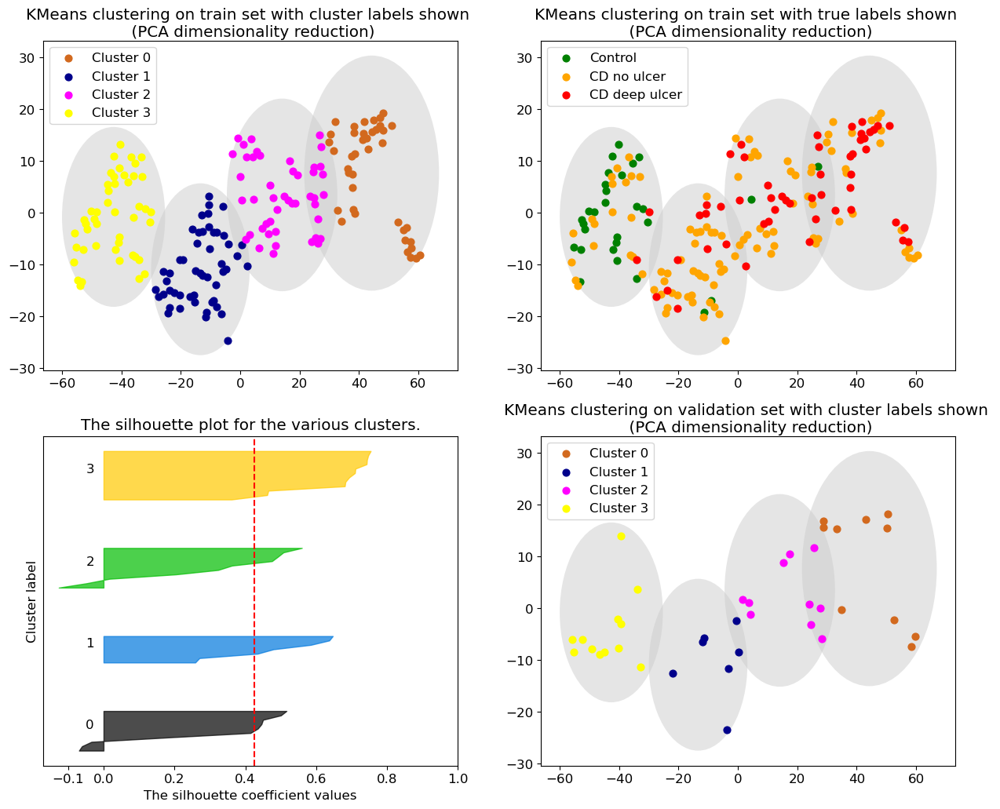

The average silhouette_score is : 0.42593542
Accuracy: 0.28205128205128205
F1 score: 0.3732818905232699


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 20


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


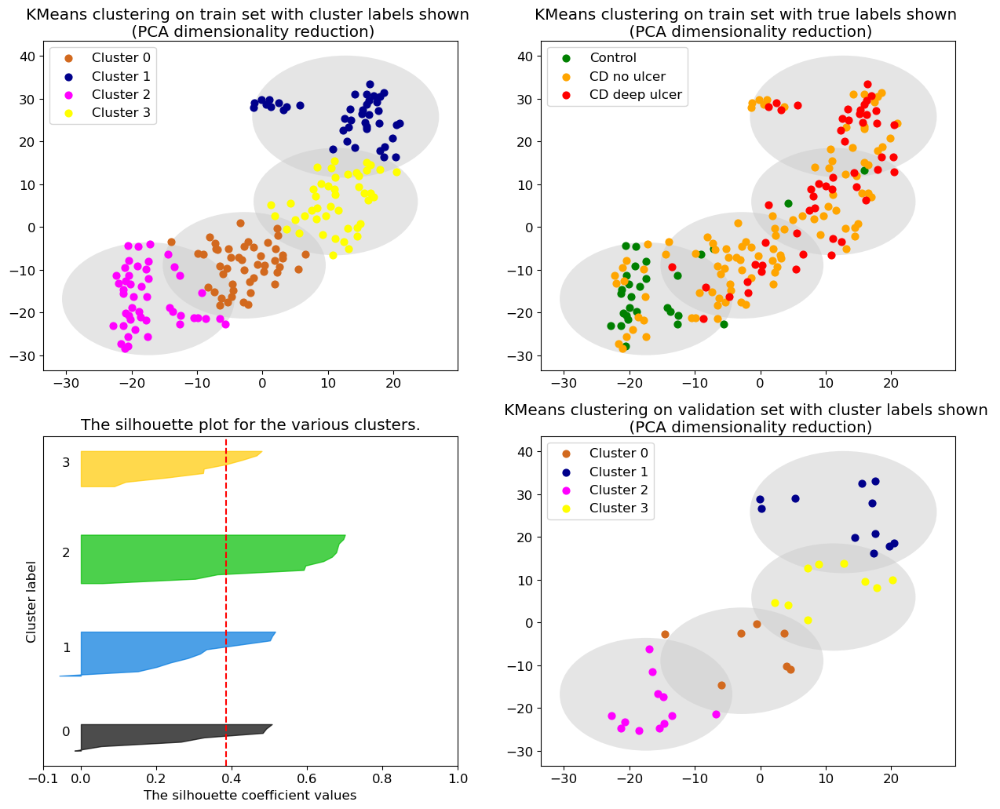

The average silhouette_score is : 0.385177
Accuracy: 0.15384615384615385
F1 score: 0.19658119658119658


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


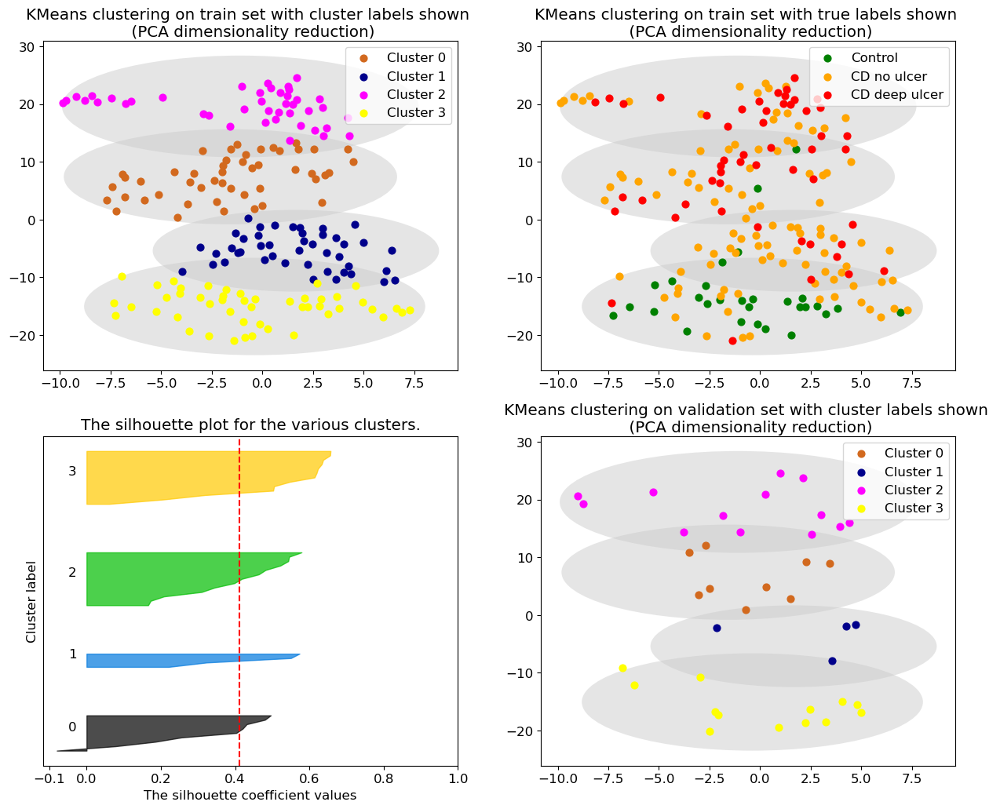

The average silhouette_score is : 0.41200823
Accuracy: 0.2564102564102564
F1 score: 0.3024852071005917


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 40


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


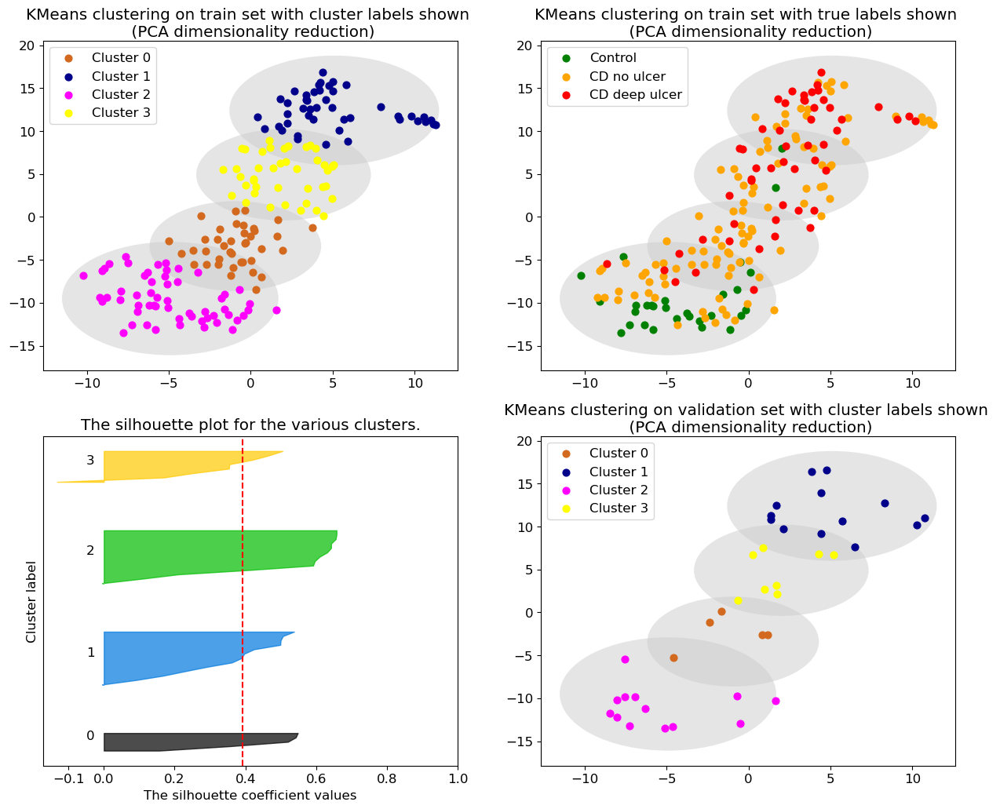

The average silhouette_score is : 0.39217427
Accuracy: 0.1794871794871795
F1 score: 0.218021978021978


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 50


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


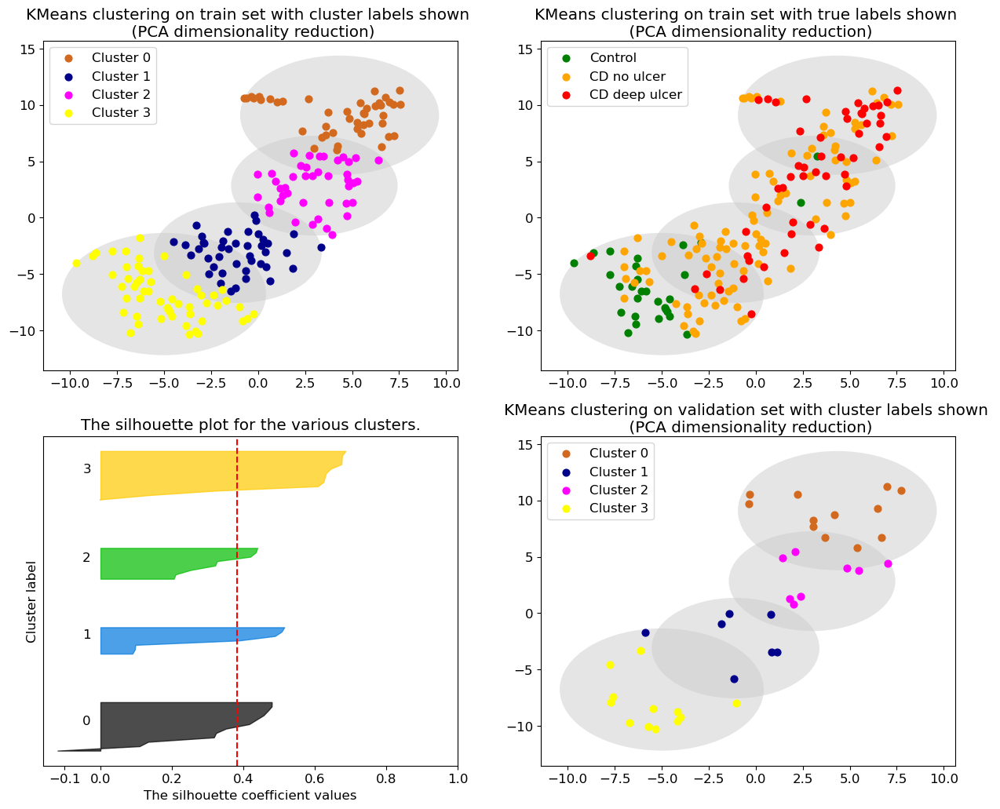

The average silhouette_score is : 0.38311043
Accuracy: 0.23076923076923078
F1 score: 0.3257294429708223


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 60


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


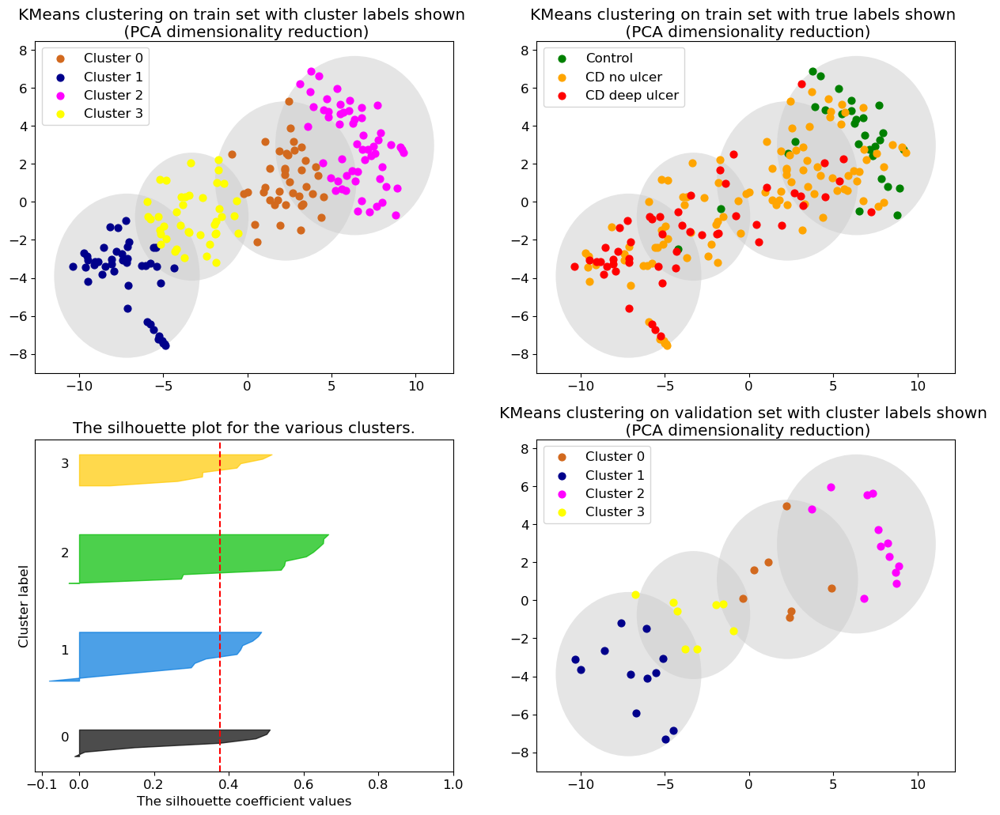

The average silhouette_score is : 0.37606594
Accuracy: 0.15384615384615385
F1 score: 0.19155354449472098


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 70


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


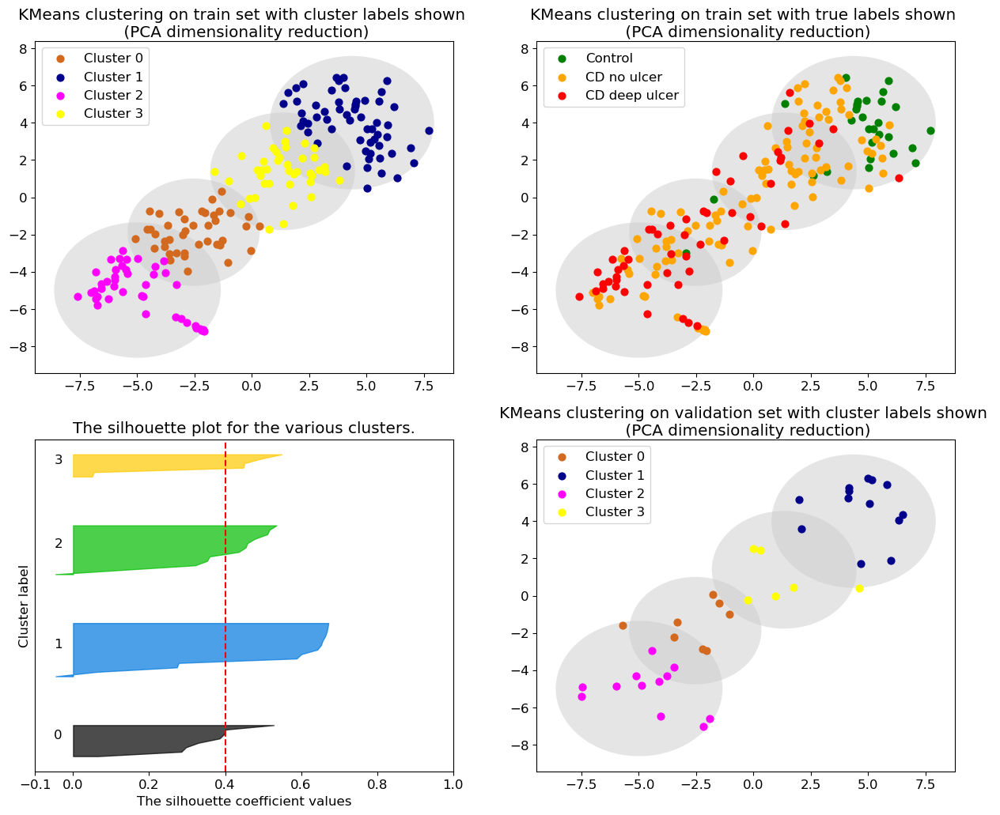

The average silhouette_score is : 0.40076837
Accuracy: 0.358974358974359
F1 score: 0.4051282051282051


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 80


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


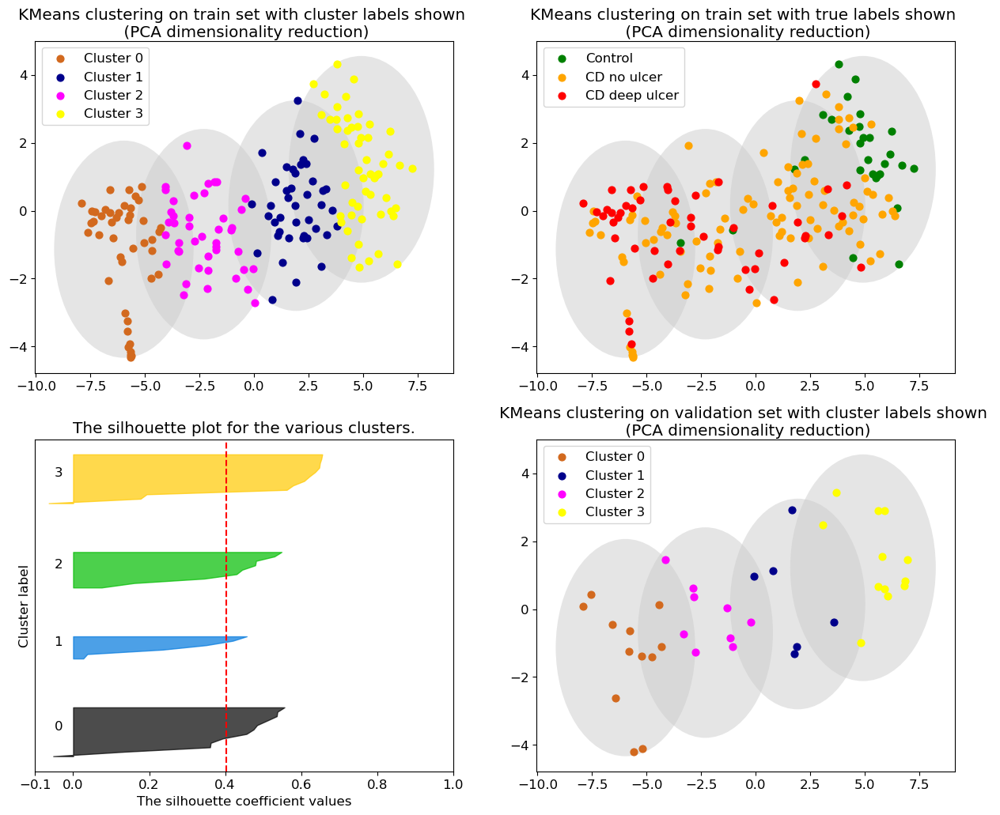

The average silhouette_score is : 0.40235788
Accuracy: 0.20512820512820512
F1 score: 0.2893772893772894


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 90


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


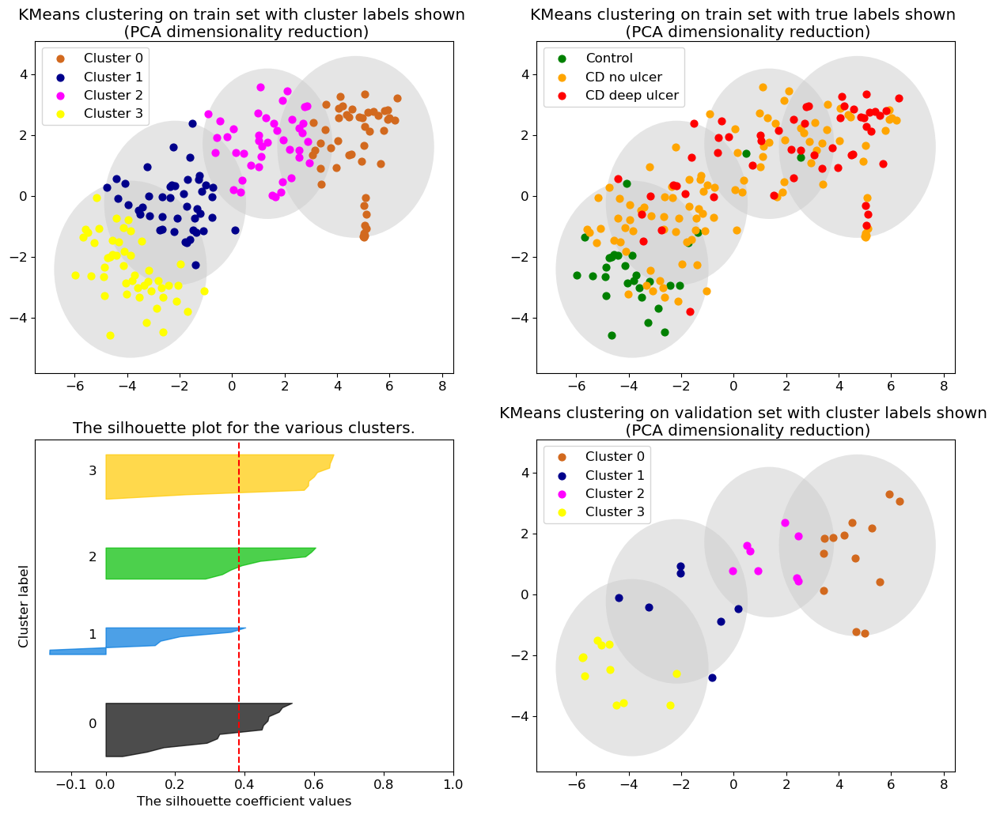

The average silhouette_score is : 0.38357973
Accuracy: 0.23076923076923078
F1 score: 0.3257294429708223


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 100


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


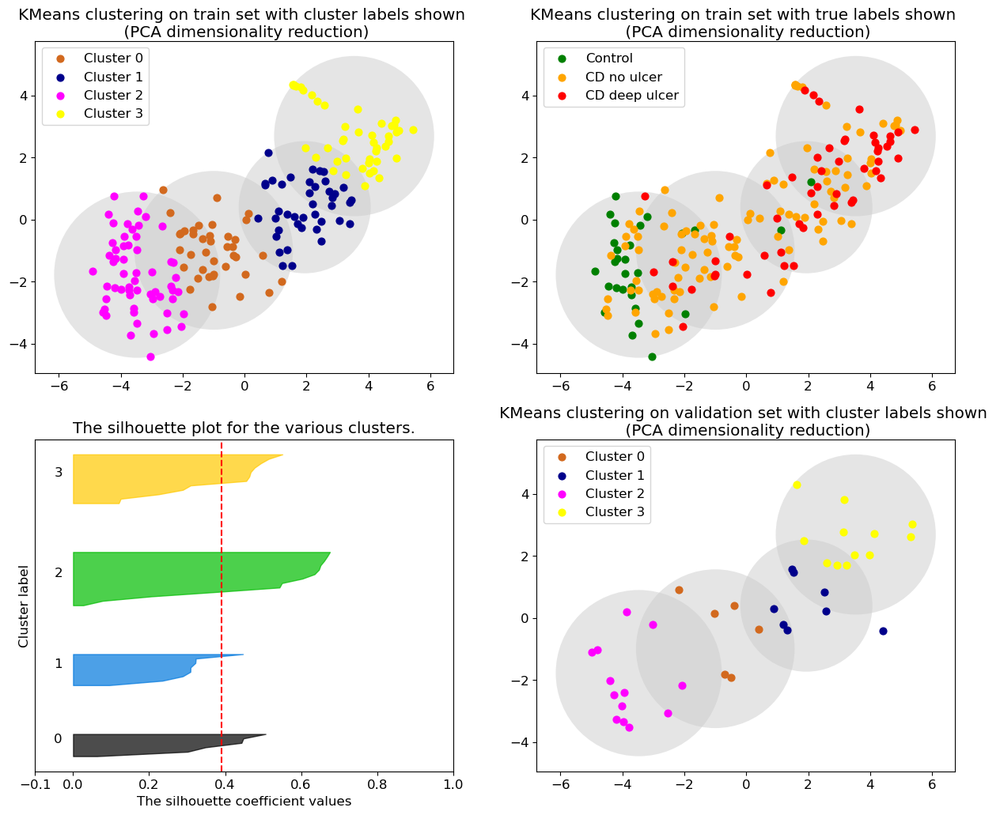

The average silhouette_score is : 0.39105302
Accuracy: 0.15384615384615385
F1 score: 0.21264957264957265


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 110


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


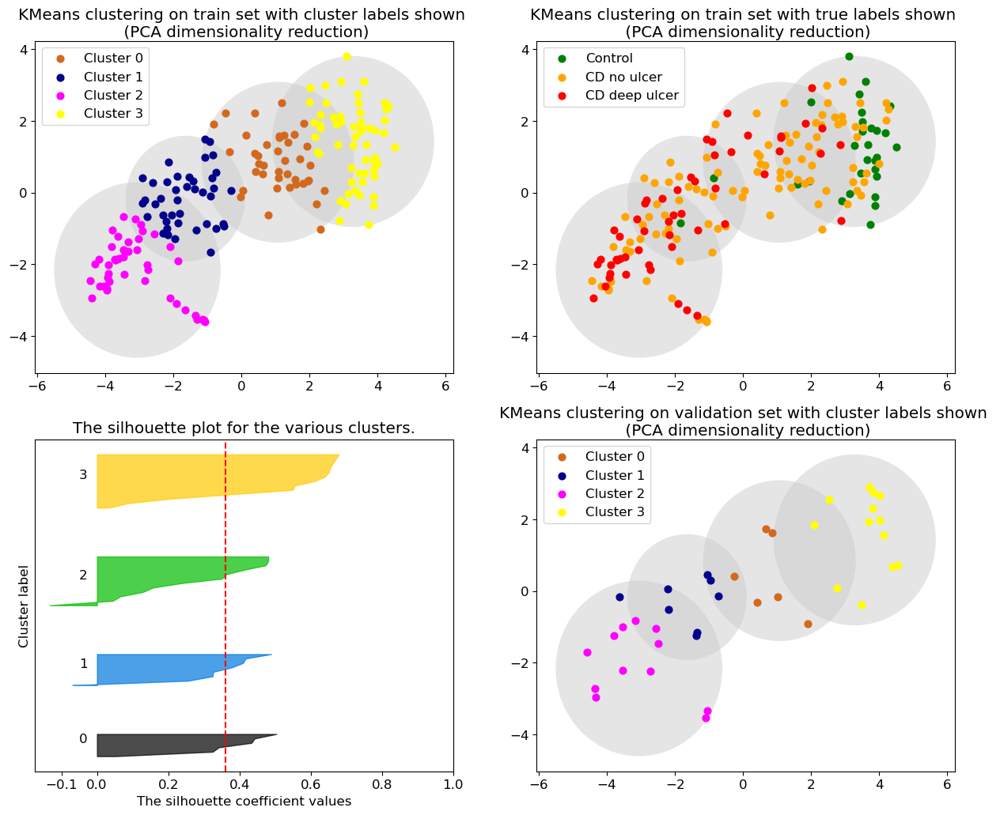

The average silhouette_score is : 0.36070743
Accuracy: 0.3076923076923077
F1 score: 0.3675213675213675


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


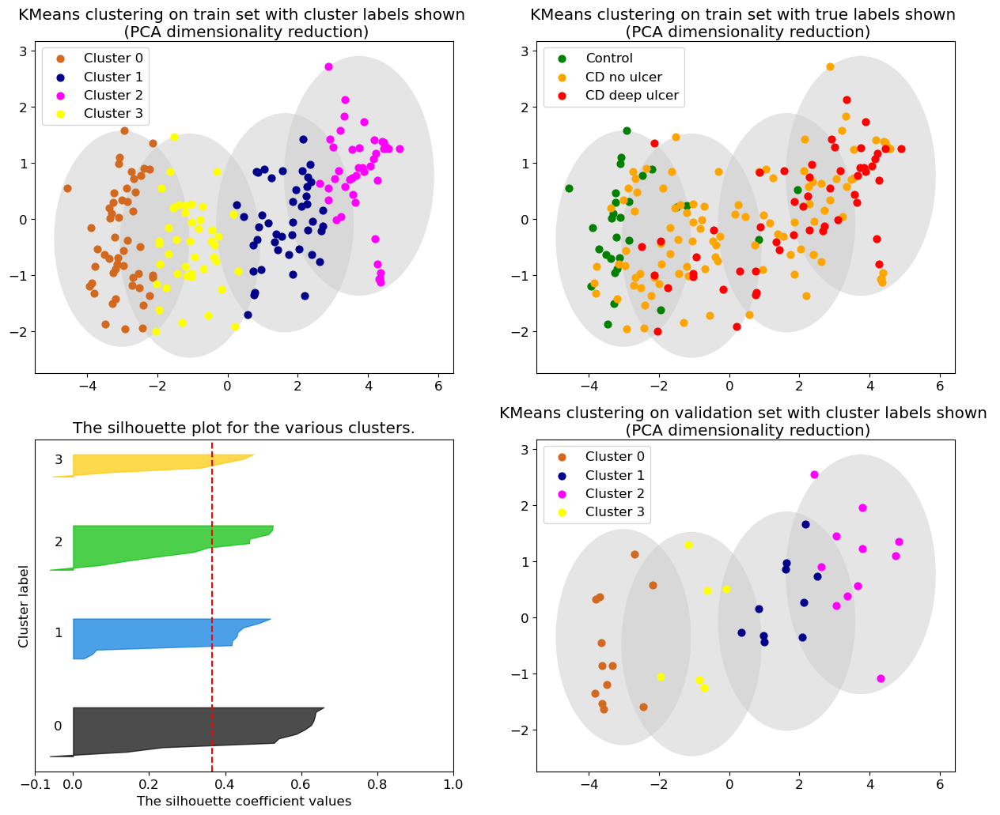

The average silhouette_score is : 0.36655486
Accuracy: 0.4358974358974359
F1 score: 0.44748835989245184


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 130


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


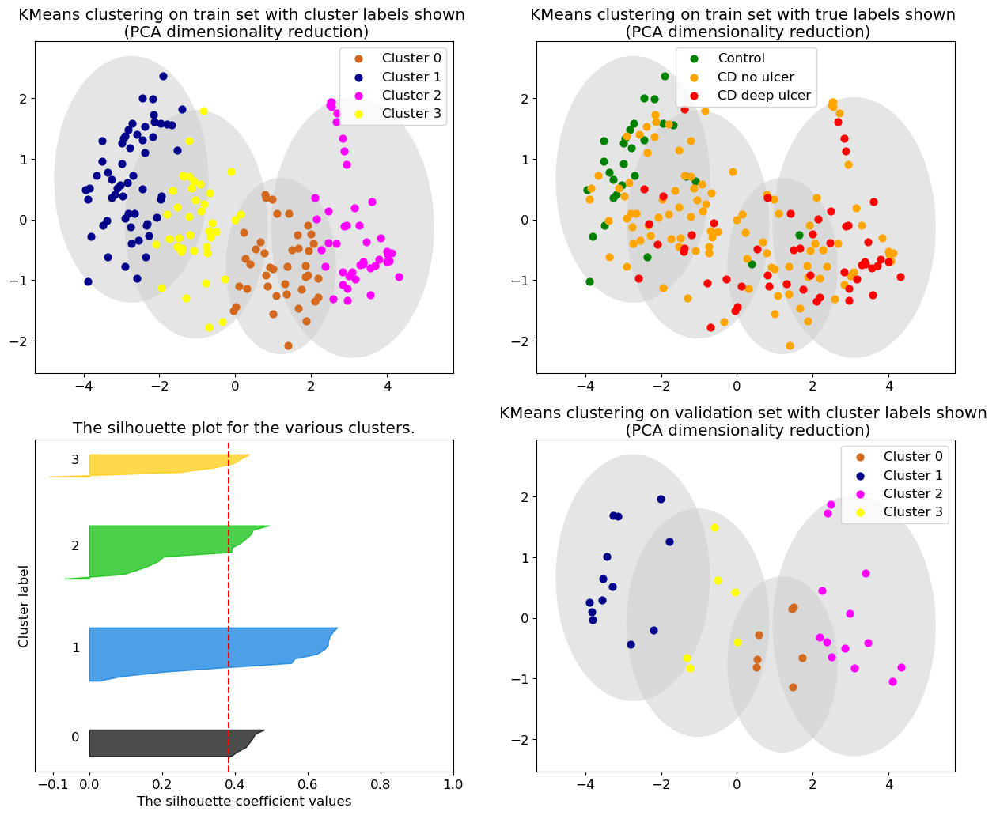

The average silhouette_score is : 0.38238192
Accuracy: 0.358974358974359
F1 score: 0.3979487179487179


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 140


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


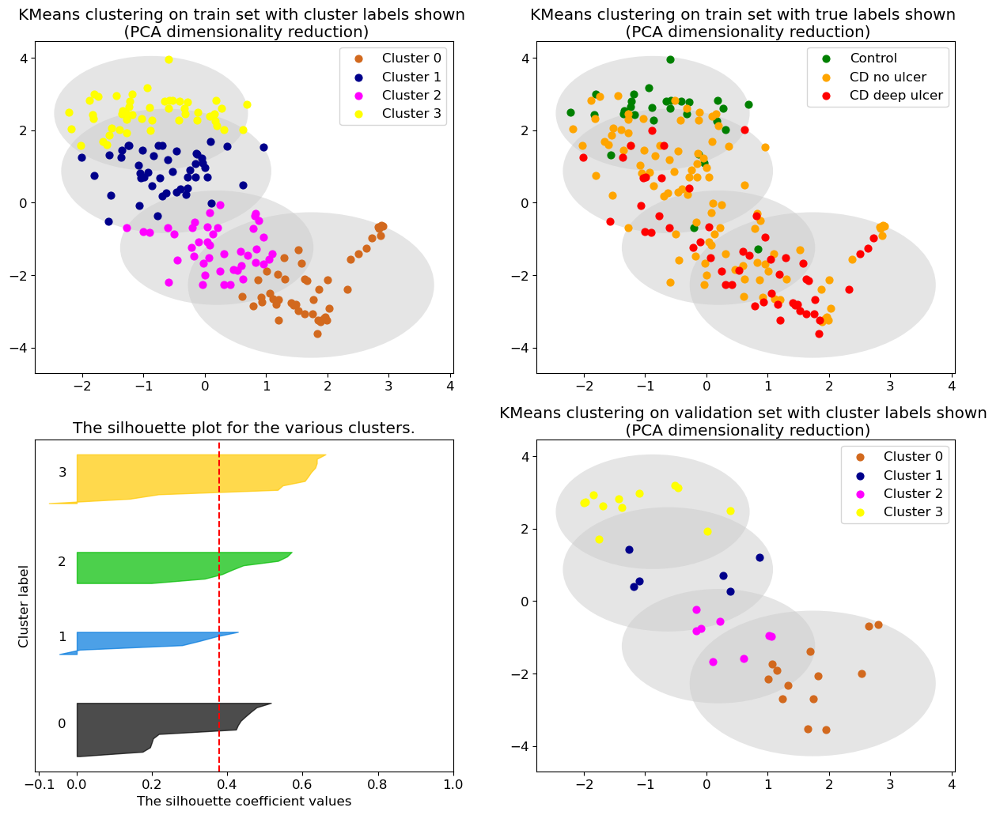

The average silhouette_score is : 0.37901047
Accuracy: 0.20512820512820512
F1 score: 0.2937728937728938


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 150


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


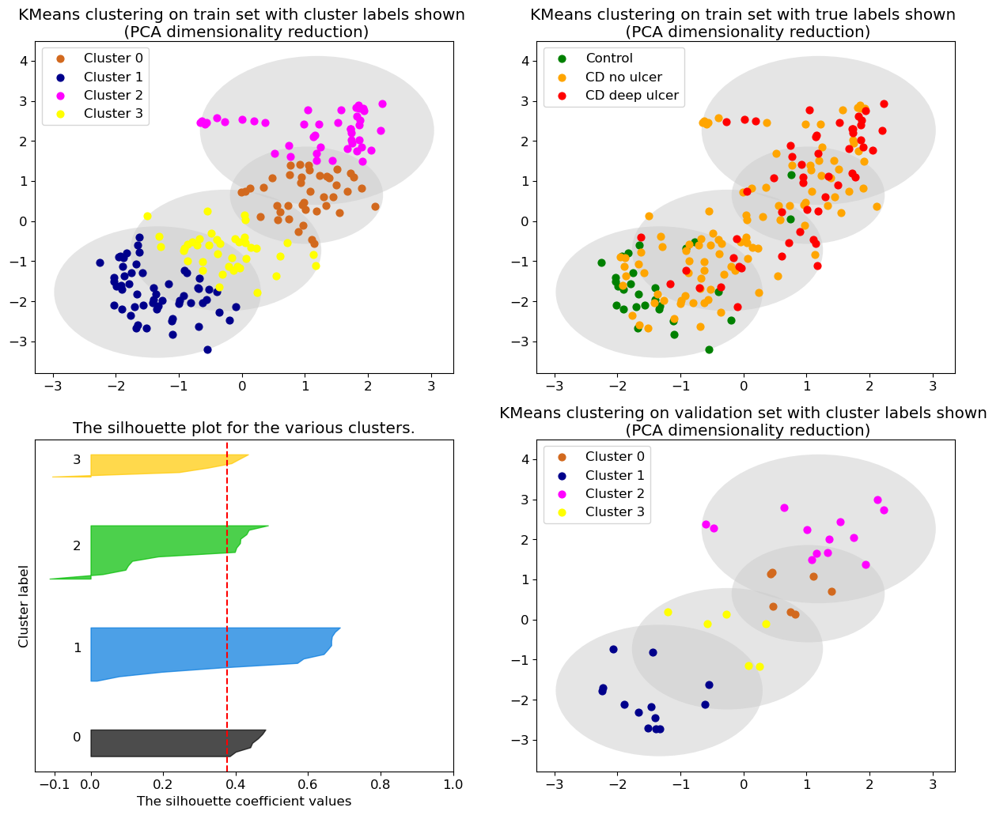

The average silhouette_score is : 0.37556845
Accuracy: 0.358974358974359
F1 score: 0.3979487179487179


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


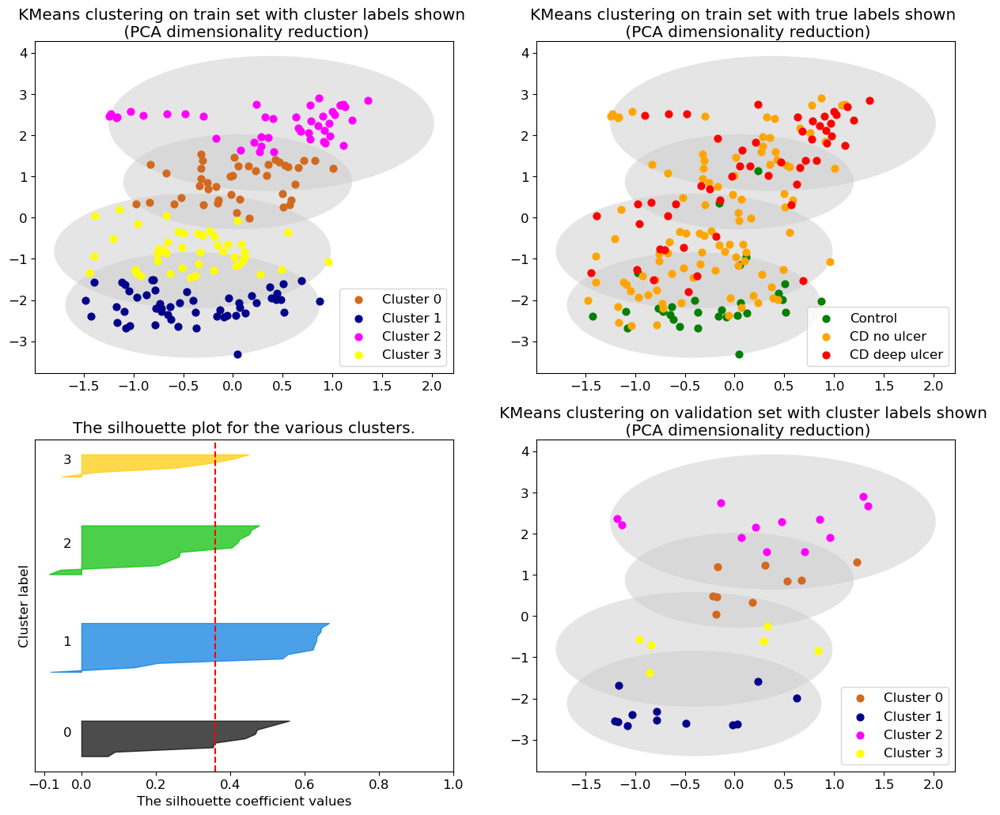

The average silhouette_score is : 0.36037743
Accuracy: 0.3333333333333333
F1 score: 0.37858220211161386


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 170


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


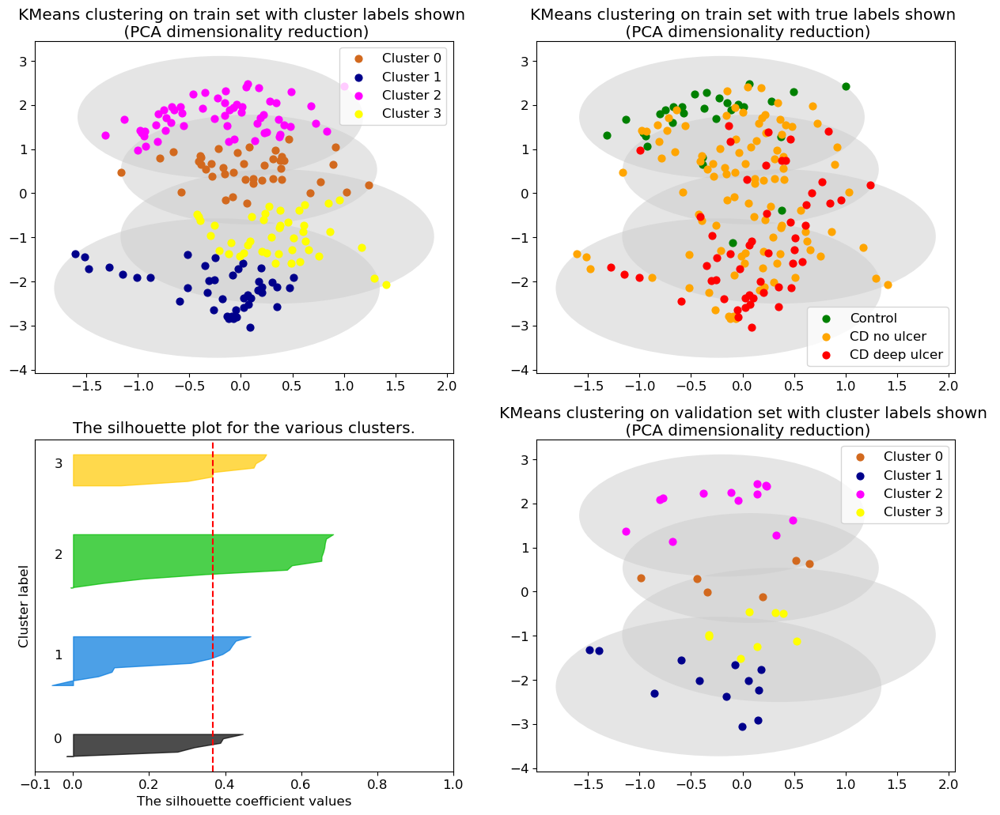

The average silhouette_score is : 0.3669735
Accuracy: 0.1794871794871795
F1 score: 0.22371040723981897


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 180


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


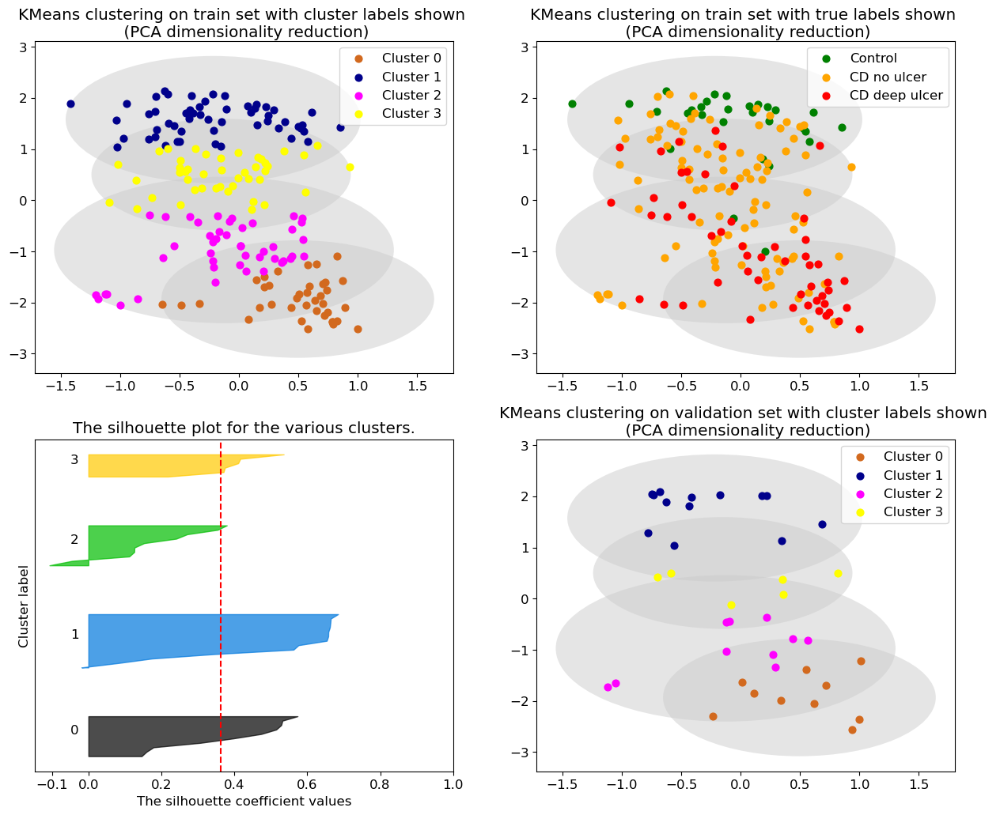

The average silhouette_score is : 0.36181813
Accuracy: 0.3076923076923077
F1 score: 0.36550116550116546


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 190


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


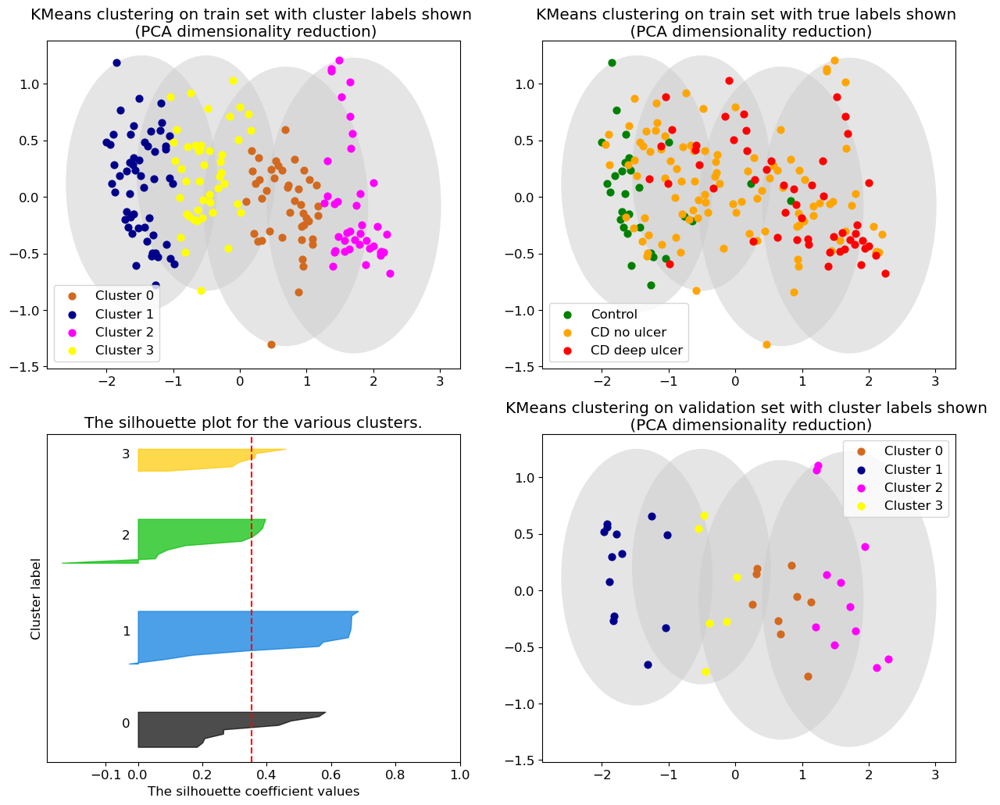

The average silhouette_score is : 0.35204268
Accuracy: 0.3333333333333333
F1 score: 0.3861761426978818


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


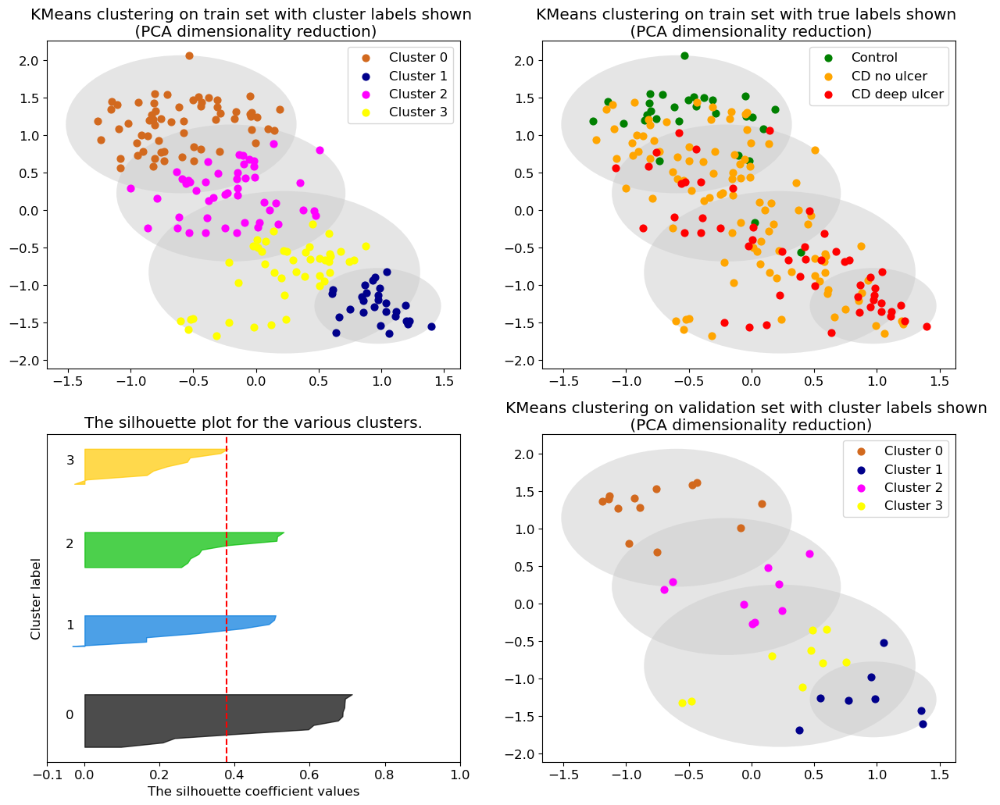

The average silhouette_score is : 0.3780287
Accuracy: 0.3333333333333333
F1 score: 0.3471713471713472


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 210


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


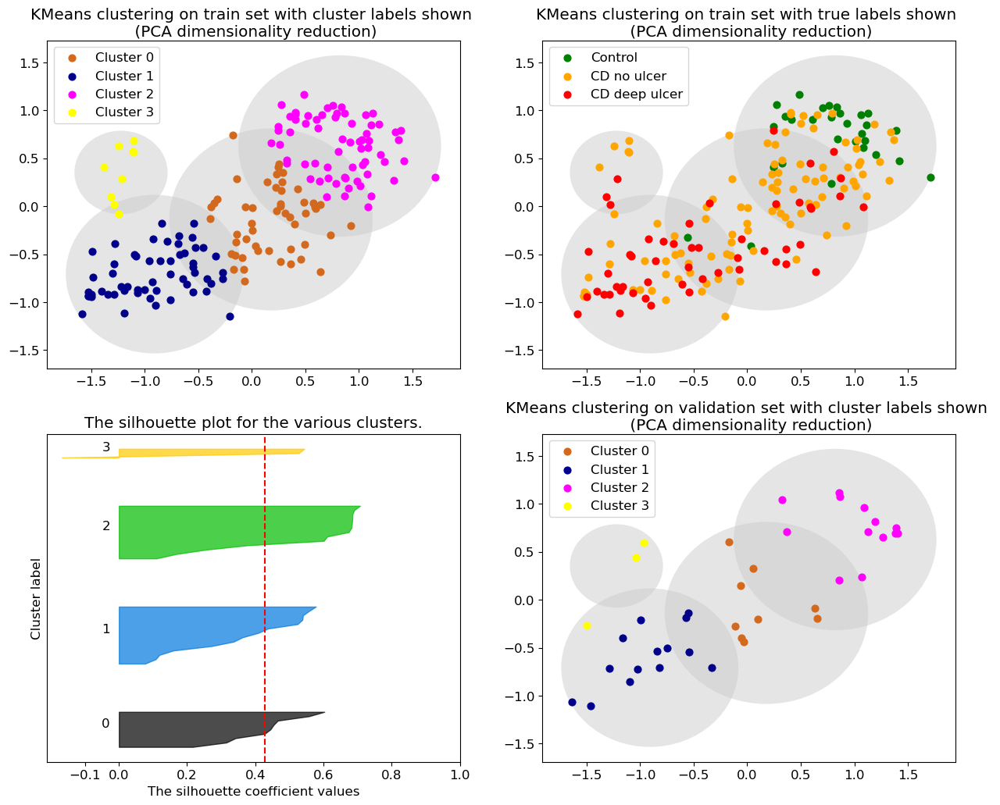

The average silhouette_score is : 0.4275927
Accuracy: 0.20512820512820512
F1 score: 0.24398860398860395


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 220


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


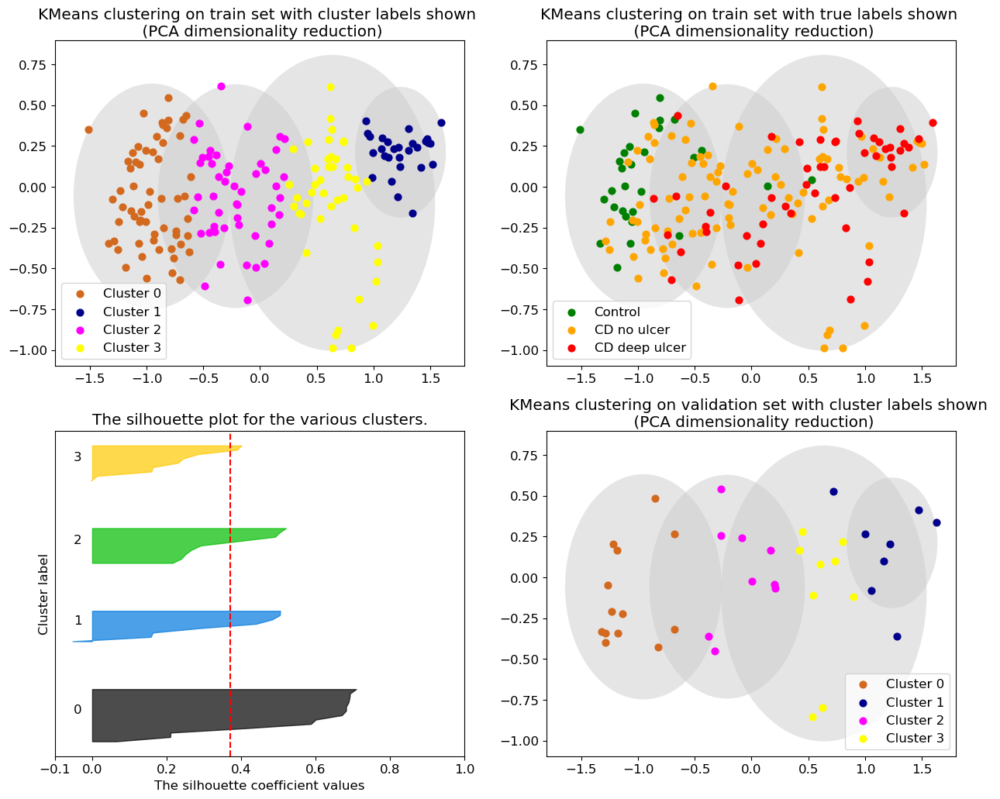

The average silhouette_score is : 0.37026608
Accuracy: 0.3333333333333333
F1 score: 0.3471713471713472


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 230


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


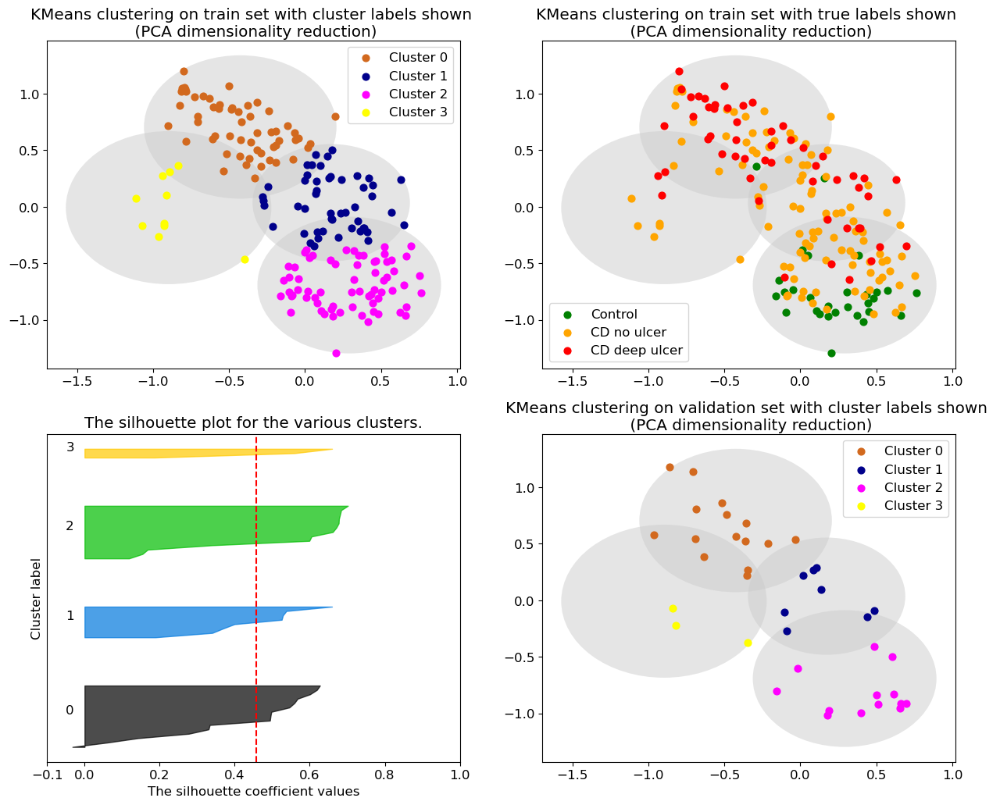

The average silhouette_score is : 0.456679
Accuracy: 0.15384615384615385
F1 score: 0.21264957264957265


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 240


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


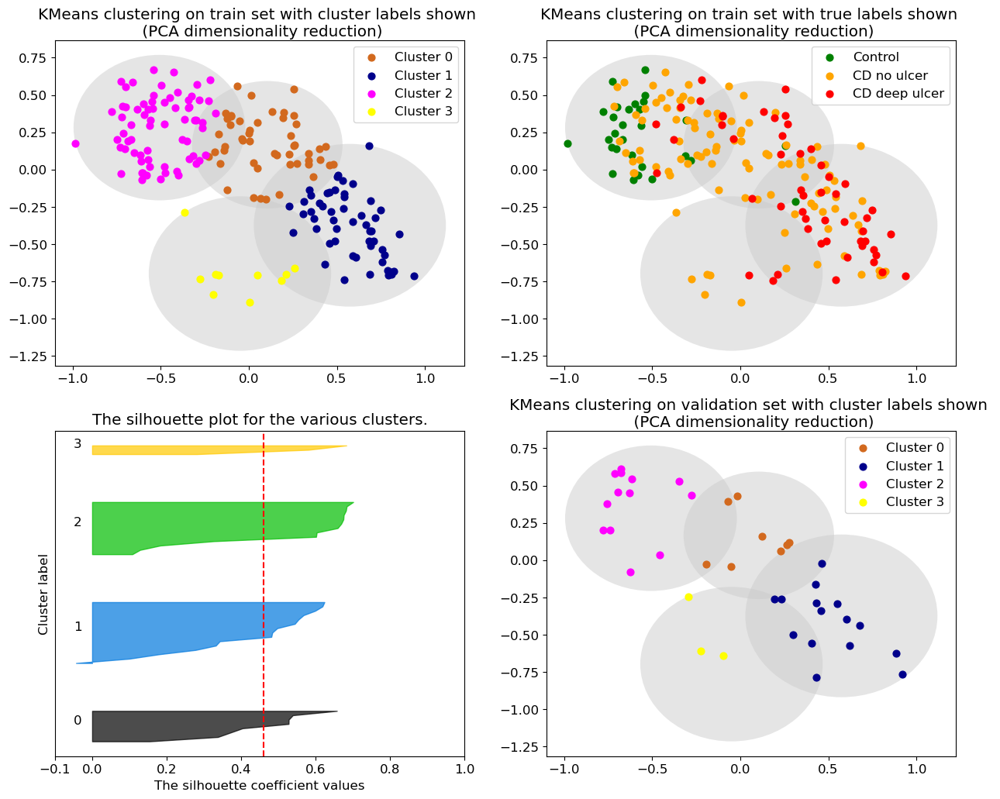

The average silhouette_score is : 0.4593228
Accuracy: 0.23076923076923078
F1 score: 0.26855162855162856


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 250


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


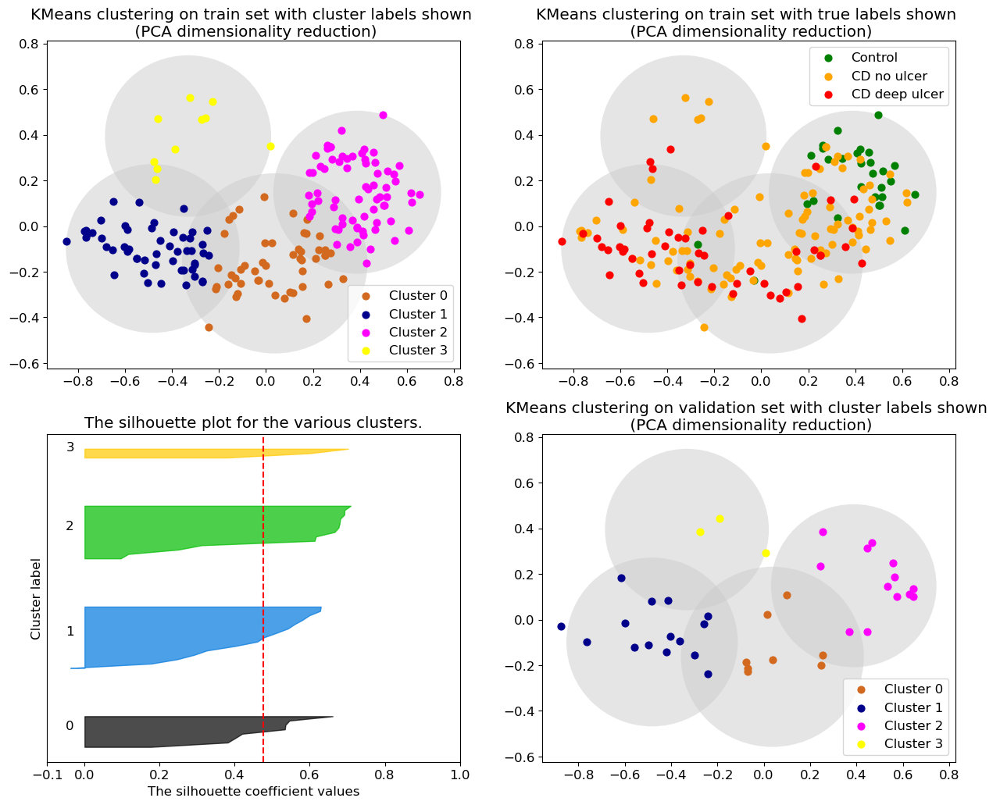

The average silhouette_score is : 0.47527534
Accuracy: 0.23076923076923078
F1 score: 0.26855162855162856


In [172]:
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

for perplexity in perplexities:
    kmeans_pca, X_train_pca, X_val_pca, X_test_pca, k_labels_train_pca, k_labels_val_pca, k_labels_test_pca, centers_pca, radii_pca = train_kmeans(full_pca_dataset, perplexity)
    print("Perplexity =",perplexity)
#     print(k_labels_train_pca)
    sil, acc, f1 = plot_kmeans(X_train_pca, X_val_pca, train_disease_labels, val_disease_labels, k_labels_train_pca, k_labels_val_pca, centers_pca, radii_pca, "PCA", test_set=False, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)

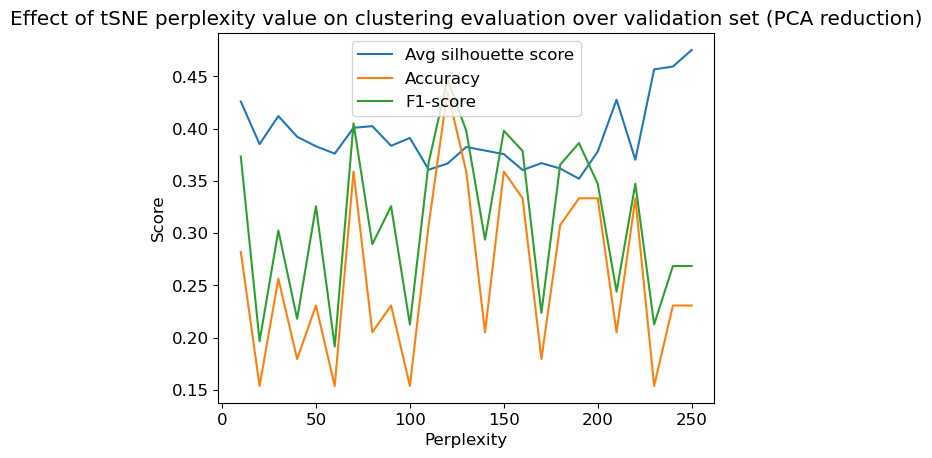

In [173]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "PCA")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


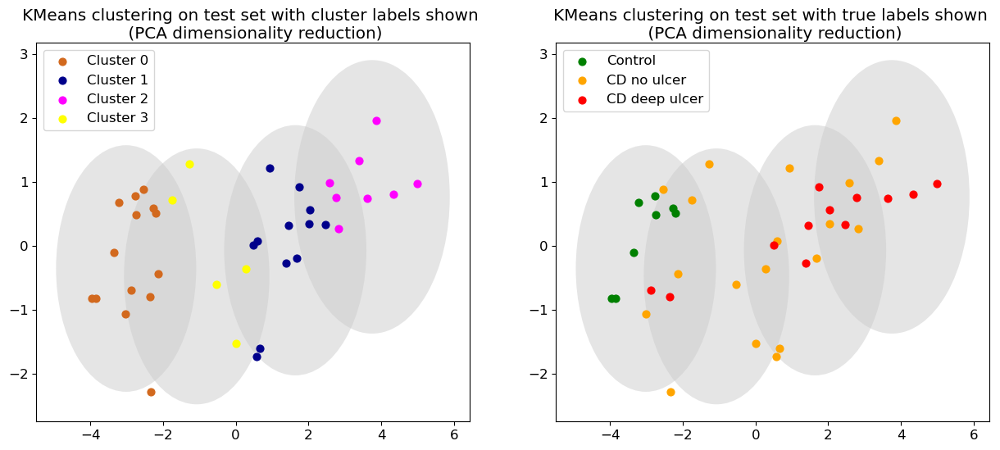

In [174]:
# plot with chosen tsne perplexity
perplexity = 120
kmeans_pca, X_train_pca, X_val_pca, X_test_pca, k_labels_train_pca, k_labels_val_pca, k_labels_test_pca, centers_pca, radii_pca = train_kmeans(full_pca_dataset, perplexity)
print("Perplexity =",perplexity)
plot_kmeans(X_test_pca, None, test_disease_labels, None, k_labels_test_pca, None, centers_pca, radii_pca, "PCA", test_set=True)
        
# silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val_pca, k_labels_val_pca)
# acc = accuracy_score(val_disease_labels, k_labels_val_pca)
# f1 = f1_score(val_disease_labels, k_labels_val_pca, average='weighted')
# print("The average silhouette_score is :",silhouette_avg)
# print("Accuracy:",acc)
# print("F1 score:",f1)


### Fit KMeans (Autoencoder & tSNE dimensionality reduction)

### Training

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 10


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


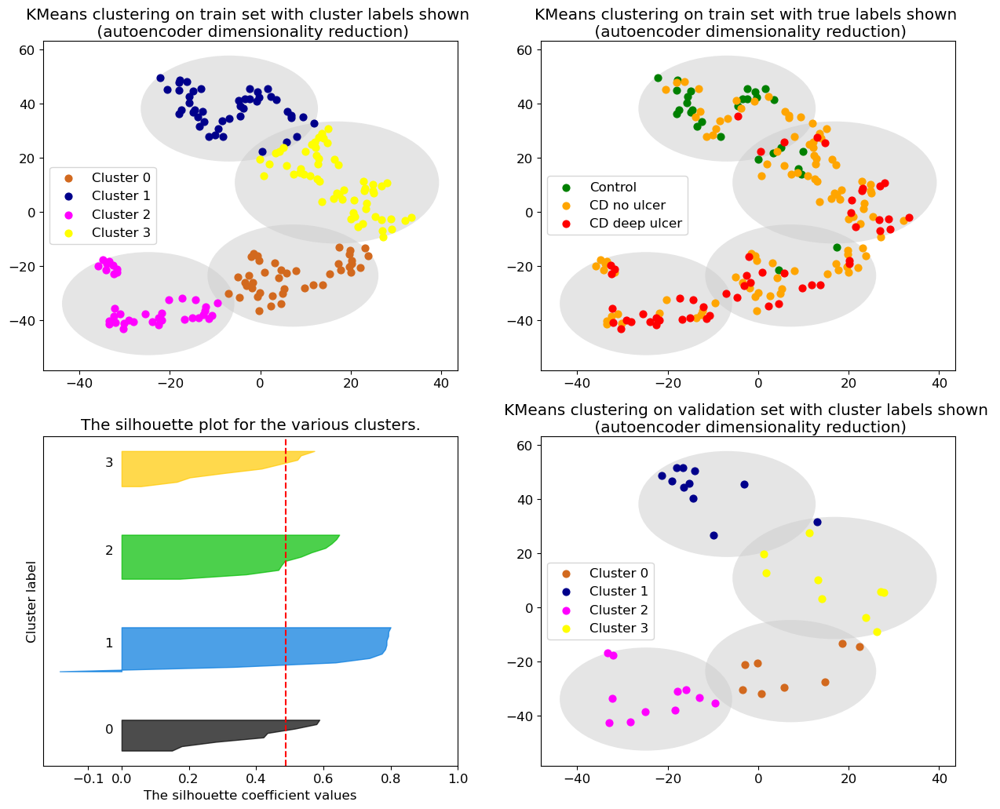

The average silhouette_score is : 0.48761153
Accuracy: 0.2564102564102564
F1 score: 0.30471943515421773


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 20


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


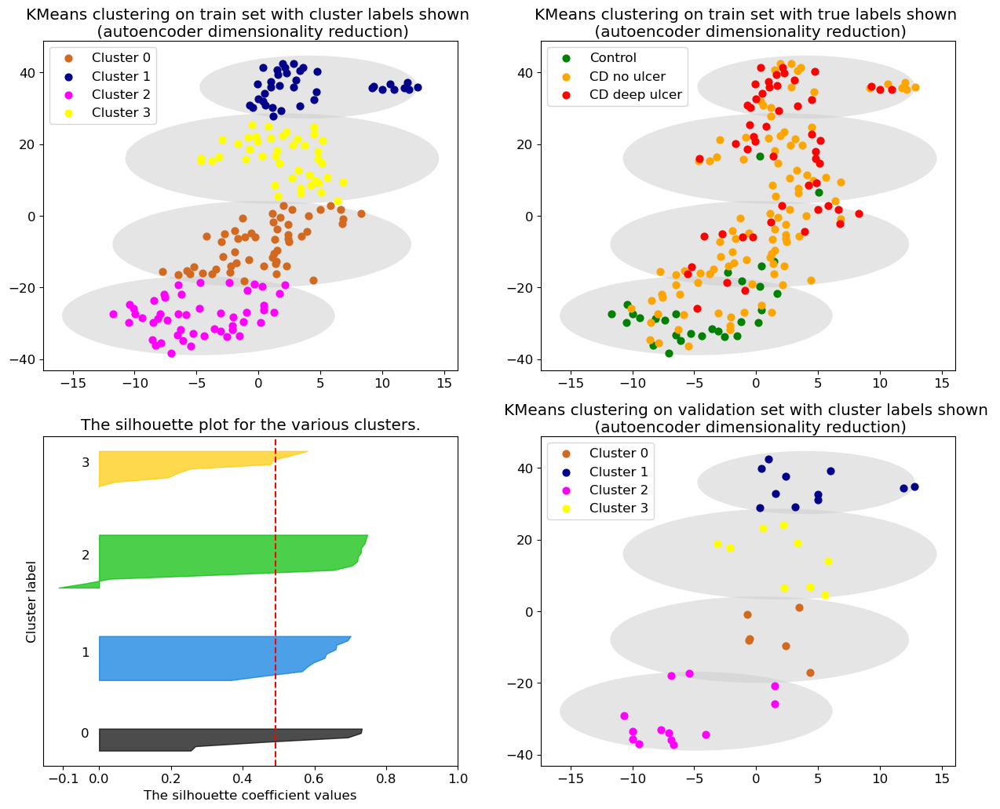

The average silhouette_score is : 0.4925267
Accuracy: 0.1794871794871795
F1 score: 0.22974358974358972


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 30


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


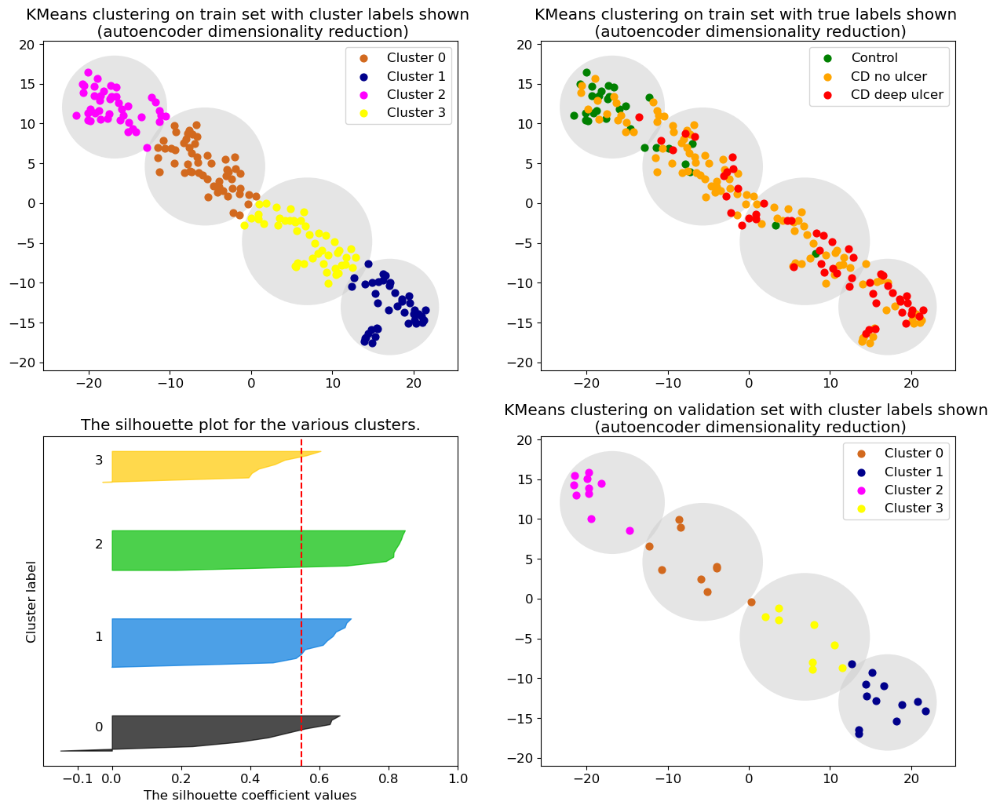

The average silhouette_score is : 0.546889
Accuracy: 0.1794871794871795
F1 score: 0.22706705059646234


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 40


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


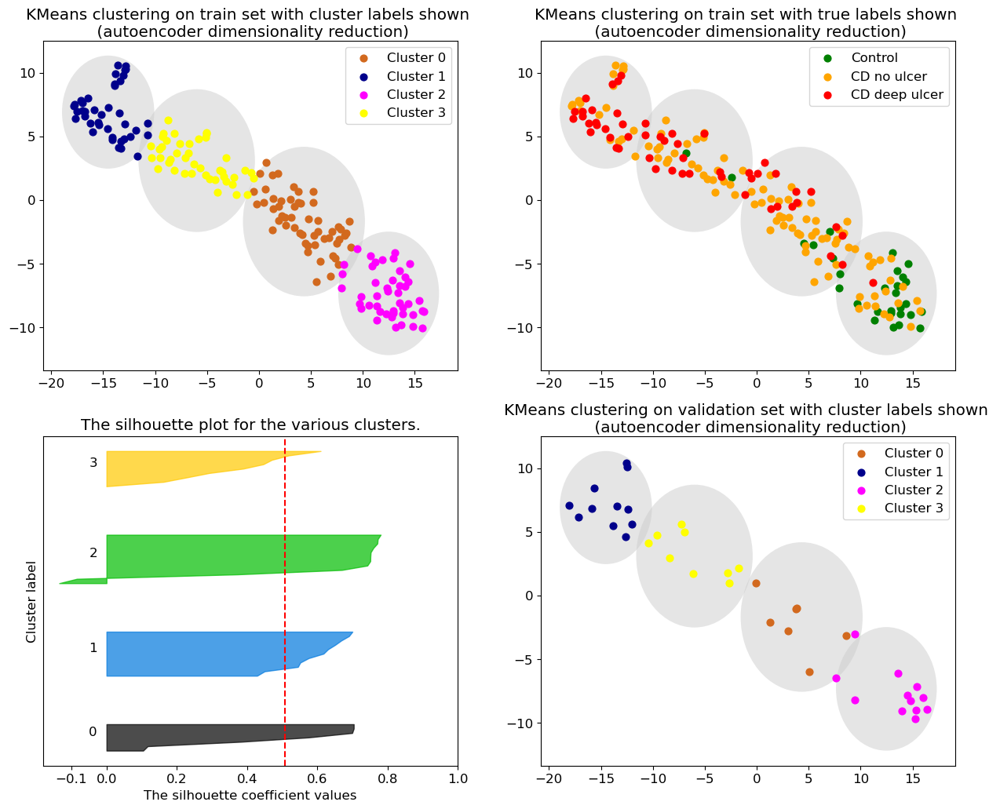

The average silhouette_score is : 0.50779593
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 50


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


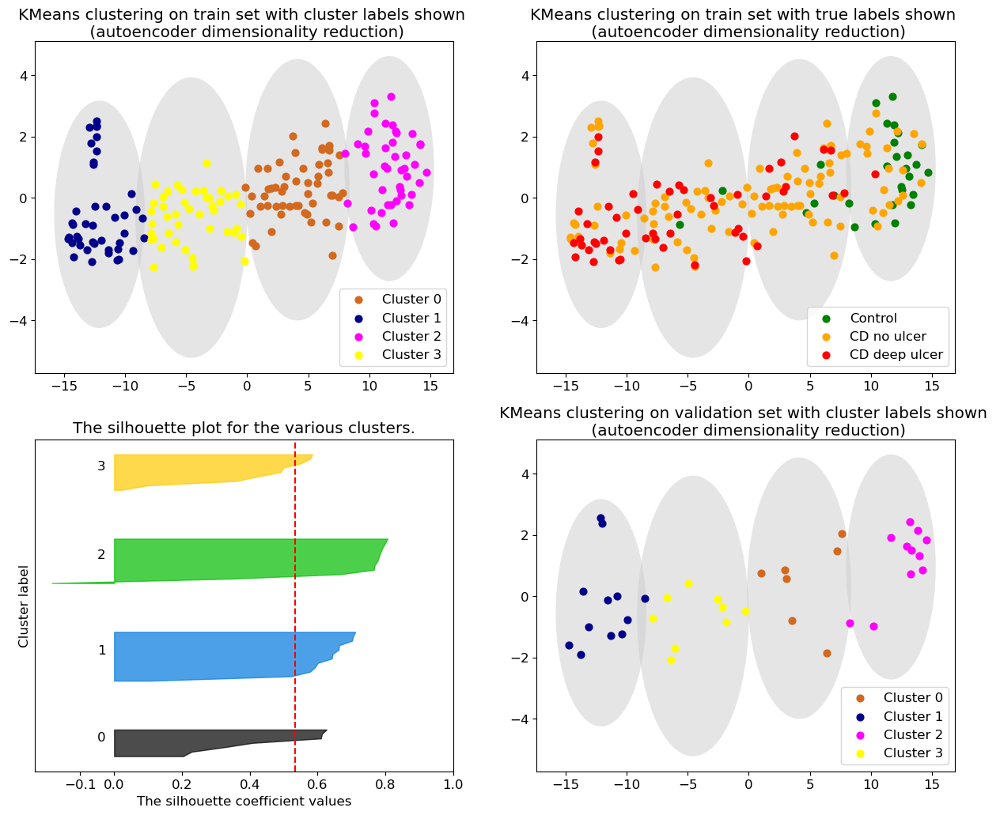

The average silhouette_score is : 0.5348744
Accuracy: 0.1794871794871795
F1 score: 0.22585087546724372


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 60


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


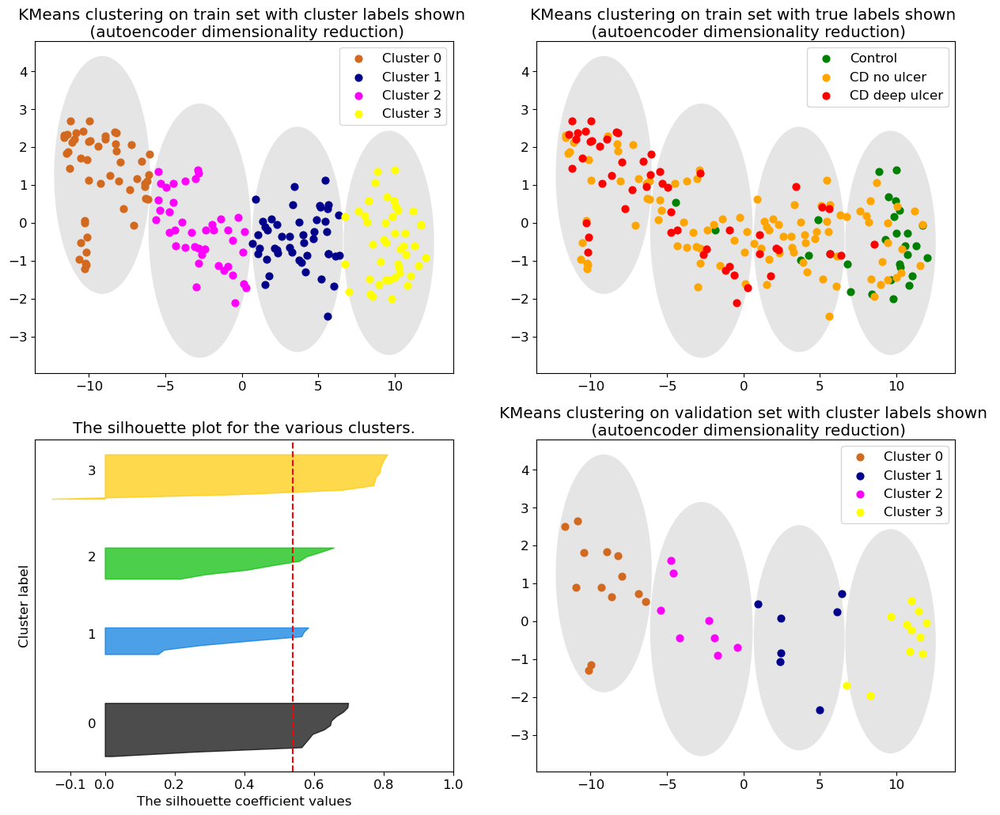

The average silhouette_score is : 0.5390002
Accuracy: 0.23076923076923078
F1 score: 0.3257294429708223


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 70


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


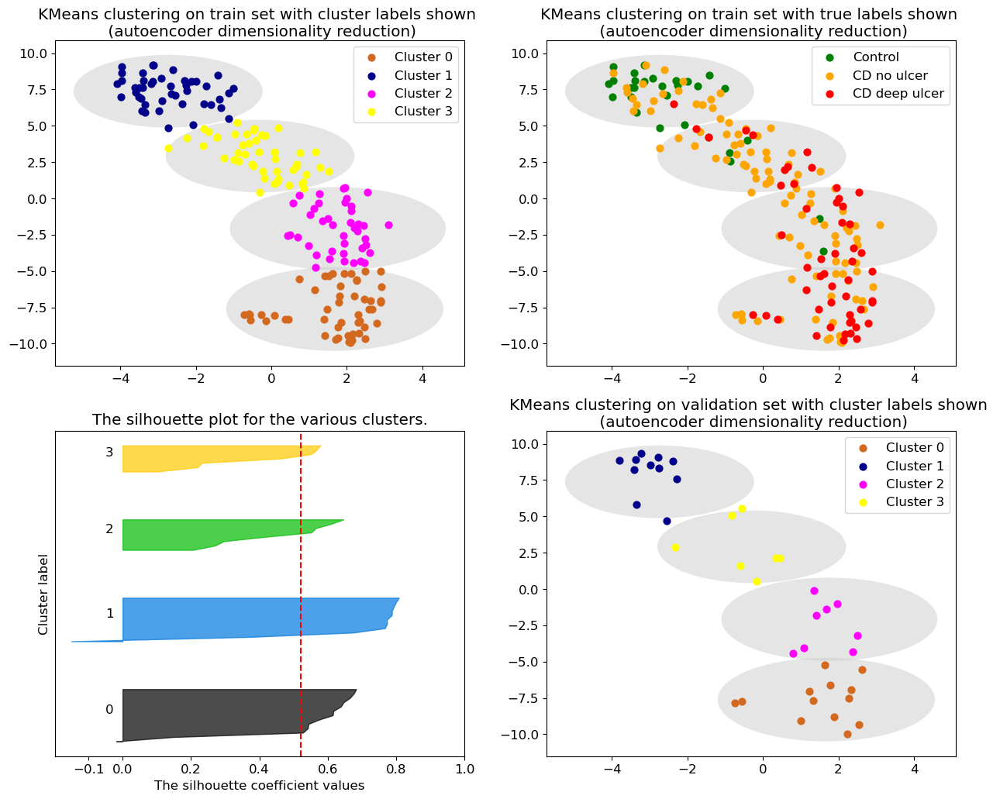

The average silhouette_score is : 0.5211104
Accuracy: 0.20512820512820512
F1 score: 0.2632478632478632


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 80


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


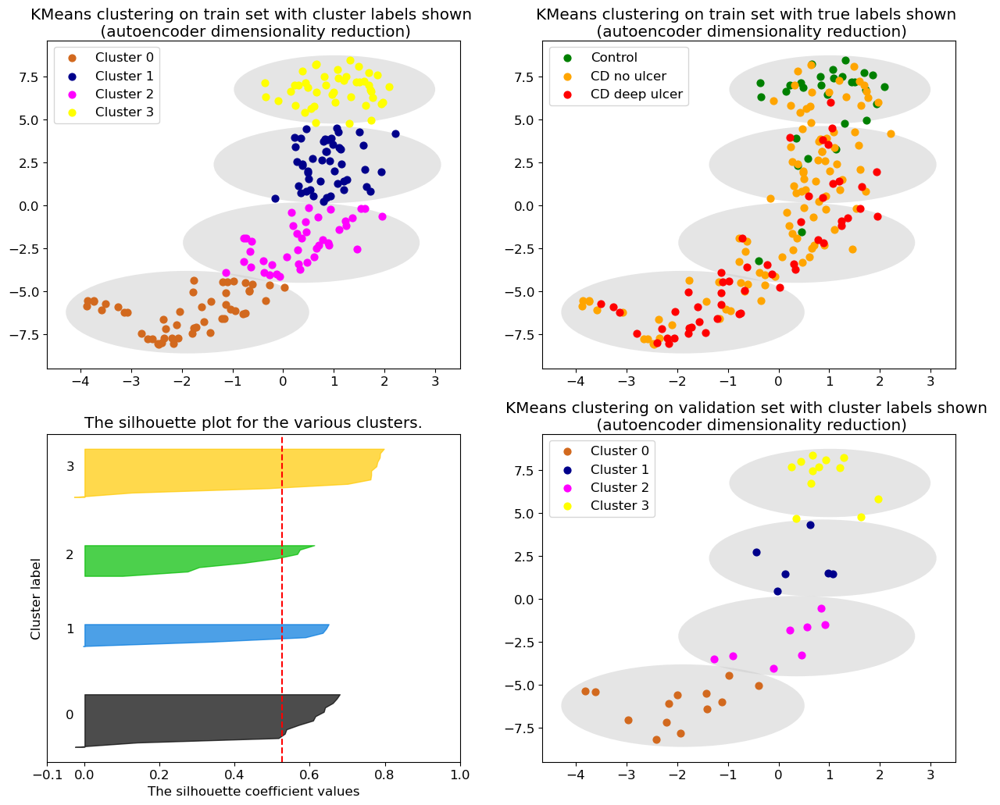

The average silhouette_score is : 0.52606815
Accuracy: 0.20512820512820512
F1 score: 0.2937728937728938


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 90


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


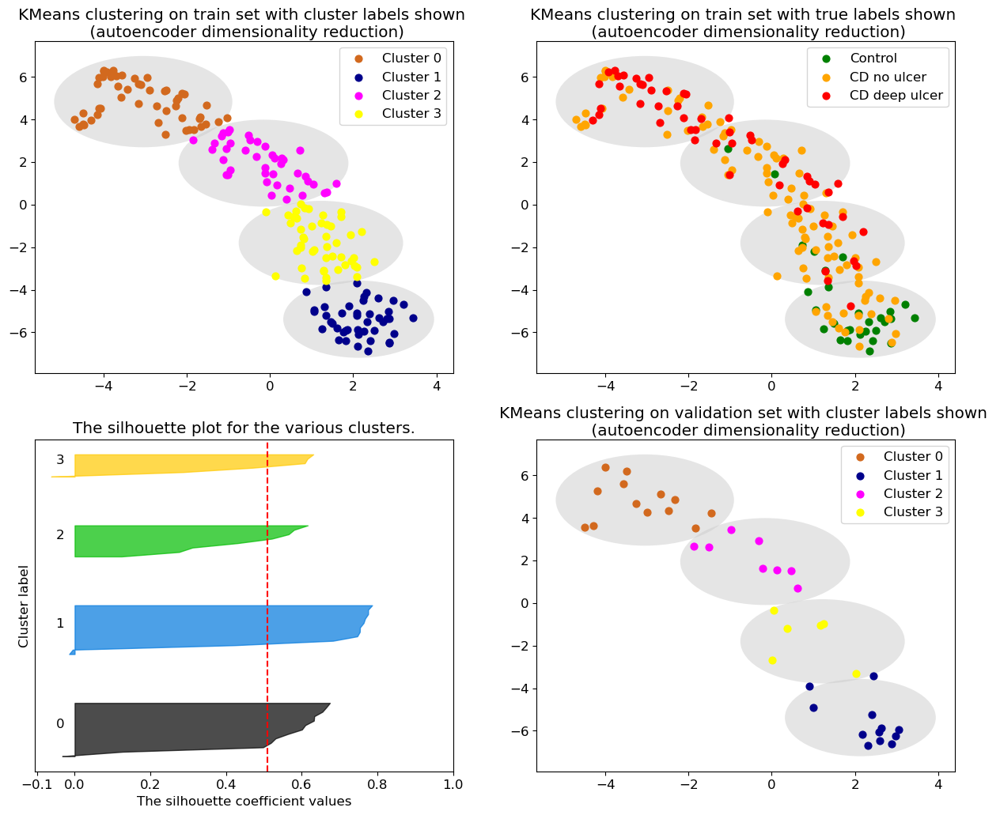

The average silhouette_score is : 0.5089671
Accuracy: 0.23076923076923078
F1 score: 0.29140271493212666


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 100


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


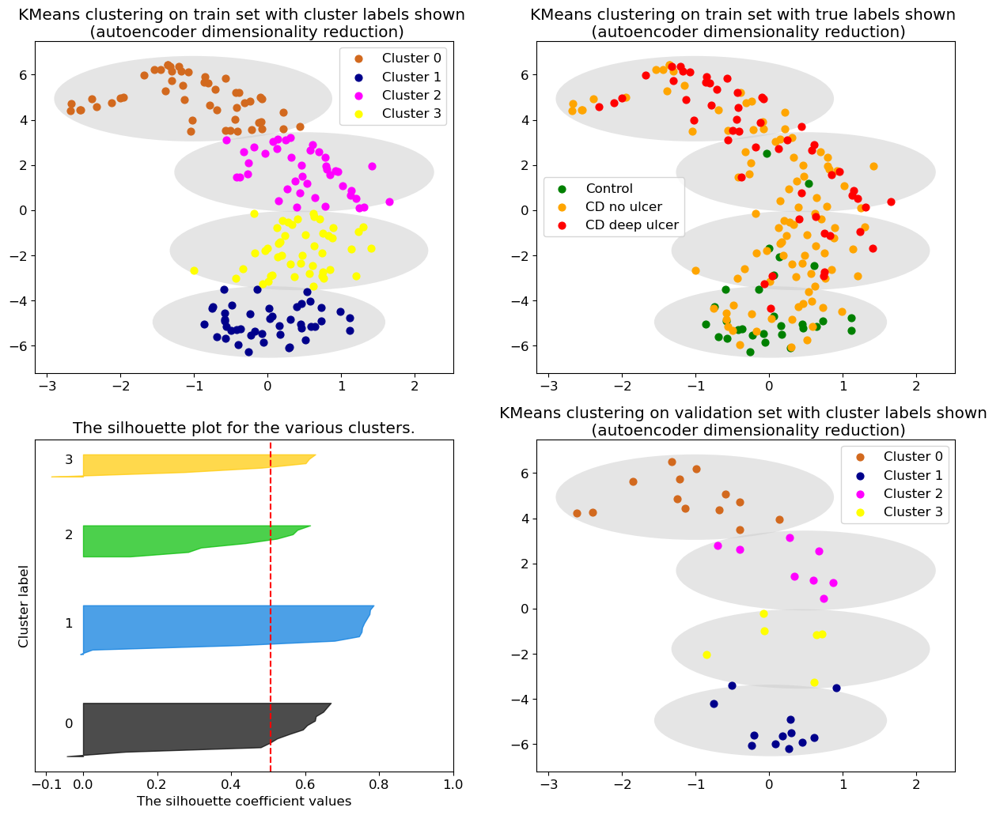

The average silhouette_score is : 0.50668824
Accuracy: 0.23076923076923078
F1 score: 0.29140271493212666


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 110


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


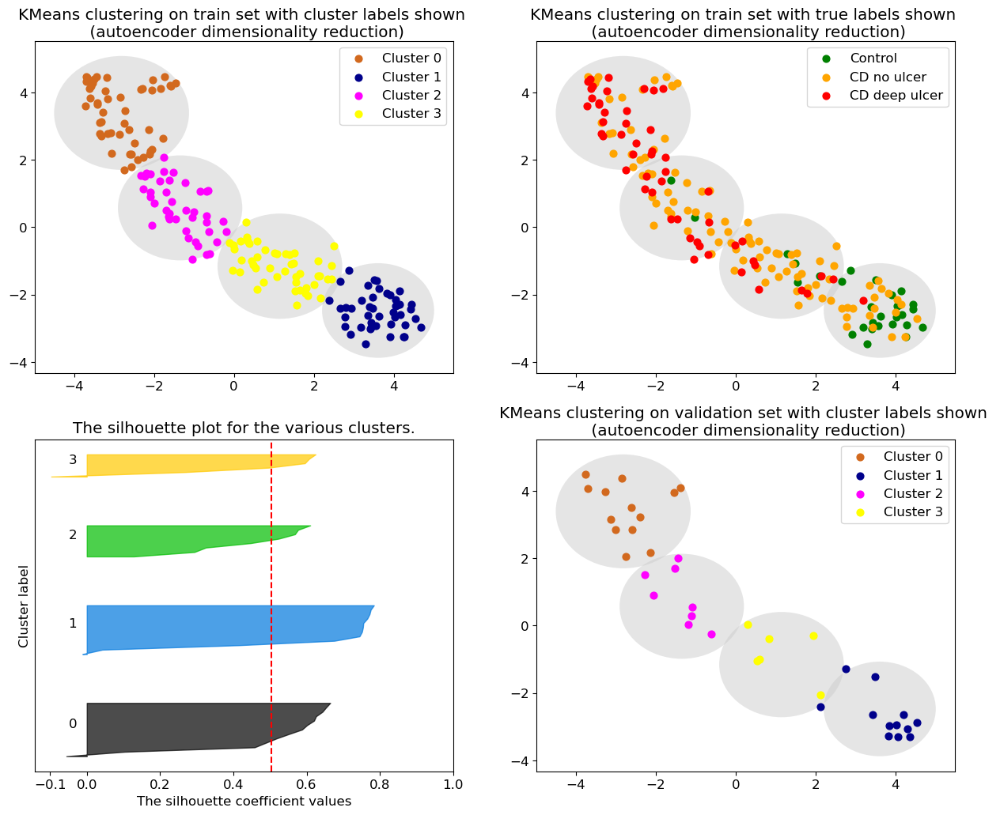

The average silhouette_score is : 0.5036694
Accuracy: 0.23076923076923078
F1 score: 0.29140271493212666


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 120


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


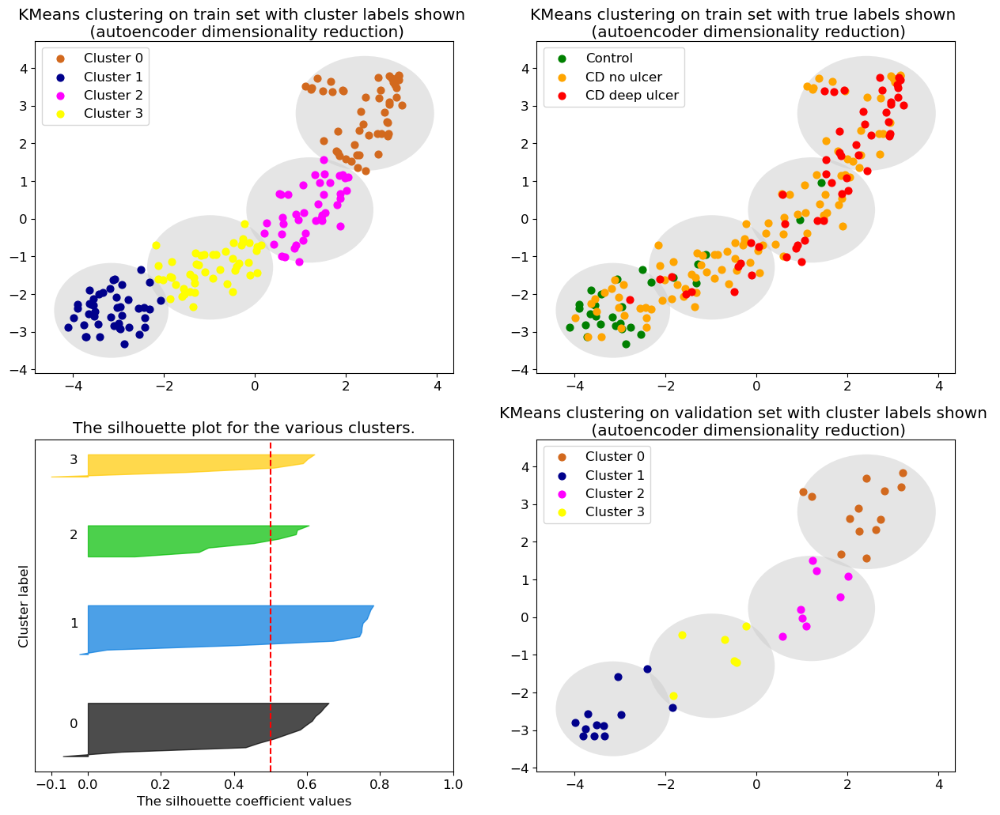

The average silhouette_score is : 0.4998059
Accuracy: 0.23076923076923078
F1 score: 0.29140271493212666


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 130


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


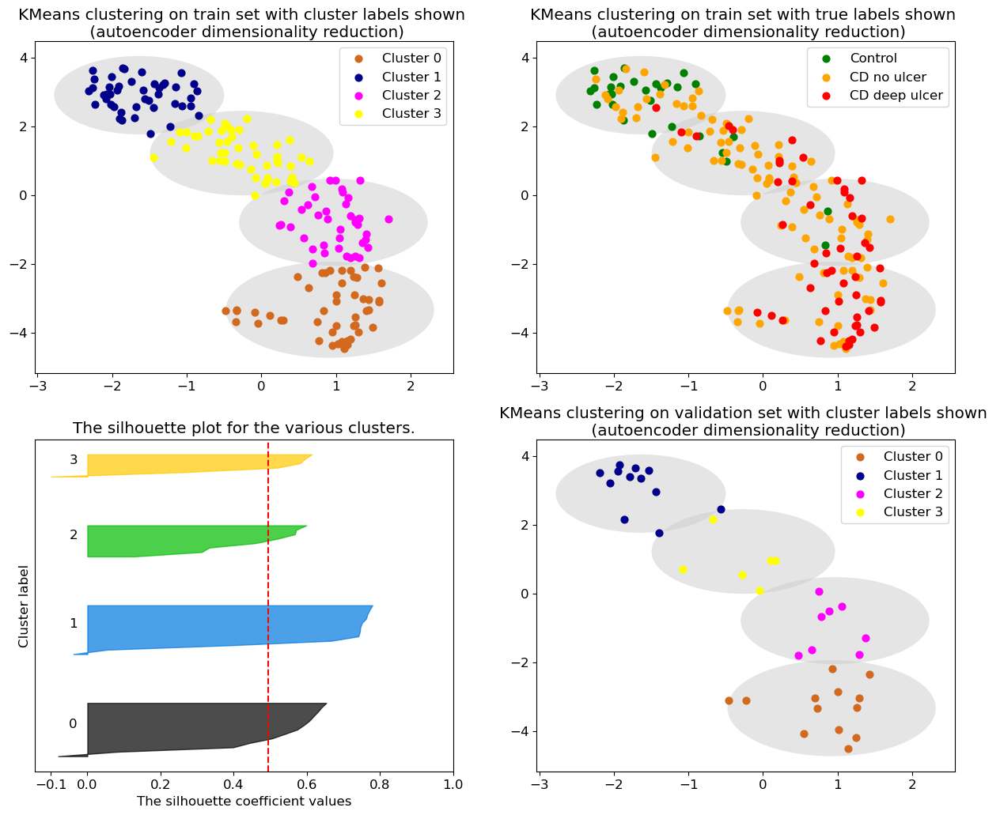

The average silhouette_score is : 0.49503183
Accuracy: 0.23076923076923078
F1 score: 0.29140271493212666


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 140


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


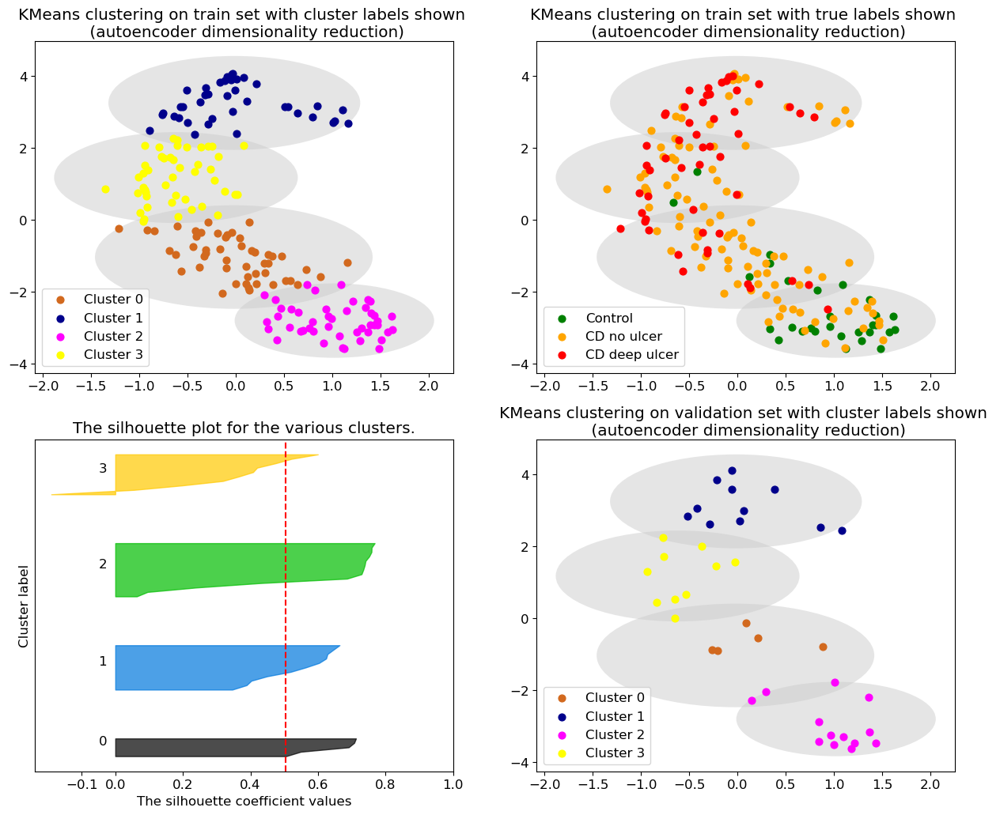

The average silhouette_score is : 0.50412375
Accuracy: 0.1794871794871795
F1 score: 0.22974358974358972


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 150


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


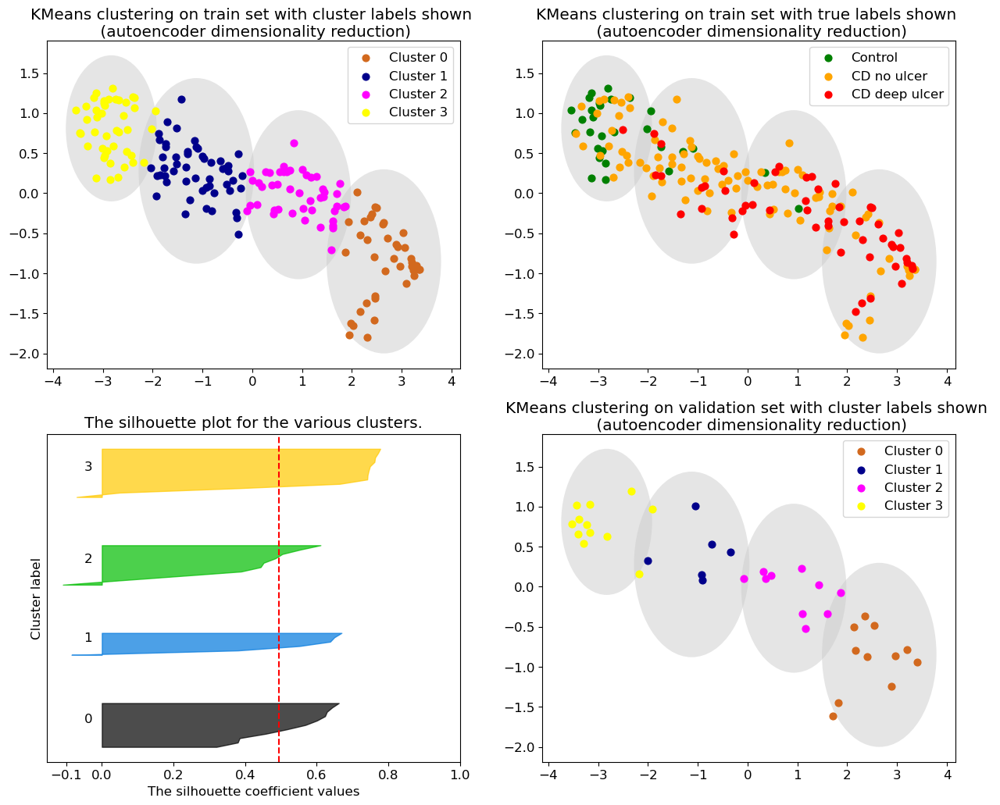

The average silhouette_score is : 0.49397308
Accuracy: 0.2564102564102564
F1 score: 0.3413253413253413


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 160


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


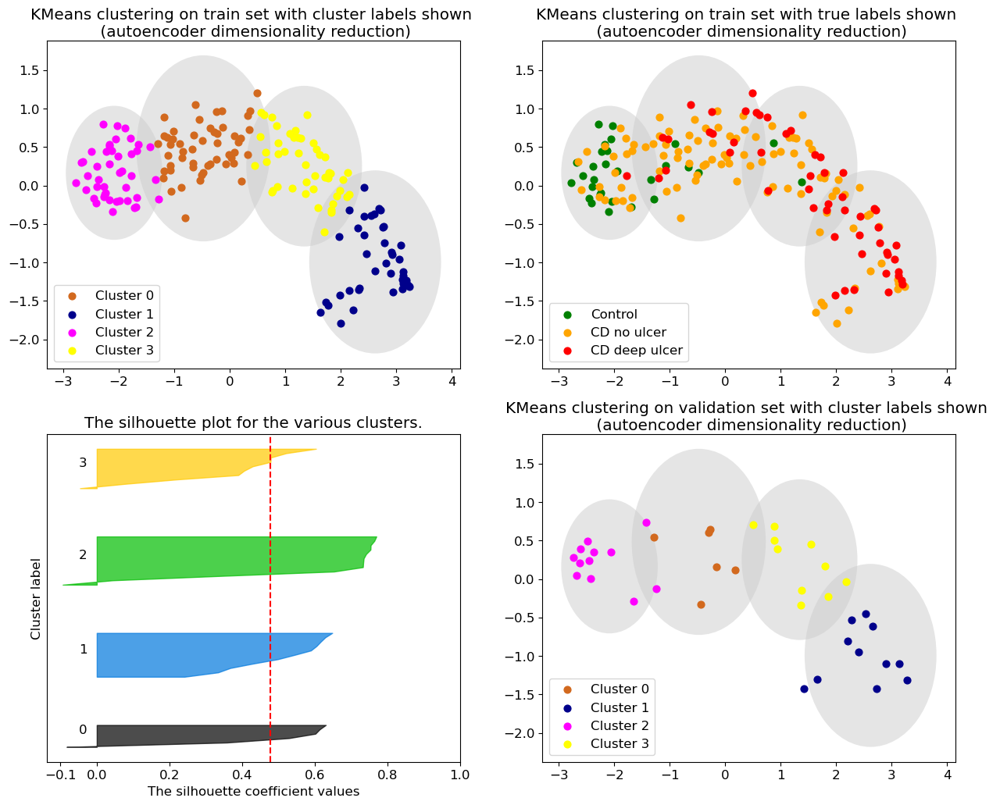

The average silhouette_score is : 0.47815794
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 170


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


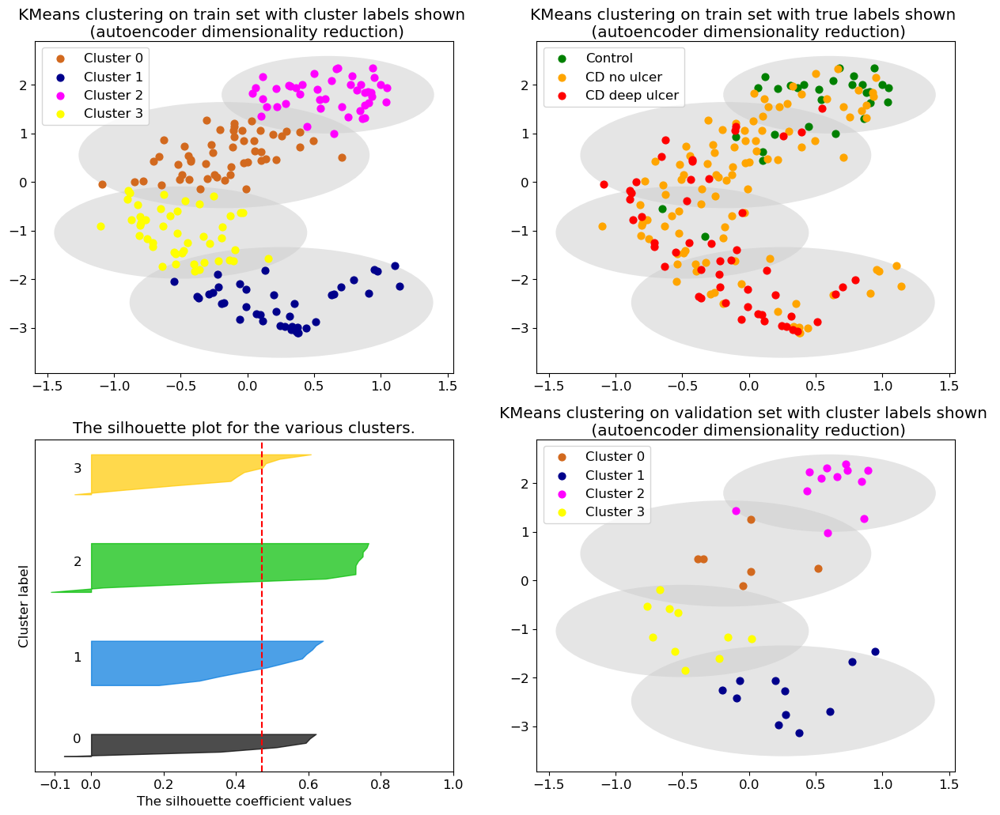

The average silhouette_score is : 0.4708094
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 180


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


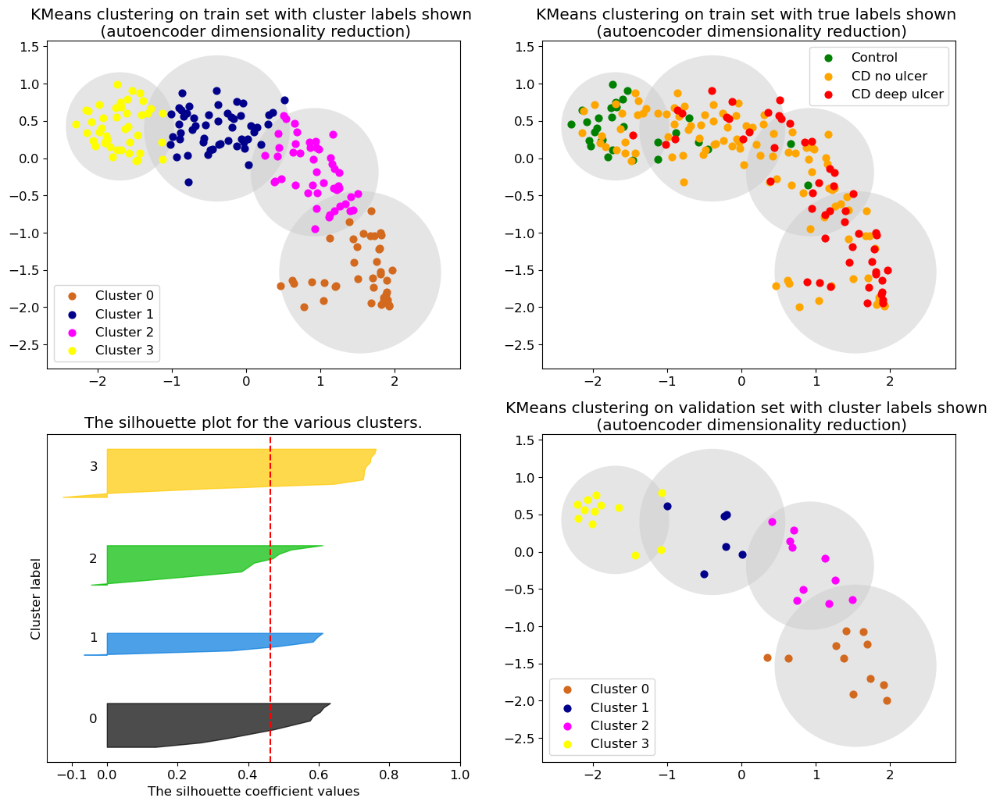

The average silhouette_score is : 0.46349496
Accuracy: 0.2564102564102564
F1 score: 0.3413253413253413


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 190


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


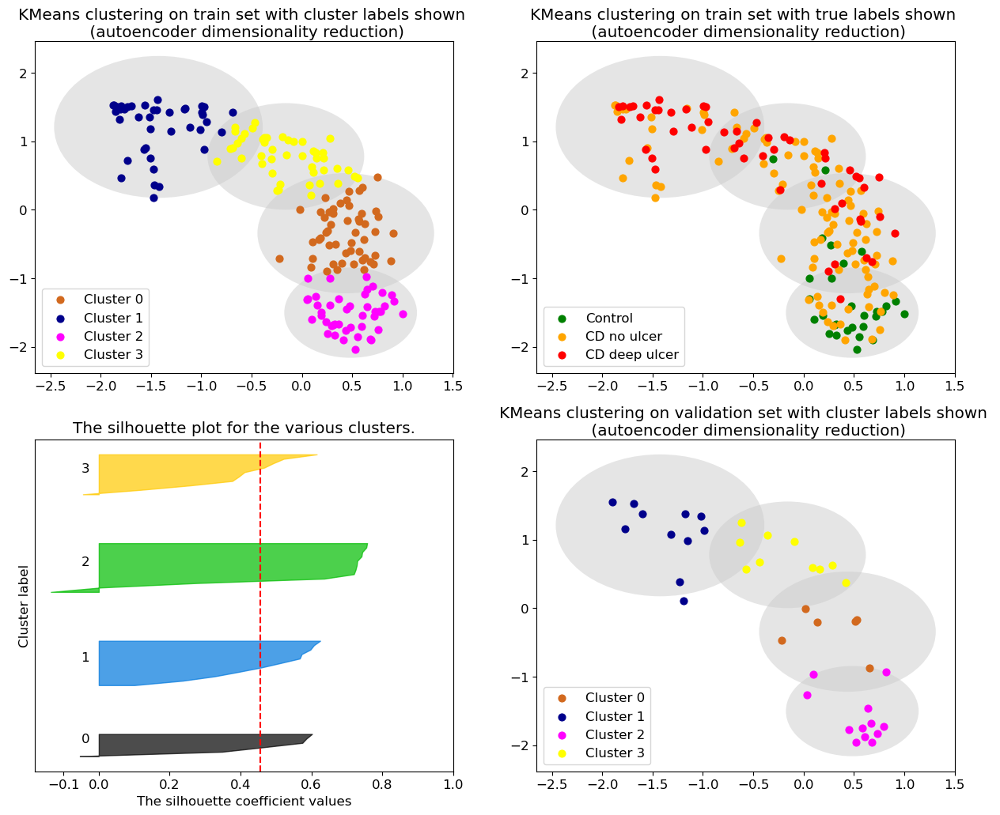

The average silhouette_score is : 0.45679206
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


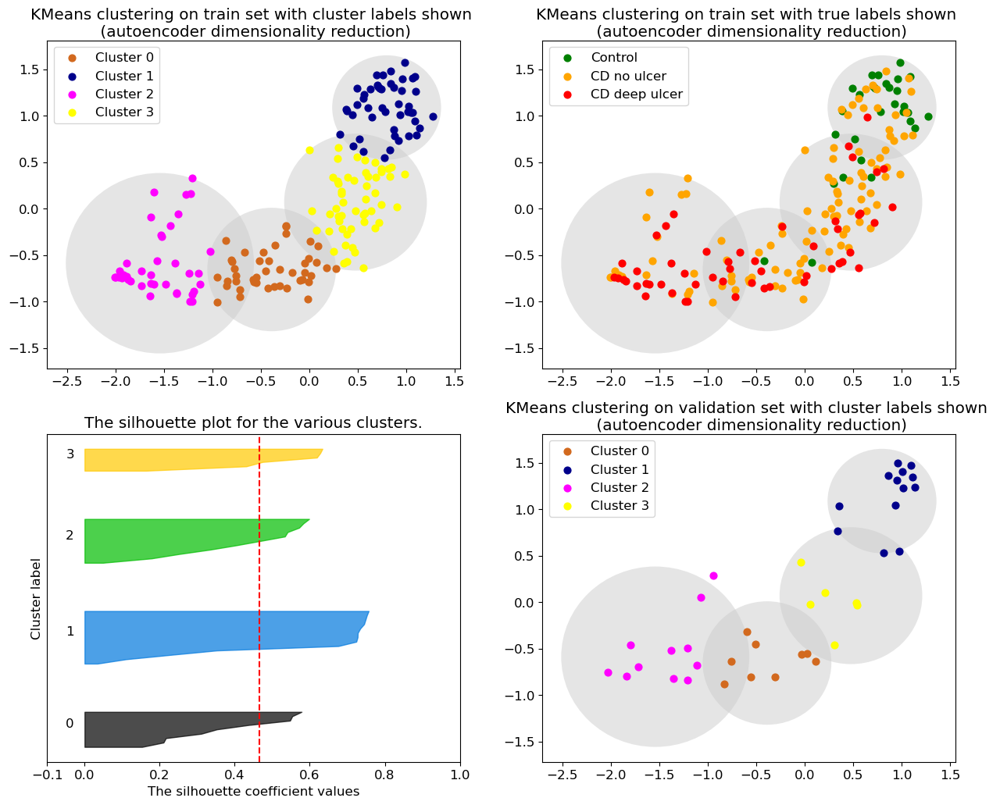

The average silhouette_score is : 0.46524024
Accuracy: 0.3076923076923077
F1 score: 0.35942028985507246


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 210


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


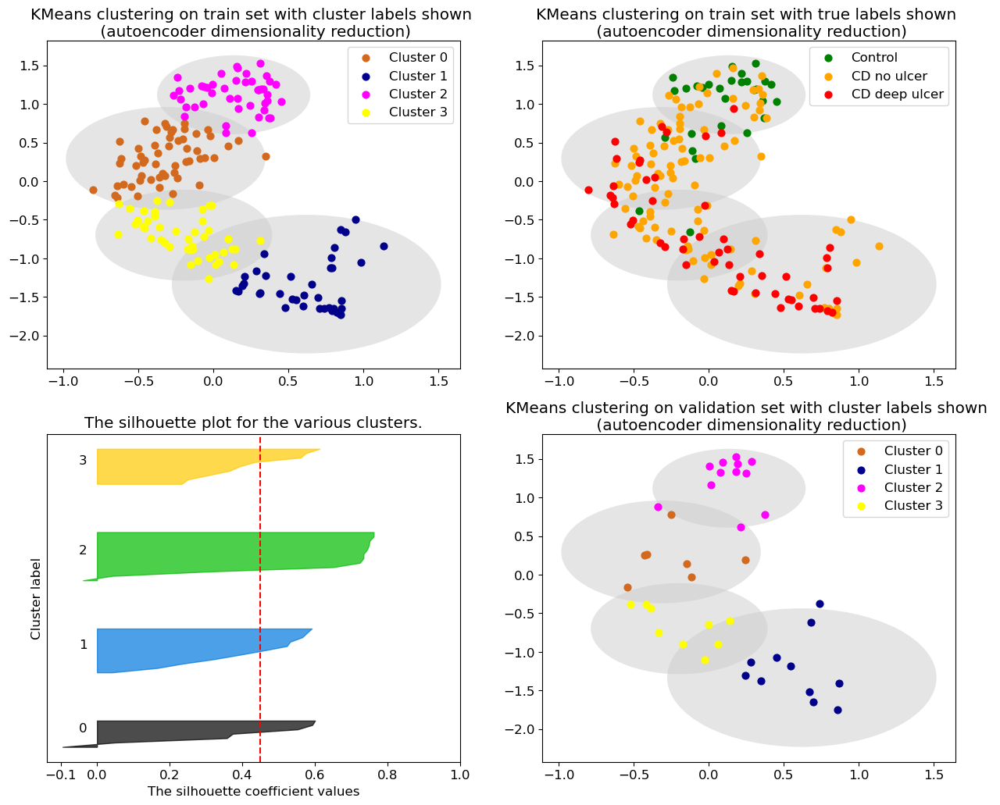

The average silhouette_score is : 0.4488124
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 220


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


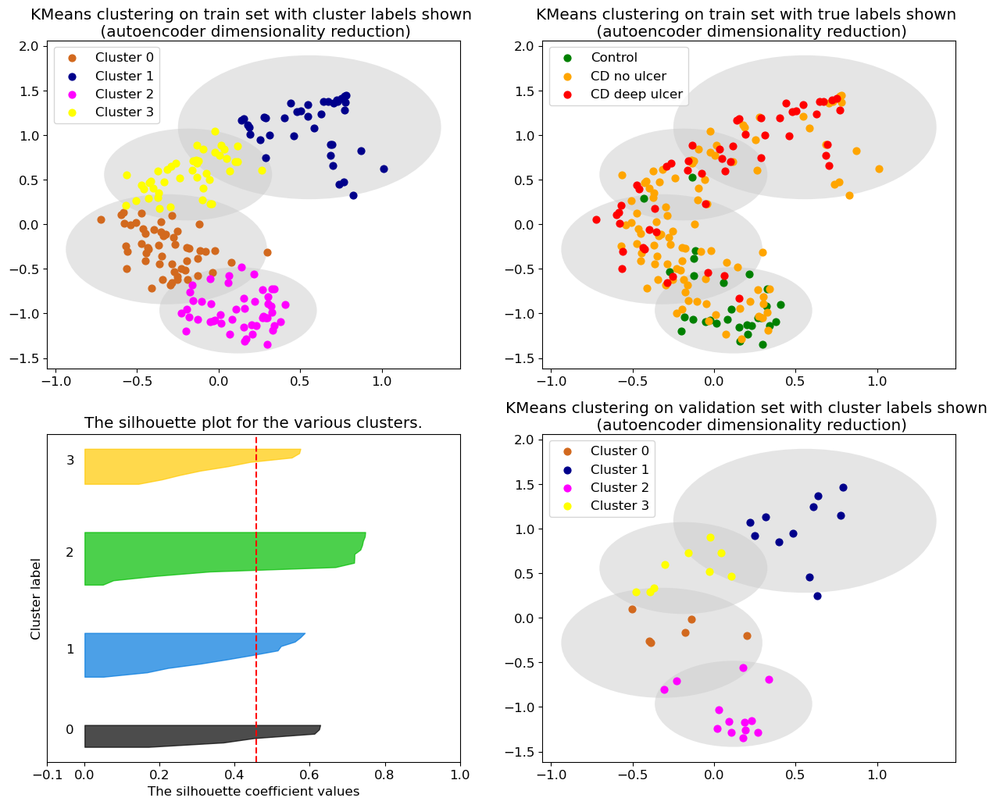

The average silhouette_score is : 0.45670378
Accuracy: 0.1794871794871795
F1 score: 0.22974358974358972


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 230


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


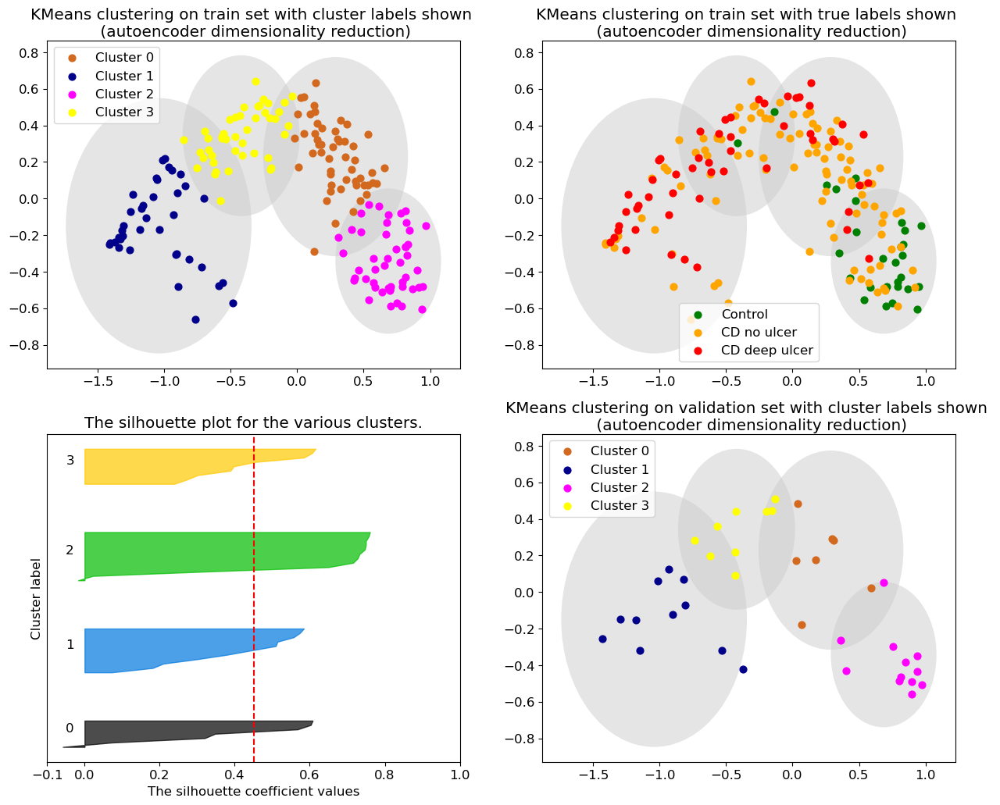

The average silhouette_score is : 0.45031554
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 240


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


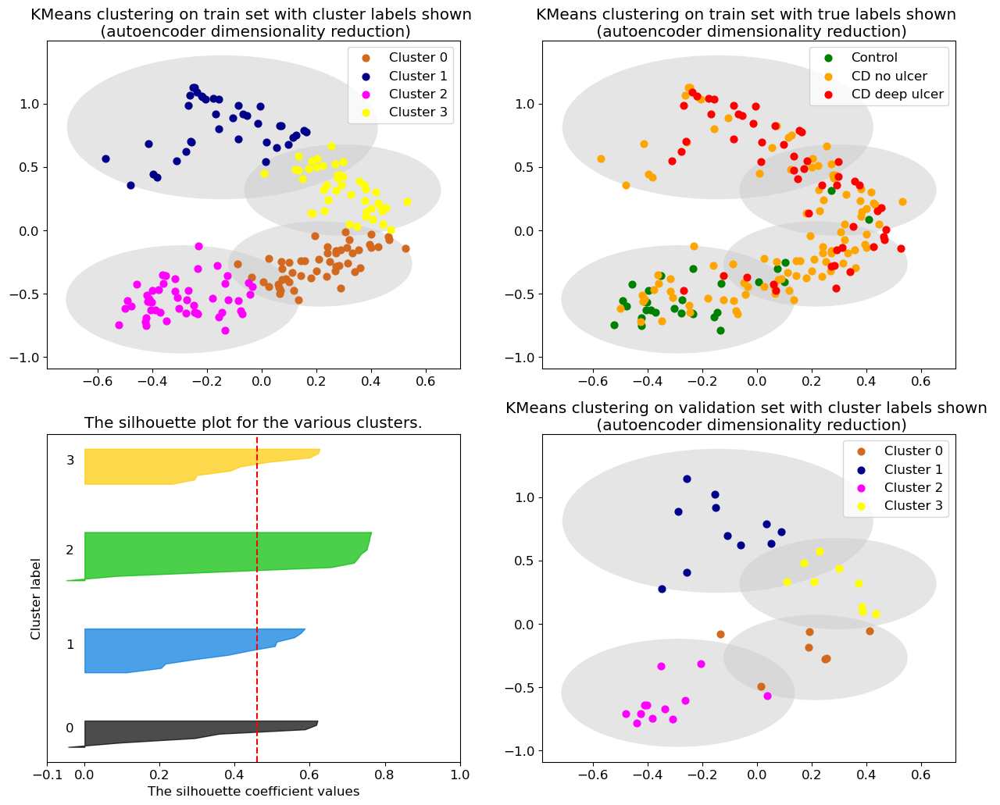

The average silhouette_score is : 0.45932898
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 250


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[k_labels_val==i, 0], X_val[k_labels_val==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


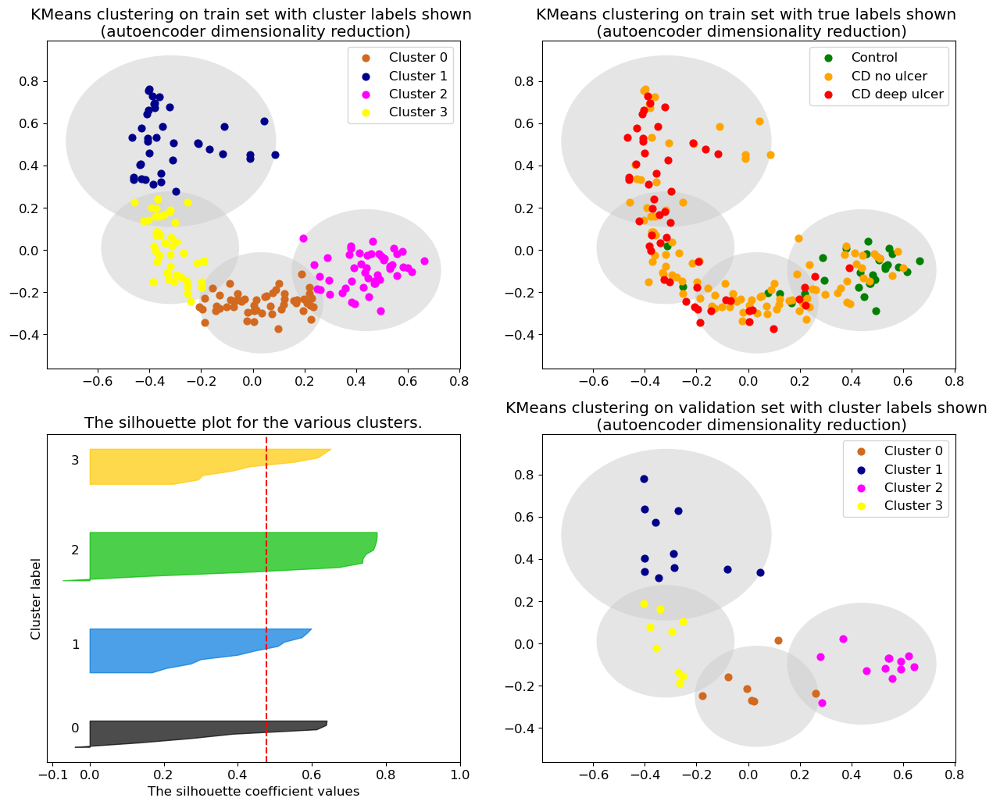

The average silhouette_score is : 0.4770574
Accuracy: 0.1794871794871795
F1 score: 0.23076923076923078


In [175]:
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

for perplexity in perplexities:
    kmeans_ae, X_train_ae, X_val_ae, X_test_ae, k_labels_train_ae, k_labels_val_ae, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
    print("Perplexity =",perplexity)
#     print(k_labels_train_pca)
    sil, acc, f1 = plot_kmeans(X_train_ae, X_val_ae, train_disease_labels, val_disease_labels, k_labels_train_ae, k_labels_val_ae, centers_ae, radii_ae, "autoencoder", test_set=False, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)

# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]

# for perplexity in perplexities:
#     kmeans_ae, X_train_ae, X_test_ae, k_labels_train_ae, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
#     print("Perplexity =",perplexity)
#     plot_kmeans(X_train_ae, train_disease_labels, k_labels_train_ae, centers_ae, radii_ae, "autoencoder", test_set=False, plot_sil=True)

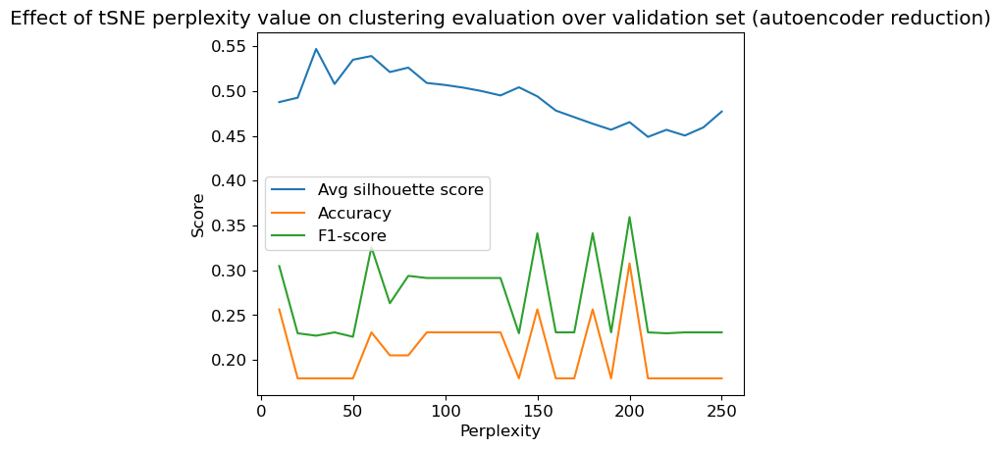

In [176]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "autoencoder")

### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 200


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\84834755.py:37: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


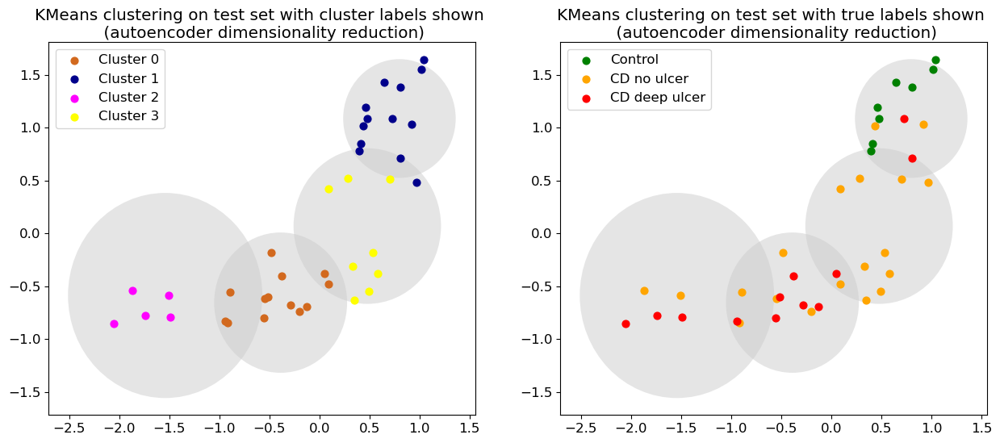

In [177]:
# plot with chosen tsne perplexity
perplexity = 200
kmeans_ae, X_train_ae, _, X_test_ae, k_labels_train_ae, _, k_labels_test_ae, centers_ae, radii_ae = train_kmeans(full_ae_dataset, perplexity)
print("Perplexity =",perplexity)
plot_kmeans(X_test_ae, None, test_disease_labels, None, k_labels_test_ae, None, centers_ae, radii_ae, "autoencoder", test_set=True)


## Process KMeans models

In [178]:
def pair_repeat(dup, cls_assignments, num_c, amounts):
    all_clusters = np.arange(num_c)
    # replace one of the duplicates with max of remaining clusters
    replace_class = np.where(cls_assignments == dup[0])[0][0]
    rem_cluster_a, rem_cluster_b = np.setdiff1d(all_clusters,cls_assignments)
    # rem_cluster_b
    if amounts[replace_class][rem_cluster_a] > amounts[replace_class][rem_cluster_b]:
        cls_assignments[replace_class] = rem_cluster_a
    else:
        cls_assignments[replace_class] = rem_cluster_b
        
    return cls_assignments

def handle_duplicates(cls_assignments, dup, c, num_c, amounts):
#     print("c:",c)
    if len(c) != 1:
        
        cls_assignments = pair_repeat(dup, cls_assignments, num_c, amounts)
    else: # 3 repeats of same thing
        # reassign class least associated to next most associated cluster
        given_cluster = dup[0]
        cls_least = np.argmin(amounts[:,given_cluster])
#         print(cls_least)
        class_amounts = amounts[cls_least,:]
        class_amounts[given_cluster] = -1
        next_cluster = np.argmax(class_amounts)
        cls_assignments[cls_least] = next_cluster
#         print("intermediate assignments",cls_assignments)
        
        # handle other duplicate pair
        u, c = np.unique(cls_assignments, return_counts=True)
        dup = u[c > 1]
        cls_assignments = pair_repeat(dup, cls_assignments, num_c, amounts)

    return cls_assignments


def softmax(x): 
    return np.exp(x)/sum(np.exp(x))

In [179]:

    
def process_clusters(amounts, X_train, num_c):
    all_clusters = np.arange(num_c)

    
    cls_assignments = np.argmax(amounts, axis=1) # assigned to class 0, 1, 2
#     print("initial cls assignments:",cls_assignments)
    
    # check for and handle duplicates
    u, c = np.unique(cls_assignments, return_counts=True)
    dup = u[c > 1]
#     print("dup:",dup[0])
    if len(dup) > 0:
        cls_assignments = handle_duplicates(cls_assignments, dup, c, num_c, amounts)
        
            
    class_assignment_amounts = np.max(amounts, axis=1) 
    
    assignments = [None] * 3
    
    assigned = 0
    while assigned < num_c - 1:
        curr_max_class = np.argmax(class_assignment_amounts)
        assigned_cluster = cls_assignments[curr_max_class]
        if assignments[curr_max_class] is None:
            assignments[curr_max_class] = [assigned_cluster]
        else:
            assignments[curr_max_class].append(assigned_cluster)
        class_assignment_amounts[curr_max_class] = -1
        assigned += 1

    # Assign remaining cluster
    
    rem_cluster = np.setdiff1d(all_clusters,cls_assignments)[0]
    
    rem_cls_assignment = np.argmax(amounts[:,rem_cluster], axis=0)
    assignments[rem_cls_assignment].append(rem_cluster)
    couple = assignments[rem_cls_assignment]
    # clusters assigned to disease class 0, 1, 2 (control, CD_no_ulcer, CD_deep_ulcer)
    
#     print(assignments)
#     print(couple)
    return assignments, couple

In [180]:
def get_class_from_label(label, couple, assignments):
    if label in couple:
        search_term = couple
    else:
        search_term = [label]
    try:
        cls = assignments.index(search_term)
    except:
        return None
    return cls


In [181]:
def get_final_clusters(assignments, couple, labels):
    test_set_clusters = []
    for label in labels:
        cls = get_class_from_label(label, couple, assignments)
        test_set_clusters.append(cls)

    test_set_clusters = np.array(test_set_clusters)
    return test_set_clusters

In [182]:
# centers = kmeans.cluster_centers_
# centers

In [183]:
num_c = 4

In [184]:
def get_count_matrix_km(kmeans, X_train, train_disease_labels):

    
    # make matrix to record number of each class in each cluster
    amounts = np.zeros((3, num_c))
    
    
    classes = ["control", "CD_no_ulcer", "CD_deep_ulcer"]
    centers = kmeans.cluster_centers_
    for c, cls in enumerate(classes):
        for pt in X_train[train_disease_labels==c]:
            pt = pt.reshape(1,-1)
            distances = cdist(centers, pt, 'euclidean')
            closest_cluster = np.argmin(distances)
            amounts[c][closest_cluster] += 1
    

#     print(amounts)
    #                cluster 0, cluster 1, cluster 2, cluster 3
    # control 
    # CD no ulcer
    # CD deep ulcer
    
    return amounts

In [185]:
# get_count_matrix_km(kmeans, X_train, train_disease_labels)

### Apply resulting models to test sets

In [186]:
centers_pca

array([[-3.0150824 , -0.35123965],
       [ 1.6363744 , -0.06636969],
       [ 3.747052  ,  0.76892054],
       [-1.0739381 , -0.47451925]], dtype=float32)

In [187]:
km_labels_list = [k_labels_test_ae, k_labels_test_pca]
km_models_list = [kmeans_ae, kmeans_pca]
train_set_list = [X_train_ae, X_train_pca]
test_set_list = [X_test_ae, X_test_pca]
centers_list = [centers_ae, centers_pca]
radii_list = [radii_ae, radii_pca]


In [188]:
# X_test_ae

In [189]:
def compute_metrics(X, true_labels, clus_labels):
    silhouette_avg, sample_silhouette_values = compute_silh_scores(X, clus_labels)
    acc = accuracy_score(true_labels, clus_labels)
    f1 = f1_score(true_labels, clus_labels, average='weighted')
#     print("The average silhouette_score is :",silhouette_avg)
#     print("Accuracy:",acc)
#     print("F1 score:",f1)
    
    return silhouette_avg, sample_silhouette_values, acc, f1

def print_scores(s_avgs, accs, f1_scores):
    typ = ["Autoencoder","PCA"]
    for i in range(len(accs)):
        print(typ[i]+":")
        print("Average silhouette score:",s_avgs[i])
        print("Accuracy:",accs[i])
        print("F1 score:",f1_scores[i])

C:\Users\shard\AppData\Local\Temp\ipykernel_31124\2391998775.py:46: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


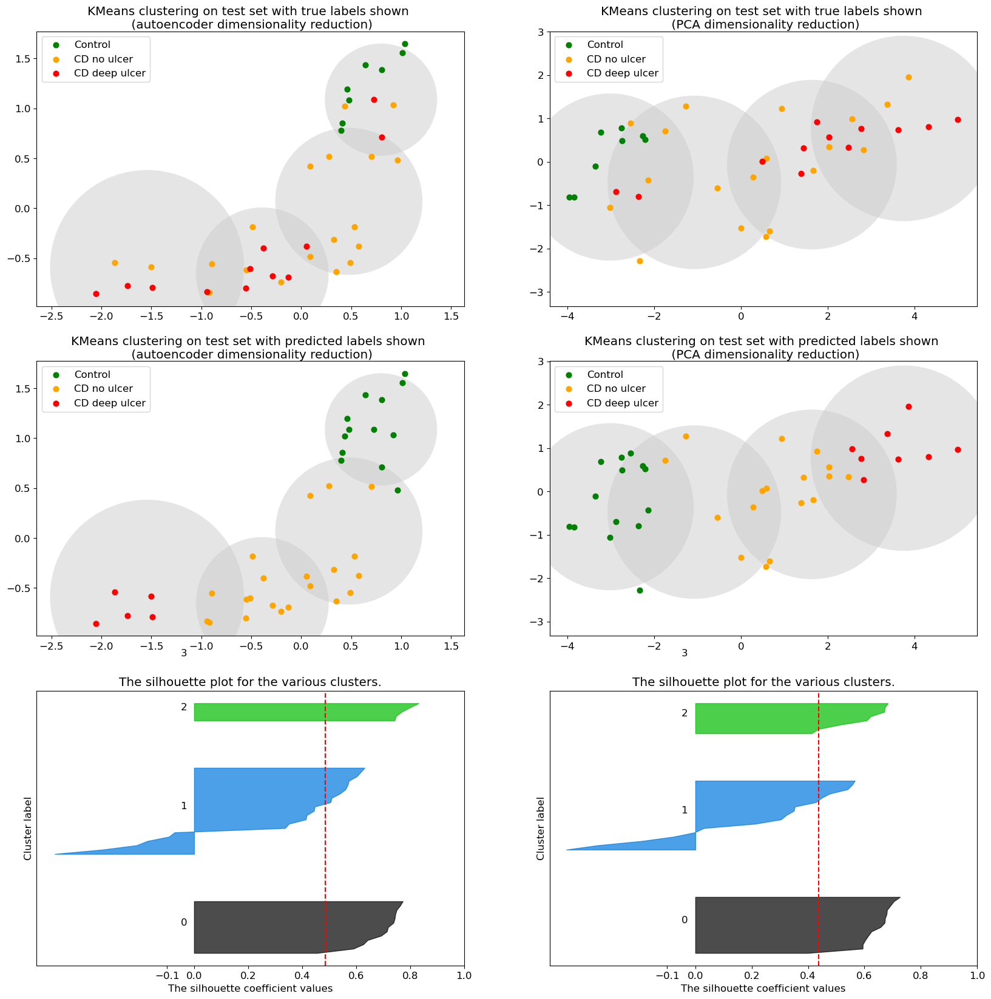

Autoencoder:
Average silhouette score: 0.4859152
Accuracy: 0.1282051282051282
F1 score: 0.1282051282051282
PCA:
Average silhouette score: 0.43682486
Accuracy: 0.8717948717948718
F1 score: 0.8187444739168876


In [190]:
def plot_final_km_models(labels_list, models_list, train_set_list, test_set_list, centers_list, radii_list, num_c):

    (fig, subplots) = plt.subplots(3, 2, figsize=(20,20))
    reduction = ["autoencoder", "PCA"]
    final_clusters_lst = []
    label_type = ["true","predicted"]
    for t in range(2):
        label = label_type[t]
        for i in range(len(models_list)):
    #         print(i)
            ax = subplots[t][i]
            km = models_list[i]
            km_labels = labels_list[i]
            X_train = train_set_list[i]
            X_test = test_set_list[i]
            centers = centers_list[i]
            radii = radii_list[i]
            if t > 0:
                amounts = get_count_matrix_km(km, X_train, train_disease_labels)
                assignments, couple = process_clusters(amounts, X_train, num_c)
                test_set_clusters = get_final_clusters(assignments, couple, km_labels)
                final_clusters_lst.append(test_set_clusters)
            else:
                test_set_clusters = test_disease_labels
    #         print("gmmlabels:",gmm_labels)
    #         print("tsclusters:",test_set_clusters)
    #         print("asgn:",assignments)
            

#             if t > 0:
#                 test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels)
#                 final_clusters_lst.append(test_set_clusters)
#                 final_probs_lst.append(probs)
#             else:
#                 test_set_clusters = test_disease_labels


            reduc = reduction[i]
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("KMeans clustering on test set with "+label+" labels shown \n (" + reduc + " dimensionality reduction)",
                        wrap=True)

            for i in range(num_clusters):
                ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

            ax.axis('equal')


            for c, r in zip(centers, radii):
                ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

            ax.legend()

    s_avgs = []
    accs = []
    f1_scores = []
    for j in range(2):
        ax = subplots[2][j]
        X_test = test_set_list[j]
        test_clusters = final_clusters_lst[j]
        true_labels = labels_list[j]
#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
        sil, sample_silhouette_values, acc, f1 = compute_metrics(X_test, true_labels, test_clusters)
        s_avgs.append(sil)
        accs.append(acc)
        f1_scores.append(f1)
        plot_silhouette(num_c, test_clusters, sample_silhouette_values, sil, ax)

    plt.show()


    print_scores(s_avgs, accs, f1_scores)

    
    return final_clusters_lst
        
final_clusters_ae, final_clusters_pca = plot_final_km_models(km_labels_list, km_models_list, train_set_list, test_set_list, centers_list, radii_list, num_c)

In [191]:
final_clusters_ae

array([1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 2, 1, 0, 2, 0, 0, 0, 1, 2, 1,
       1, 0, 2, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 2, 1, 1, 1])

## Gaussian Mixture Models

In [192]:
# https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html

from matplotlib.patches import Ellipse
from sklearn import mixture

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in range(1, 4):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, **kwargs))
        
def plot_gmm(gmm, X, X_val, true_labels, reduction, num_c=3, test=False, plot_sil=False):
    
    
    num_rows = 2 if plot_sil else 1
    dim_h = 12 if plot_sil else 6
    dim_w = 15 if plot_sil else 15
    (fig, subplots) = plt.subplots(num_rows, 2, figsize=(dim_w, dim_h))
    

    gmm_labels = gmm.predict(X)
    print(gmm_labels)
#     (fig, subplots) = plt.subplots(1, 2, figsize=(15, 6))
#     ax = ax or plt.gca()
    labels = [gmm_labels, true_labels]
    num_clusters = 3
    dset = "test" if test else "train"
    for i, label_set in enumerate(labels):
        ax = subplots[0][i] if plot_sil else subplots[i]
#         left = -8
#         right = 8
#         ax.set_xlim(left, right)
#         ax.set_ylim(left, right)
        
        
        if i==0:
            num_clusters = num_c
            cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
            colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
            ax.set_title("GMM soft clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                         wrap=True)
        else:
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("GMM soft clustering on " + dset + " set with true labels shown \n (" + reduction + " dimensionality reduction)",
                        wrap=True)
        
        print("num_clusters",num_clusters)
        for i in range(num_clusters):
            ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

        ax.axis('equal')
        

        w_factor = 0.2 / gmm.weights_.max()
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
        ax.legend()
        
        
    if plot_sil:
        gmm_val_labels = gmm.predict(X_val)
        silhouette_avg, sample_silhouette_values = compute_silh_scores(X_val, gmm_val_labels)
        plot_silhouette(num_c, gmm_val_labels, sample_silhouette_values, silhouette_avg, subplots[1][0])
#         subplots[1][1].axis('off')
        acc = accuracy_score(val_disease_labels, gmm_val_labels)
        f1 = f1_score(val_disease_labels, gmm_val_labels, average='weighted')
        ax = subplots[1][1]
        num_clusters = num_c
        cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
        colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
        ax.set_title("KMeans clustering on validation set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
                     wrap=True)
        for i in range(num_clusters):
            ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 
        w_factor = 0.2 / gmm.weights_.max()
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
    
    plt.show()
    
    if plot_sil:
        print("The average silhouette_score is :",silhouette_avg)
        print("Accuracy:",acc)
        print("F1 score:",f1)
        
        return silhouette_avg, acc, f1
        
        
    return gmm_labels

        
# def get_tsne_ds_true_labels():
#     tsne = manifold.TSNE(
#         n_components=2,
#         init="random",
#         random_state=0,
#         perplexity=24,
#         n_iter=750,
#         method='exact'
#     )
#     X = tsne.fit_transform(test_set)

In [193]:
# gmm.means_
# gmm.covariances_
# gmm.weights_

### Fit GMM with PCA dimensionality reduction

#### Training

In [194]:
num_c = 4

def fit_gmm(full_dataset, perplexity, num_c, split_pt=None):
    gmm = mixture.GaussianMixture(n_components=num_c,covariance_type='full', random_state=42)
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=perplexity,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_dataset)
    
    if split_pt is None:
        split_pt = int(0.7*len(full_dataset))
        split_pt_val = int(0.85*len(full_dataset))
        X_test = X[split_pt_val:]
        X_val = X[split_pt:split_pt_val]
    else:
        X_val = None
        X_test = X[split_pt:]
    X_train = X[:split_pt]
    gmm.fit(X_train)
    
    return gmm, X_train, X_test, X_val

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 10
[3 2 3 2 0 2 2 2 2 2 1 1 3 2 2 1 3 2 3 2 3 0 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 2 0 0 3 0 2 1 2 2 2 0 3 0 2 0 0 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 0 2 0 2 1 2 2 2 2 0 3 2 0 2 3 0 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 2 2 0 3 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 2 2]
num_clusters 4
num_clusters 3


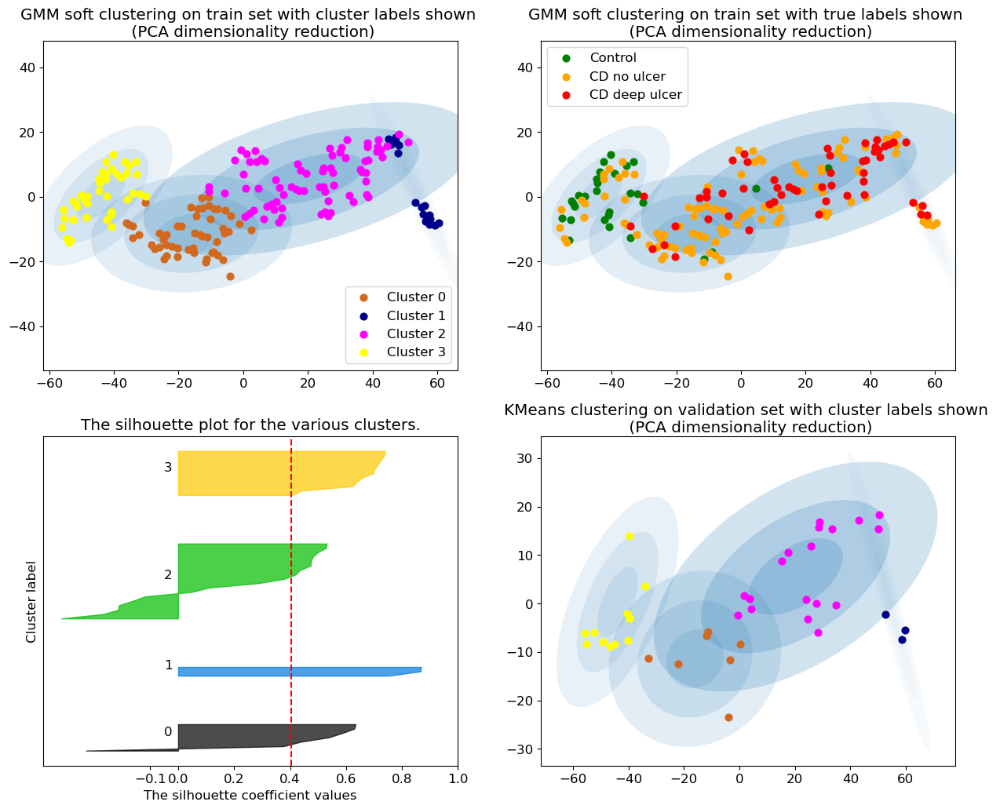

The average silhouette_score is : 0.40324163
Accuracy: 0.28205128205128205
F1 score: 0.27487179487179486


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 20
[0 2 3 3 3 3 2 2 2 2 2 1 0 2 2 1 0 3 0 3 0 3 1 0 2 3 2 0 3 3 2 3 3 3 0 3 0
 3 2 3 2 2 2 2 3 3 3 0 3 2 2 3 2 3 3 0 3 2 3 3 2 3 2 2 3 1 3 0 3 2 3 3 0 0
 0 3 3 2 3 2 2 2 2 2 2 3 0 2 3 2 0 3 3 2 2 0 3 3 2 3 2 3 3 2 1 3 2 0 3 2 2
 2 0 3 3 2 3 2 3 0 1 2 0 2 0 2 1 2 0 2 2 2 2 2 3 3 1 2 2 1 2 0 3 2 2 2 0 3
 2 3 2 2 3 3 3 2 3 3 0 2 2 3 0 3 3 2 3 2 2 0 0 0 3 0 3 3 0 1 3 0 3 3]
num_clusters 4
num_clusters 3


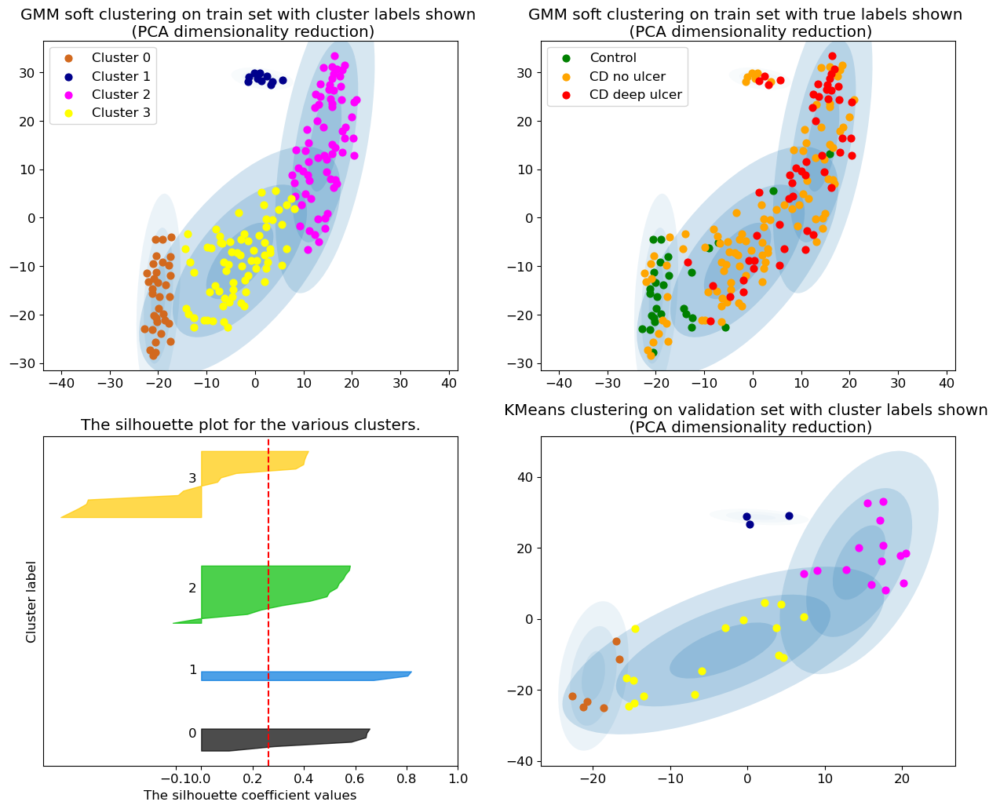

The average silhouette_score is : 0.26238266
Accuracy: 0.28205128205128205
F1 score: 0.30255693024923797


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 30
[3 2 3 2 0 2 2 2 2 1 1 1 3 1 2 1 3 2 3 2 3 0 1 3 2 0 2 3 3 3 1 0 0 0 3 0 3
 0 1 0 2 2 1 1 2 0 0 3 0 2 1 2 2 0 0 3 0 2 0 0 2 0 2 1 0 1 0 3 0 2 0 0 3 3
 3 0 0 2 0 2 1 2 1 1 2 0 3 2 0 2 3 3 0 1 2 3 0 3 2 3 2 2 3 1 1 0 2 3 0 2 2
 2 3 0 3 1 0 2 0 3 1 2 3 2 3 1 1 1 3 2 1 2 2 1 0 0 1 1 2 1 2 3 0 2 2 1 3 3
 2 0 1 1 0 0 0 1 0 3 3 2 1 0 3 3 0 1 3 2 2 3 3 3 0 3 3 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


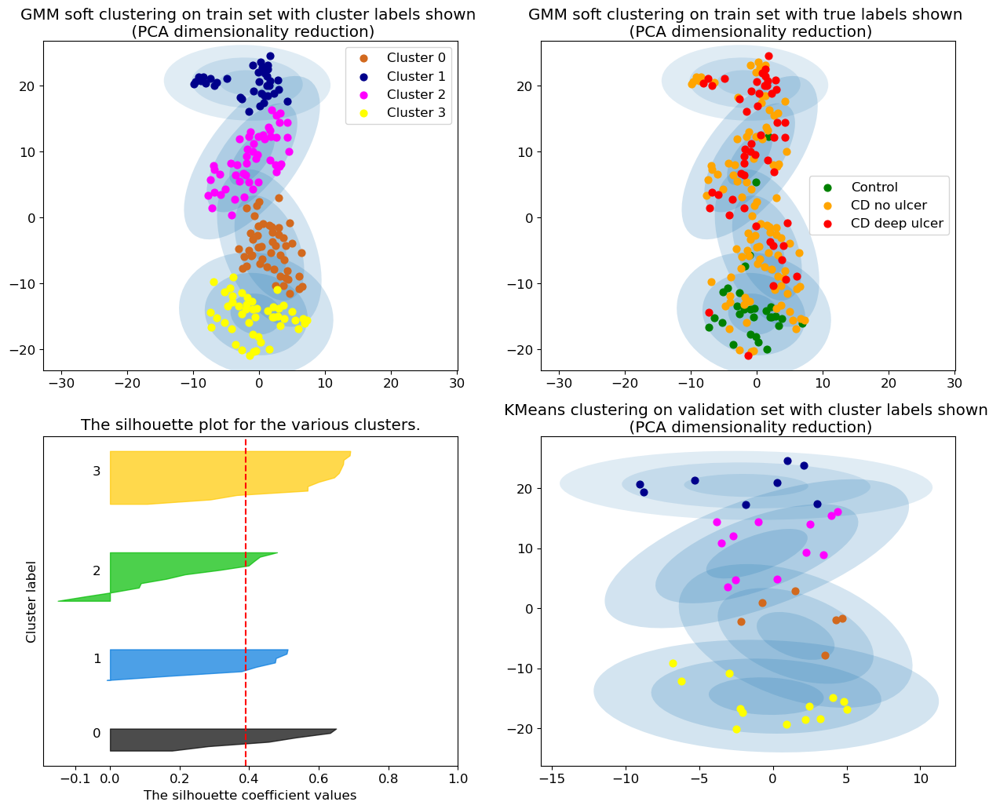

The average silhouette_score is : 0.39046997
Accuracy: 0.3076923076923077
F1 score: 0.3675213675213675


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 40
[2 2 0 2 3 2 2 2 2 2 2 1 0 2 2 1 0 2 0 2 3 3 1 0 2 3 2 0 3 3 2 3 2 3 0 2 3
 3 2 3 2 2 2 2 2 3 3 0 3 2 2 2 2 2 2 0 3 2 2 3 2 3 2 2 3 1 3 0 3 2 2 2 0 0
 0 3 3 2 2 2 2 2 2 2 2 2 3 2 3 2 3 3 2 2 2 3 3 2 2 0 2 2 0 2 1 3 2 3 3 2 2
 2 3 2 0 2 3 2 3 0 1 2 0 2 0 2 1 2 0 2 2 2 2 2 2 2 1 2 2 1 2 3 2 2 2 2 0 3
 2 3 2 2 3 3 2 2 3 3 0 2 2 3 0 0 2 2 3 2 2 0 0 0 3 0 3 0 0 1 2 0 2 2]
num_clusters 4
num_clusters 3


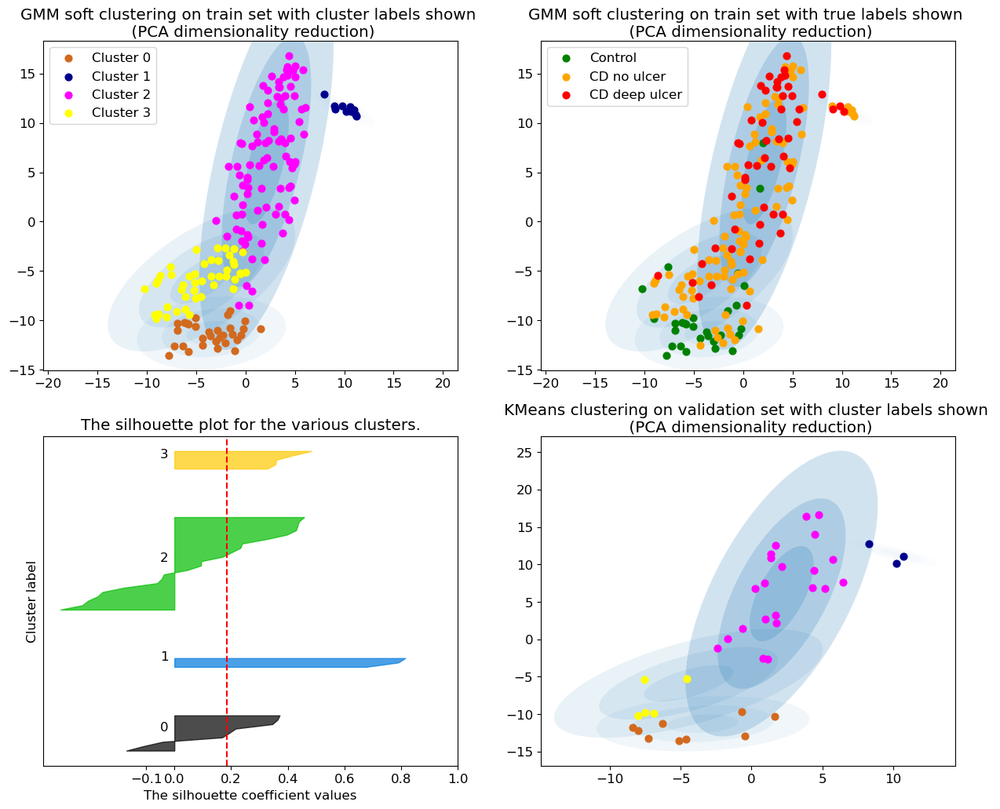

The average silhouette_score is : 0.18571351
Accuracy: 0.41025641025641024
F1 score: 0.3445119586296057


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 50
[0 2 3 2 0 2 2 2 2 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 0 3 0 2 0 2 0 3 0 3
 0 2 0 2 2 2 1 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 0 0 2 0 0 0 3
 0 0 0 2 2 2 1 2 1 2 2 0 3 2 3 2 3 0 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 2 0 2 3 2 0 3 1 2 0 2 3 1 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


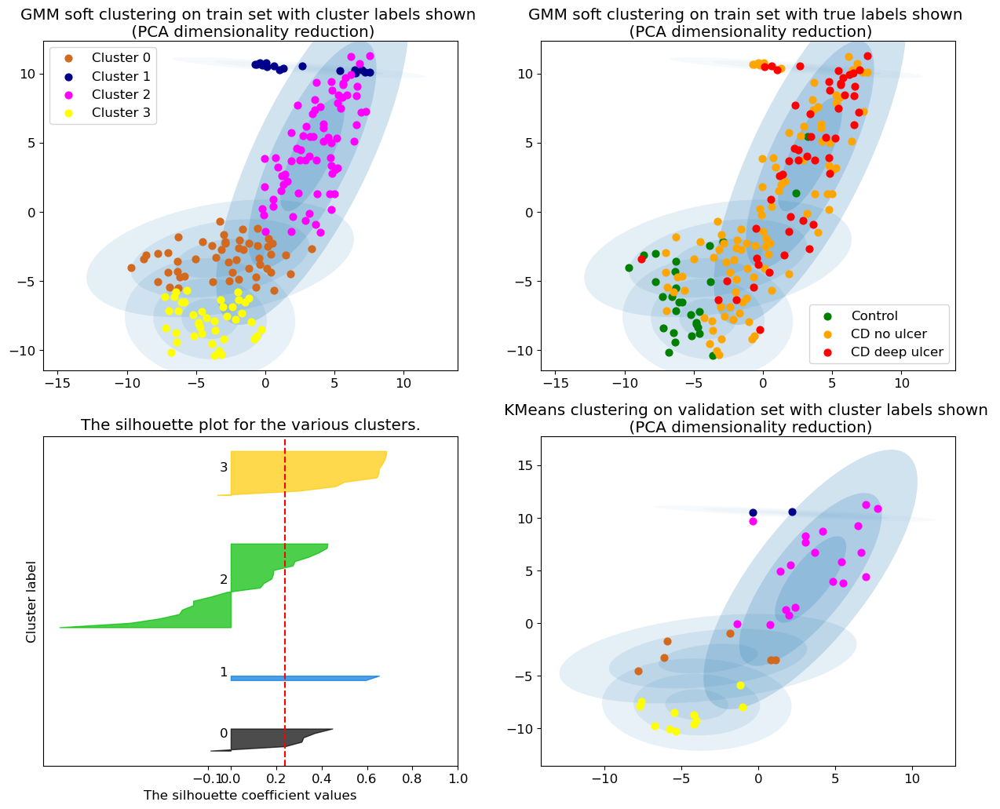

The average silhouette_score is : 0.23790374
Accuracy: 0.28205128205128205
F1 score: 0.24339549339549343


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 60
[3 2 3 2 0 2 2 2 2 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 1 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 3 0 2 0 0 3 3
 3 0 3 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 3 2 0 3 1 2 3 2 3 1 1 2 3 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 3 2 2 0 3 3 0 2 3 2 2 3 3 3 0 3 3 3 3 1 2 3 2 0]
num_clusters 4
num_clusters 3


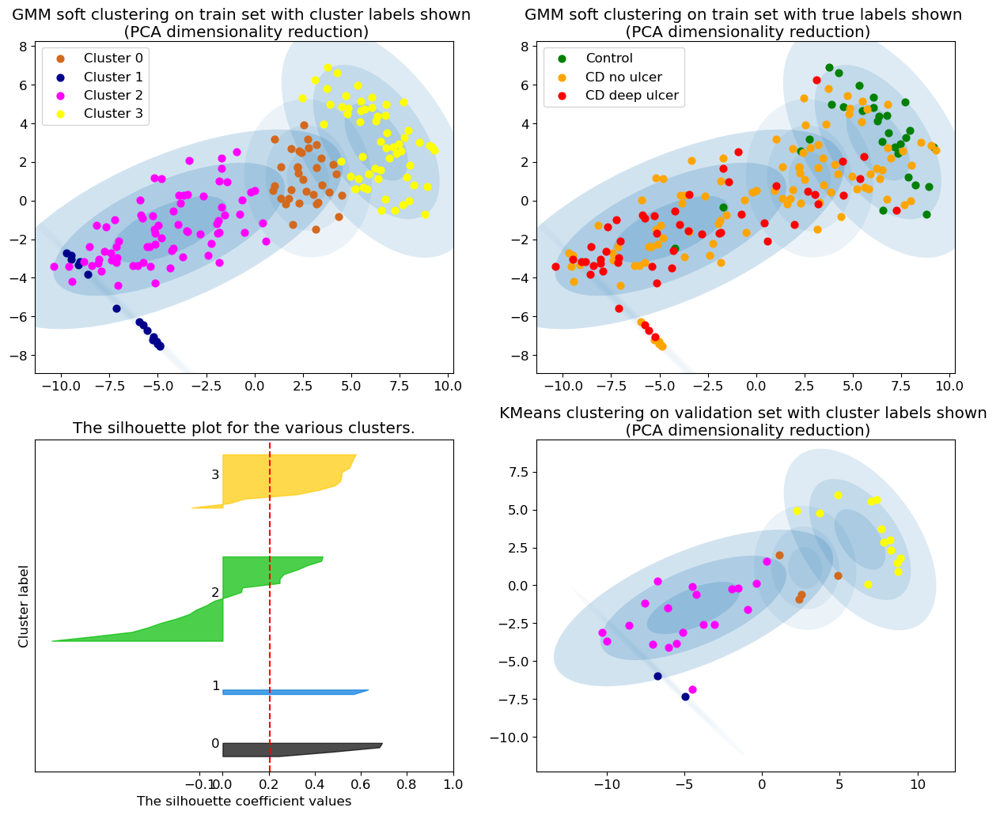

The average silhouette_score is : 0.20349962
Accuracy: 0.2564102564102564
F1 score: 0.22008547008547014


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 70
[3 1 3 1 0 1 1 1 1 1 1 2 3 1 1 2 3 1 3 1 3 3 1 3 1 3 1 3 3 3 1 0 1 0 3 0 3
 0 1 0 1 1 1 1 1 0 0 3 3 1 1 1 1 0 0 3 3 1 0 3 1 0 1 1 0 2 0 3 0 1 0 0 3 3
 3 0 3 1 1 1 1 1 1 1 1 0 3 1 3 1 3 3 0 1 1 3 0 3 1 3 1 1 3 1 2 0 1 3 0 1 1
 1 3 0 3 1 3 1 0 3 2 1 3 1 3 1 2 1 3 1 1 1 1 1 1 0 2 1 1 2 1 3 0 1 1 1 3 3
 1 3 1 1 0 3 0 1 0 3 3 1 1 0 3 3 0 1 3 1 1 3 3 3 0 3 3 3 3 2 1 3 1 0]
num_clusters 4
num_clusters 3


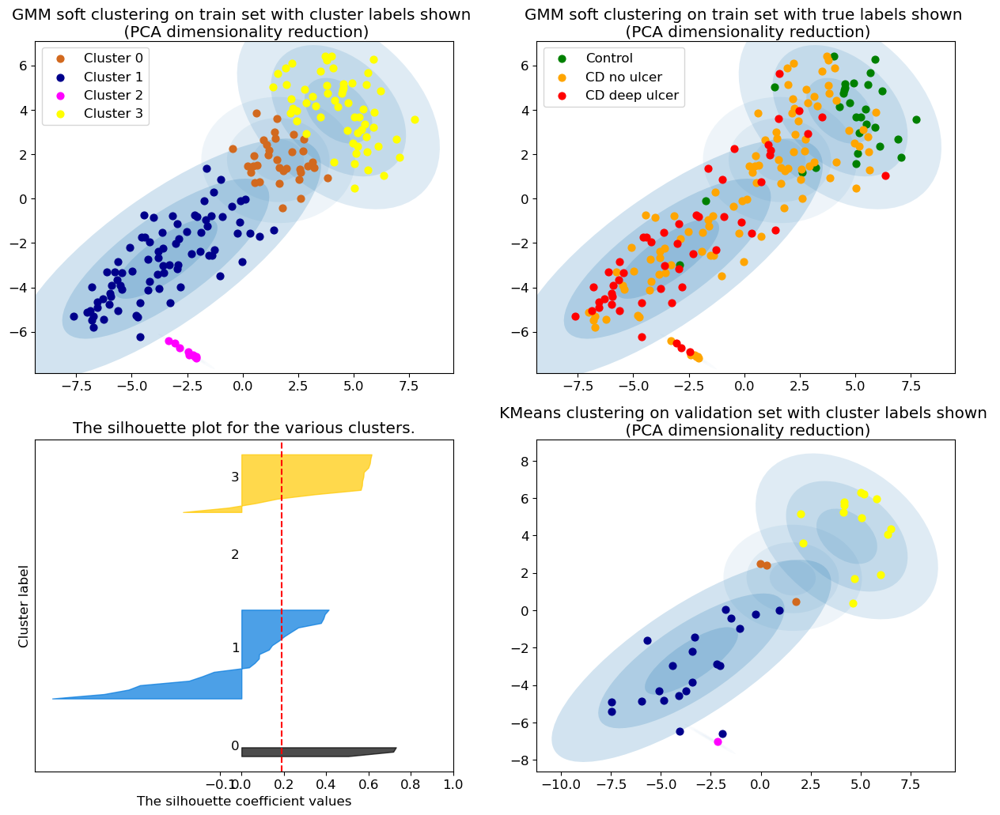

The average silhouette_score is : 0.1885016
Accuracy: 0.3333333333333333
F1 score: 0.3621852208614283


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 80
[0 2 3 2 0 0 2 2 0 2 2 1 3 2 2 1 3 2 3 2 3 3 2 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 0 0 2 0 0 0 3
 0 0 0 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 0 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 0 2 3 2 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 0 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


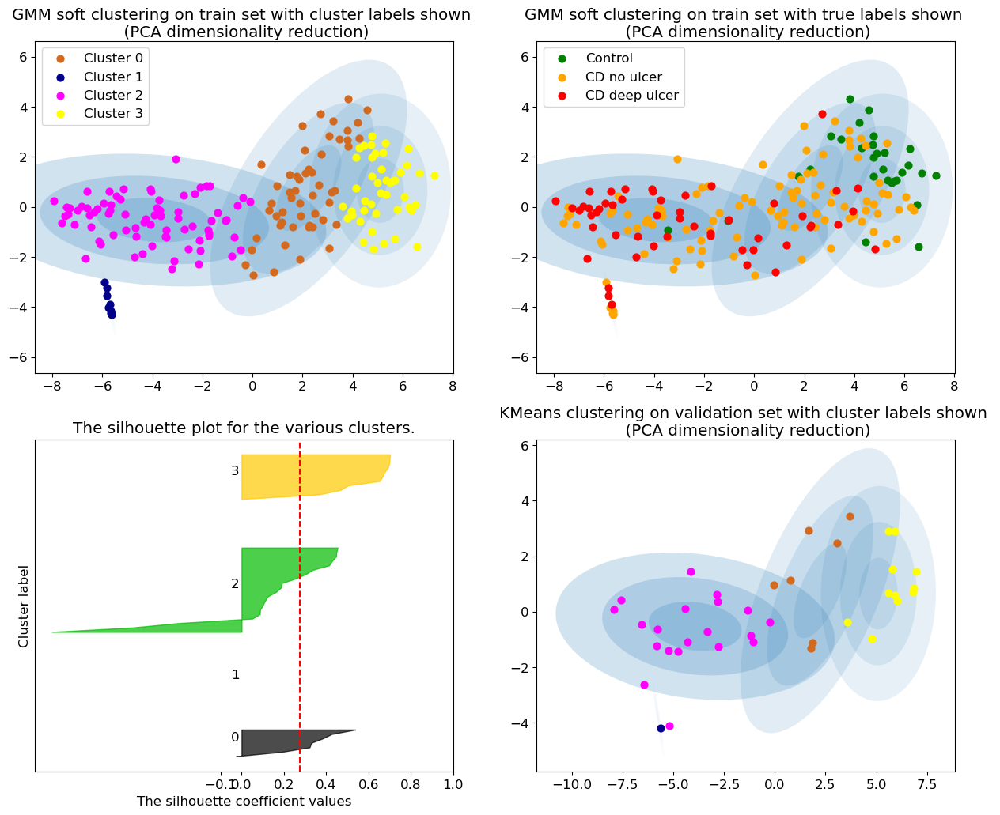

The average silhouette_score is : 0.27655867
Accuracy: 0.2564102564102564
F1 score: 0.19444444444444448


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 90
[0 2 0 2 3 2 2 2 2 2 2 1 0 2 2 1 0 2 0 2 0 3 2 0 2 3 2 0 3 3 2 3 3 3 0 3 0
 3 2 3 2 2 2 2 2 3 3 0 3 2 2 2 2 3 3 0 3 2 3 3 2 3 2 2 3 1 3 0 3 2 2 3 0 0
 0 3 3 2 2 2 2 2 2 2 2 3 0 2 3 2 0 0 3 2 2 0 3 0 2 0 2 2 0 2 1 3 2 0 3 2 2
 2 0 3 0 2 3 2 3 0 1 2 0 2 0 2 1 2 0 2 2 2 2 2 2 3 1 2 2 1 2 0 0 2 2 2 0 3
 2 3 2 2 3 3 3 2 3 3 0 2 2 3 0 0 3 2 3 2 2 0 0 0 3 0 3 0 0 1 2 0 3 2]
num_clusters 4
num_clusters 3


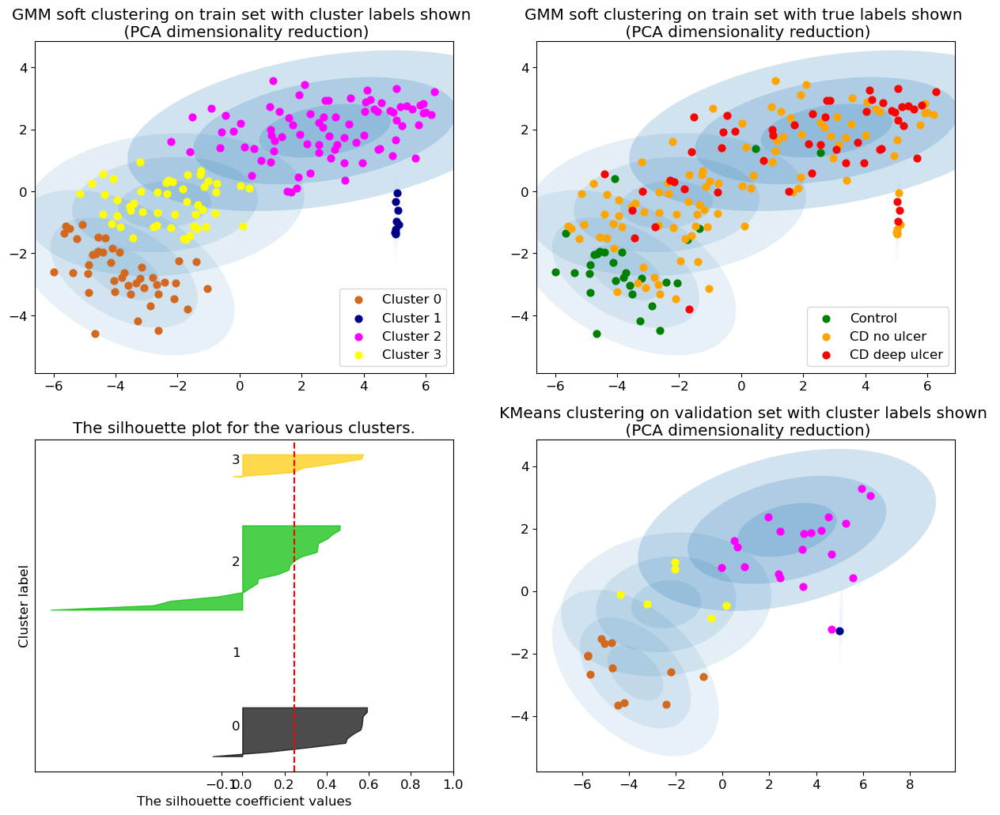

The average silhouette_score is : 0.2481508
Accuracy: 0.358974358974359
F1 score: 0.24849170437405738


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 100
[0 2 3 2 0 0 2 2 0 2 2 1 3 2 2 1 3 2 3 2 3 3 2 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 0 0 2 0 0 0 3
 0 0 0 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 0 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 0 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


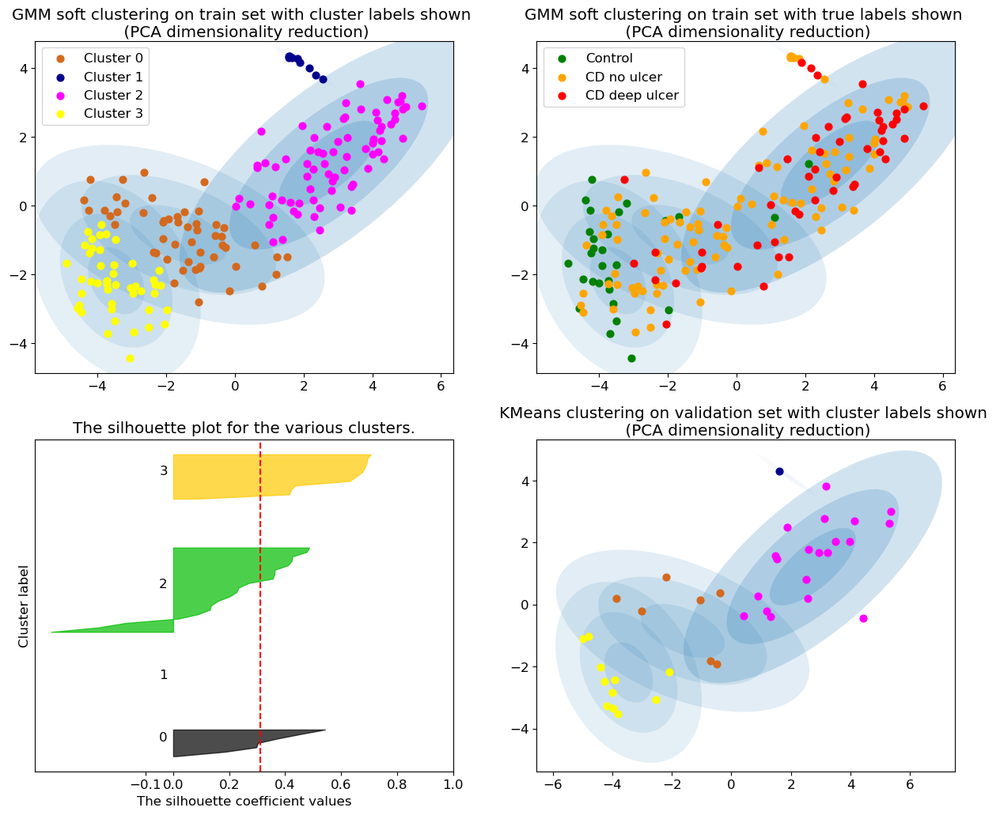

The average silhouette_score is : 0.3114408
Accuracy: 0.2564102564102564
F1 score: 0.19444444444444448


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 110
[0 2 3 2 0 2 2 2 0 2 2 1 3 2 2 1 3 2 3 2 3 3 2 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 2 2 2 0 0 3 3 2 2 2 2 0 0 3 3 2 0 3 2 0 2 2 0 1 0 0 0 2 0 0 0 3
 0 0 0 2 2 2 2 2 2 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 2 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


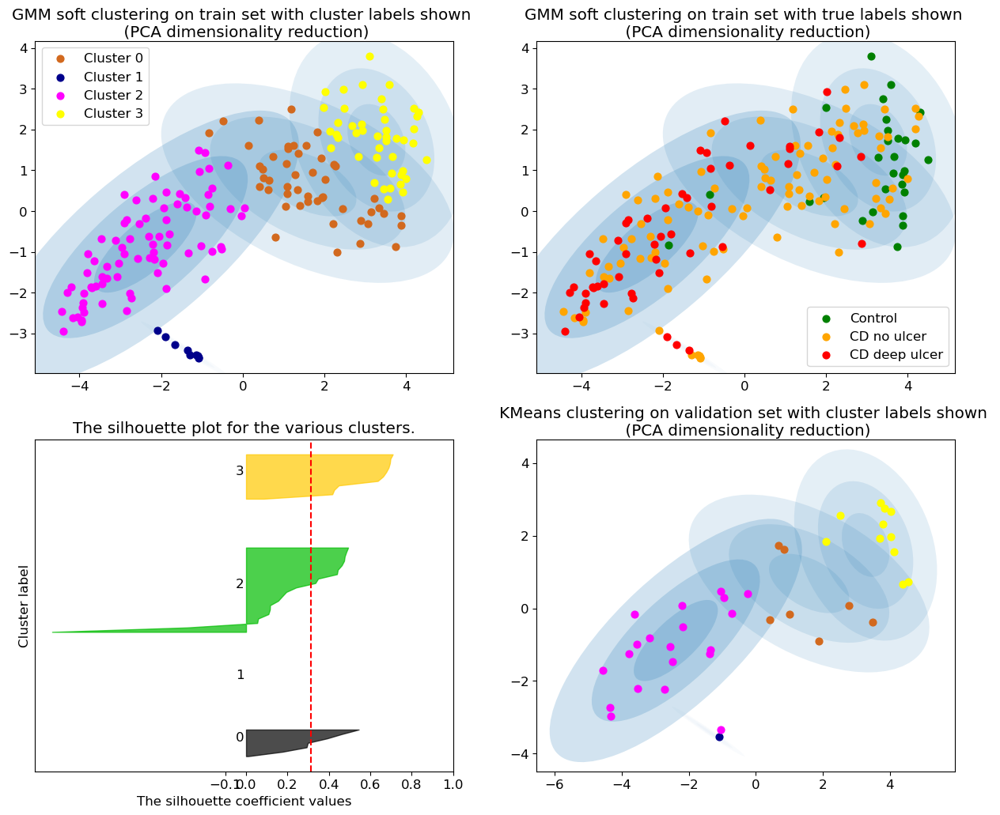

The average silhouette_score is : 0.3143297
Accuracy: 0.2564102564102564
F1 score: 0.19444444444444448


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)


Perplexity = 120
[2 3 2 3 0 3 3 3 3 1 1 1 2 1 3 1 2 3 2 3 2 2 1 2 3 2 3 2 2 2 1 0 3 0 2 0 2
 2 3 0 3 3 1 1 3 0 0 2 2 3 1 3 3 0 0 2 2 3 0 2 3 0 3 1 0 1 0 2 2 3 0 0 2 2
 2 0 2 3 3 3 1 3 1 1 3 0 2 3 2 3 2 2 0 3 3 2 0 0 0 2 3 3 0 1 1 0 3 2 0 3 3
 3 2 0 0 1 2 3 0 2 1 3 2 3 2 1 1 3 2 3 1 3 3 1 3 0 1 1 3 1 3 2 0 3 3 1 2 2
 3 2 1 1 0 2 0 1 0 2 2 3 1 0 2 2 0 1 2 3 3 2 2 2 0 2 2 2 2 1 3 2 3 0]
num_clusters 4


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


num_clusters 3


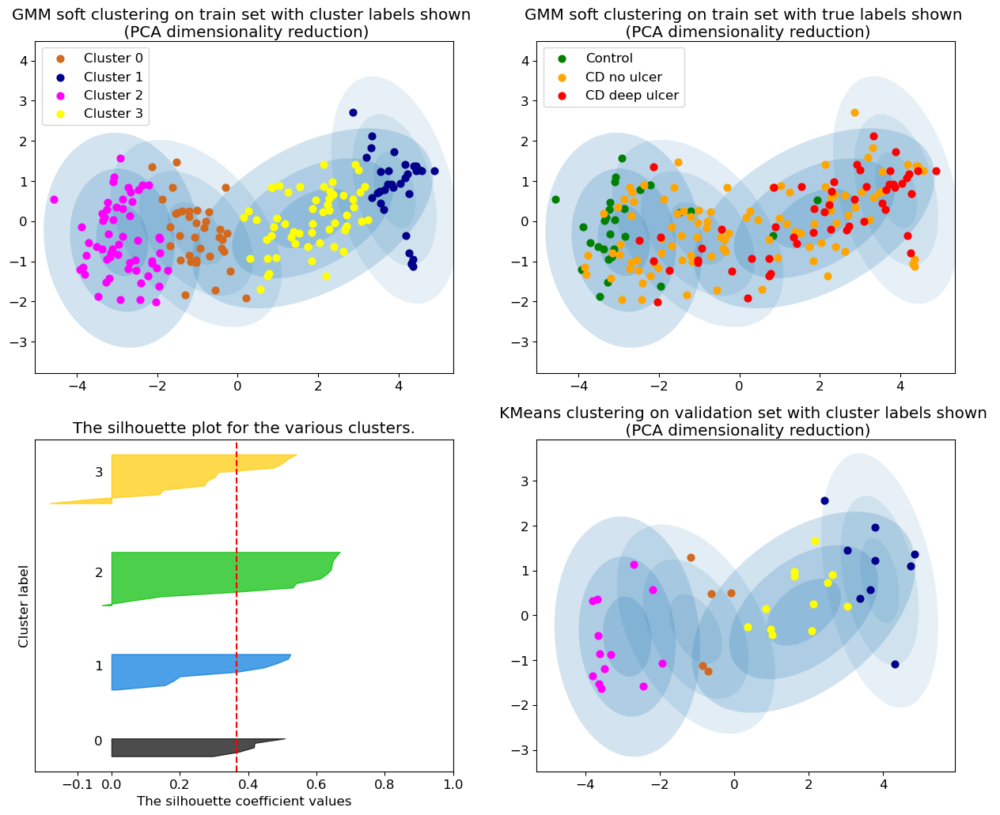

The average silhouette_score is : 0.36543757
Accuracy: 0.15384615384615385
F1 score: 0.20658395368072788


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 130
[0 2 3 2 0 2 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 3 2 3 3 3 2 0 2 0 3 0 3
 0 2 0 2 2 1 2 2 0 0 3 3 2 1 2 2 0 0 3 3 2 0 3 2 0 2 1 0 1 0 0 3 2 0 0 0 3
 0 0 0 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 0 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 3 2 0 3 1 2 3 2 3 2 1 2 0 2 1 2 2 2 2 0 1 2 2 1 2 3 0 2 2 2 3 3
 2 3 2 2 0 3 0 2 0 3 0 2 2 0 0 3 0 2 3 2 2 3 3 0 0 3 3 3 3 1 2 0 2 0]
num_clusters 4
num_clusters 3


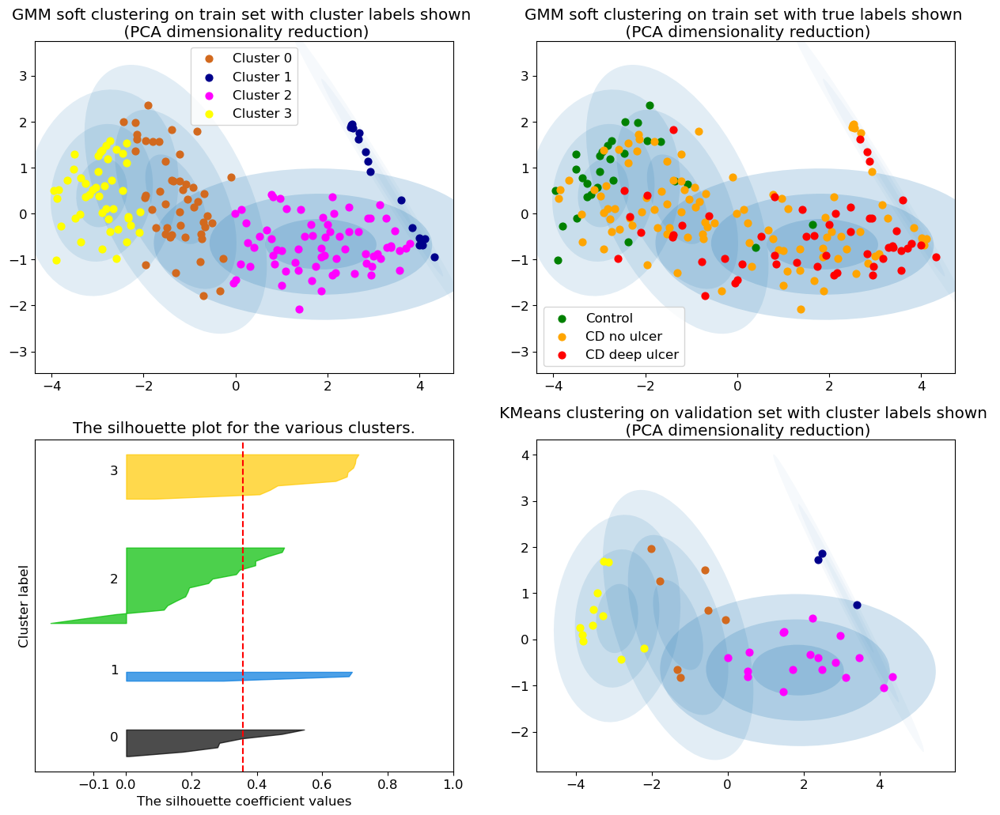

The average silhouette_score is : 0.35694954
Accuracy: 0.3076923076923077
F1 score: 0.2962393162393162


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 140
[3 2 3 2 0 2 2 2 2 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 2 2 0 0 3 0 2 1 2 2 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 2 2 0 3 3
 3 0 0 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 2 0 1 2 2 1 2 3 3 2 2 2 3 3
 2 0 2 2 0 0 0 2 0 0 3 2 2 0 3 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 2]
num_clusters 4
num_clusters 3


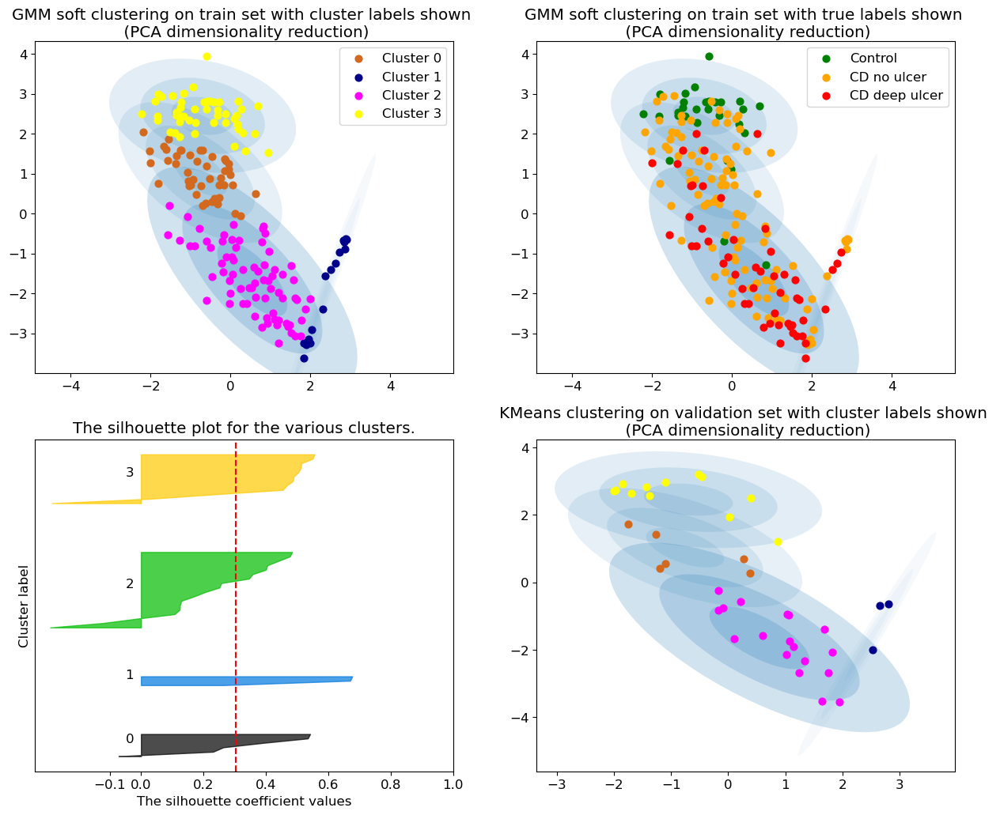

The average silhouette_score is : 0.3044565
Accuracy: 0.28205128205128205
F1 score: 0.27487179487179486


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 150
[3 1 3 1 0 1 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 3 1 3 3 3 1 0 1 0 3 0 3
 3 1 0 1 1 2 1 1 0 0 3 3 1 2 1 1 0 0 3 3 1 0 3 1 0 1 2 0 2 0 3 3 1 0 0 3 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 3 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 1 1 3 3
 1 3 1 1 0 3 0 1 0 3 0 1 1 0 0 3 0 1 3 1 1 3 3 3 0 3 3 3 3 2 1 3 1 0]
num_clusters 4
num_clusters 3


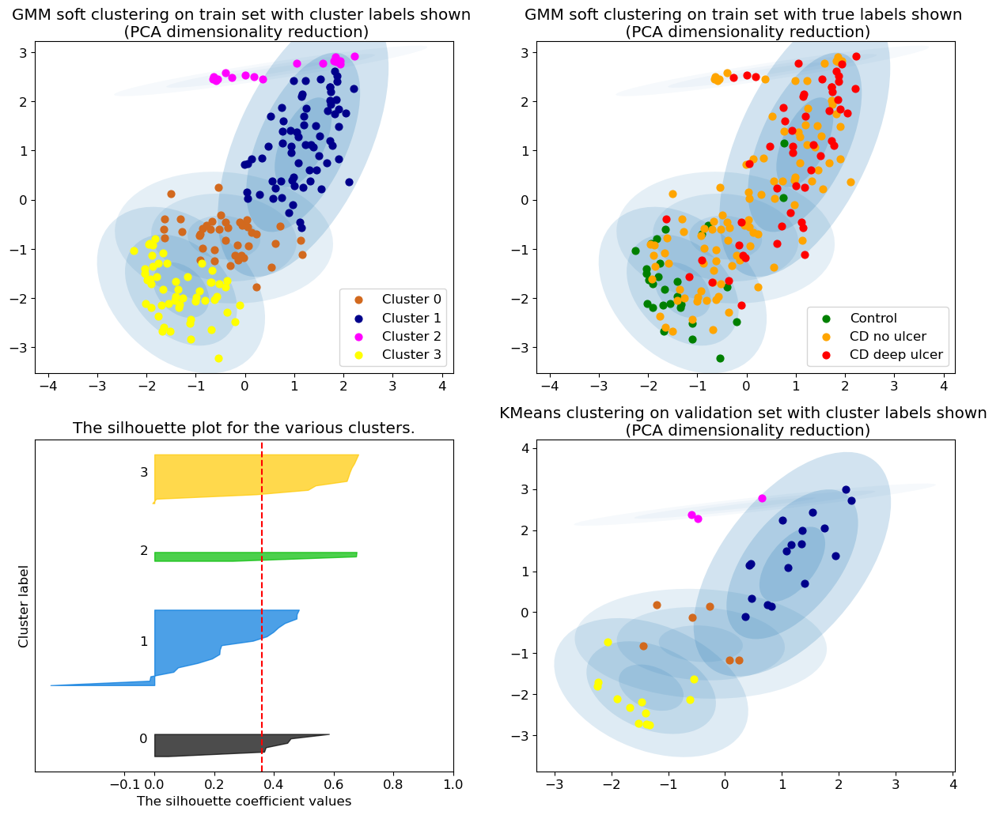

The average silhouette_score is : 0.3606605
Accuracy: 0.2564102564102564
F1 score: 0.2948717948717949


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 160
[3 2 3 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 0 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 2 2 0 0 3 0 2 1 2 0 0 0 3 3 2 0 0 2 0 2 2 0 1 0 3 0 0 2 0 3 3
 3 0 0 2 2 2 1 2 1 2 2 0 3 2 0 2 3 3 0 2 2 3 0 3 2 3 2 2 3 2 1 0 2 3 0 2 2
 2 3 0 3 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 0 0 1 2 2 1 0 3 3 2 2 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 2 2 0 3 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 2]
num_clusters 4
num_clusters 3


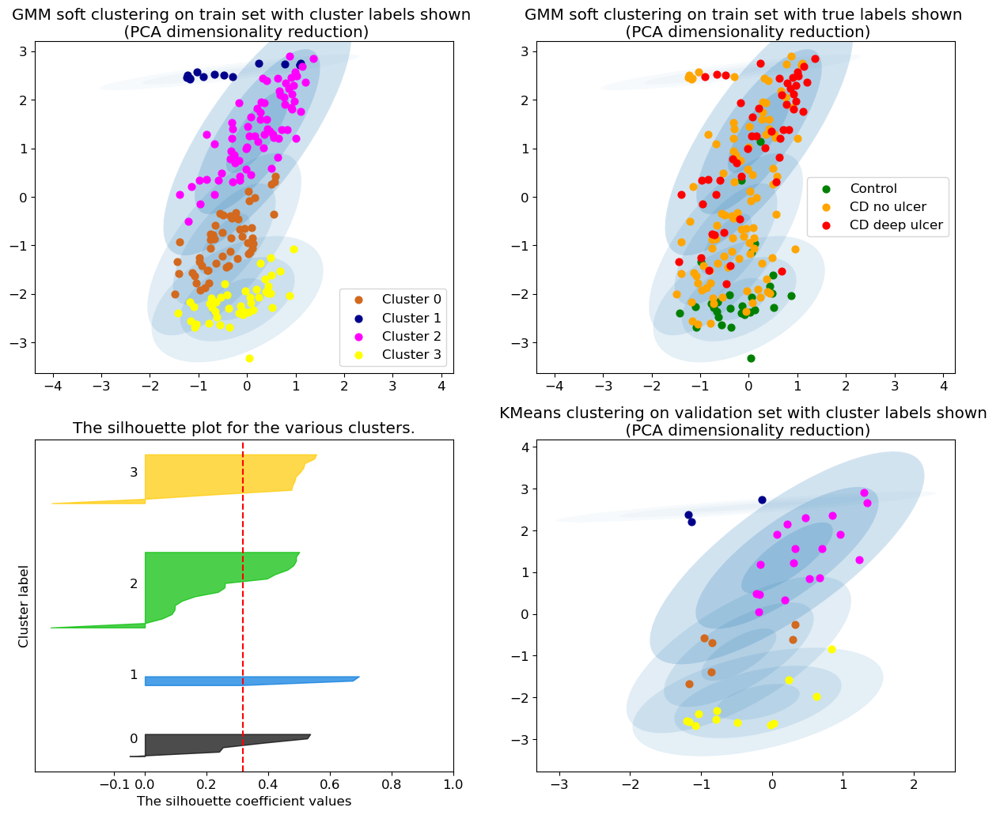

The average silhouette_score is : 0.31762093
Accuracy: 0.28205128205128205
F1 score: 0.27487179487179486


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 170
[3 2 0 2 0 2 2 2 2 2 2 1 3 2 2 1 3 2 3 2 3 0 2 3 2 0 2 3 0 0 2 0 0 0 3 0 0
 0 2 0 2 2 2 2 2 0 0 3 0 2 2 2 0 0 0 3 0 2 0 0 2 0 2 2 0 1 0 3 0 0 2 0 3 3
 3 0 0 2 2 2 2 2 2 2 2 0 0 2 0 2 3 0 0 2 2 3 0 3 2 0 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 2 2 2 2 2 0 1 2 2 1 0 3 0 2 2 2 3 0
 2 0 2 2 0 0 0 2 0 0 3 2 2 0 3 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 2]
num_clusters 4
num_clusters 3


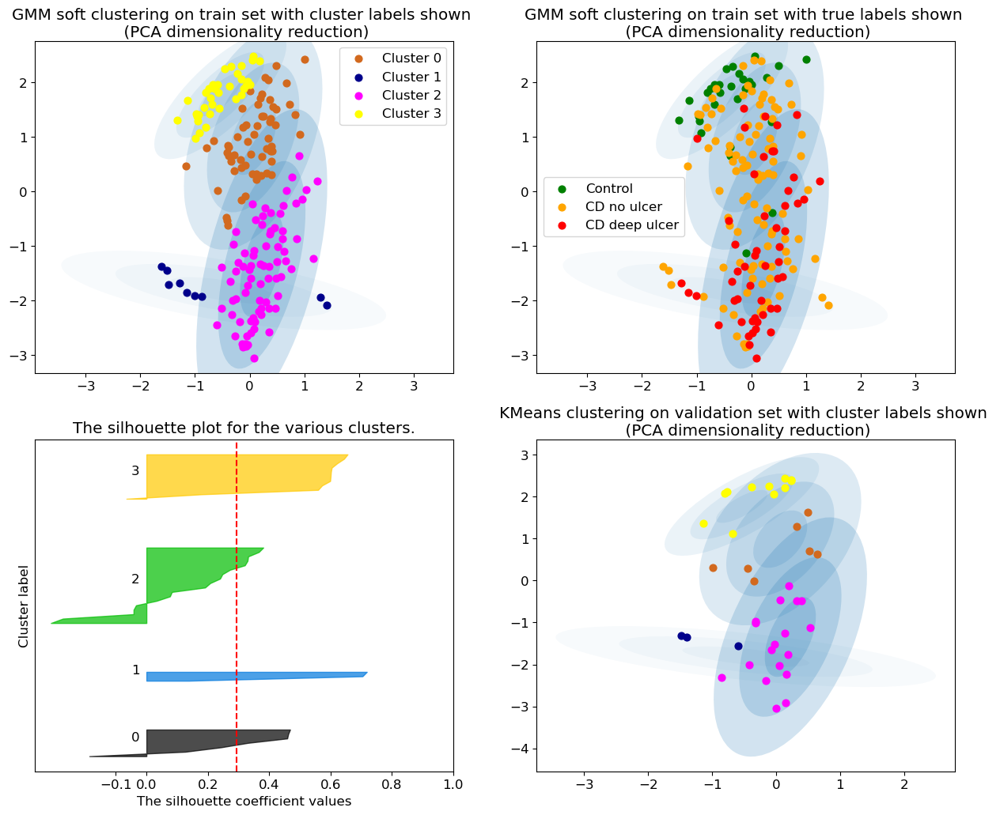

The average silhouette_score is : 0.29280877
Accuracy: 0.28205128205128205
F1 score: 0.27487179487179486


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 180
[0 2 3 2 0 0 1 2 0 1 1 2 3 1 2 2 3 2 3 2 3 3 1 3 1 3 2 3 3 3 1 0 2 0 3 0 3
 3 1 0 1 2 1 1 2 0 0 3 3 2 1 2 2 0 0 3 3 1 2 3 2 0 1 1 0 2 0 3 3 2 0 0 0 3
 3 0 0 1 2 2 1 1 1 1 2 0 3 2 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 2 3 0 2 2
 1 3 0 2 1 3 1 0 3 2 1 3 1 3 1 2 1 0 1 1 1 1 1 2 0 2 1 2 2 2 3 0 2 0 1 3 3
 2 3 1 1 0 3 0 1 0 3 0 1 1 0 0 3 0 1 3 1 1 3 3 0 0 3 3 3 3 2 2 0 2 0]
num_clusters 4
num_clusters 3


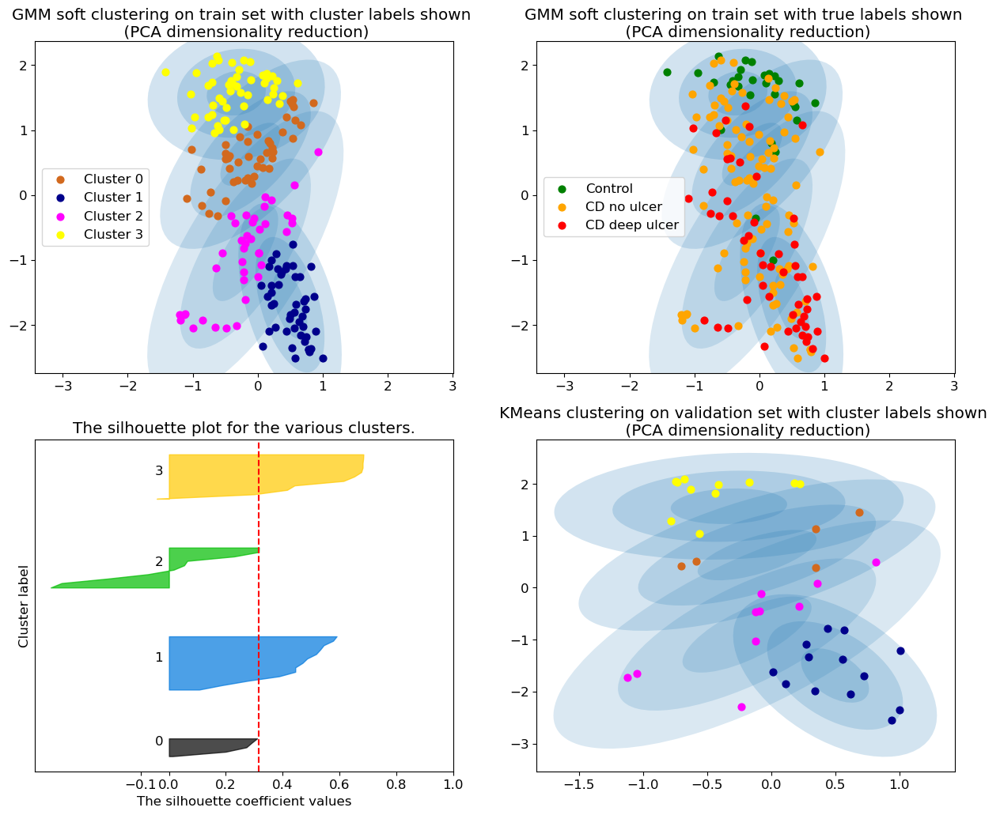

The average silhouette_score is : 0.31666204
Accuracy: 0.2564102564102564
F1 score: 0.30296370296370295


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 190
[3 0 3 0 0 0 2 2 0 1 1 2 3 0 0 2 3 0 3 0 3 0 0 3 0 0 0 3 0 0 1 0 0 0 3 0 3
 0 0 0 2 0 1 1 0 0 0 3 0 0 1 0 0 0 0 3 3 2 0 0 2 0 0 1 0 2 0 3 0 0 0 0 3 3
 3 0 0 0 0 0 1 0 1 1 0 0 0 2 0 2 3 0 0 1 2 3 0 3 0 3 0 0 3 1 2 0 0 3 0 0 0
 0 3 0 3 1 0 2 0 3 2 0 3 2 3 1 2 1 3 2 1 0 2 1 0 0 2 1 0 2 0 3 3 0 0 1 3 0
 0 0 1 1 0 0 0 1 0 0 3 0 1 0 3 3 0 0 0 2 2 3 3 3 0 3 0 3 3 2 0 3 0 0]
num_clusters 4
num_clusters 3


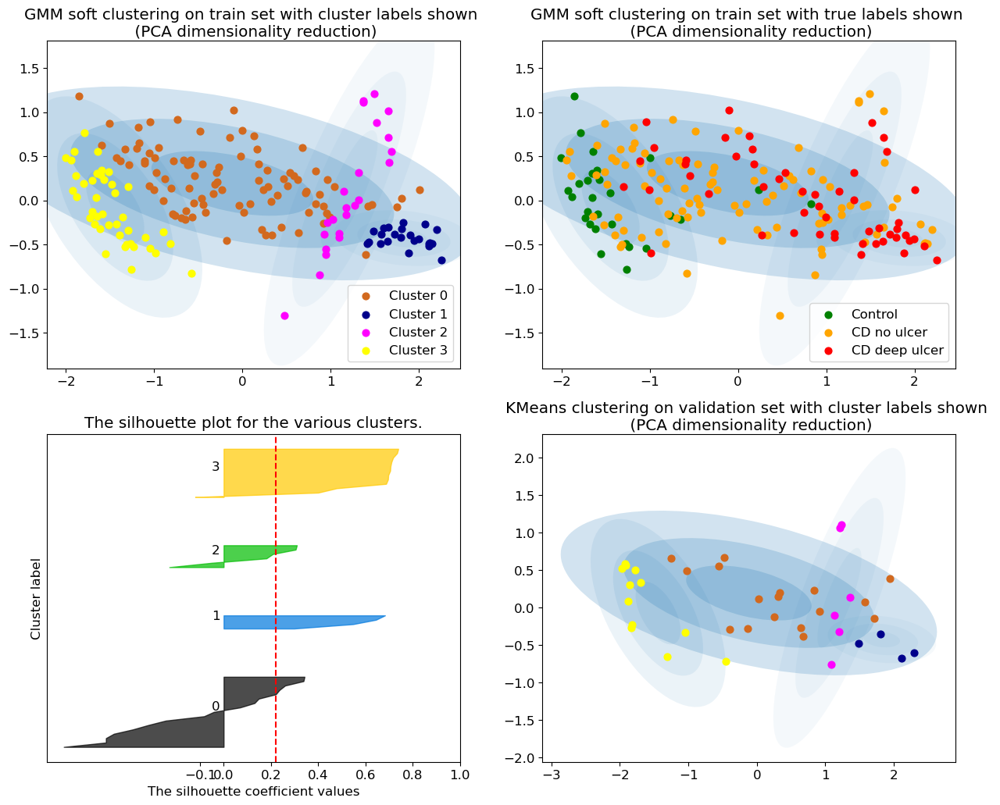

The average silhouette_score is : 0.22010826
Accuracy: 0.1794871794871795
F1 score: 0.2669296515450361


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 200
[0 2 3 2 0 0 1 2 0 1 1 2 3 1 2 2 3 2 3 2 3 3 1 3 1 3 2 3 3 3 1 0 2 0 3 0 3
 3 1 0 1 2 1 1 2 0 0 3 3 1 1 2 2 0 0 3 3 1 2 3 2 3 1 1 0 2 0 3 3 2 0 0 0 3
 3 0 3 1 2 2 1 1 1 1 1 0 3 2 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 2 3 0 2 2
 1 3 0 2 1 3 1 0 3 2 1 3 1 3 1 2 1 0 1 1 1 1 1 2 0 2 1 2 2 2 3 0 2 0 1 3 3
 2 3 1 1 0 3 0 1 0 3 0 1 1 0 0 3 0 1 3 1 1 3 3 0 0 3 3 3 3 2 2 0 2 0]
num_clusters 4
num_clusters 3


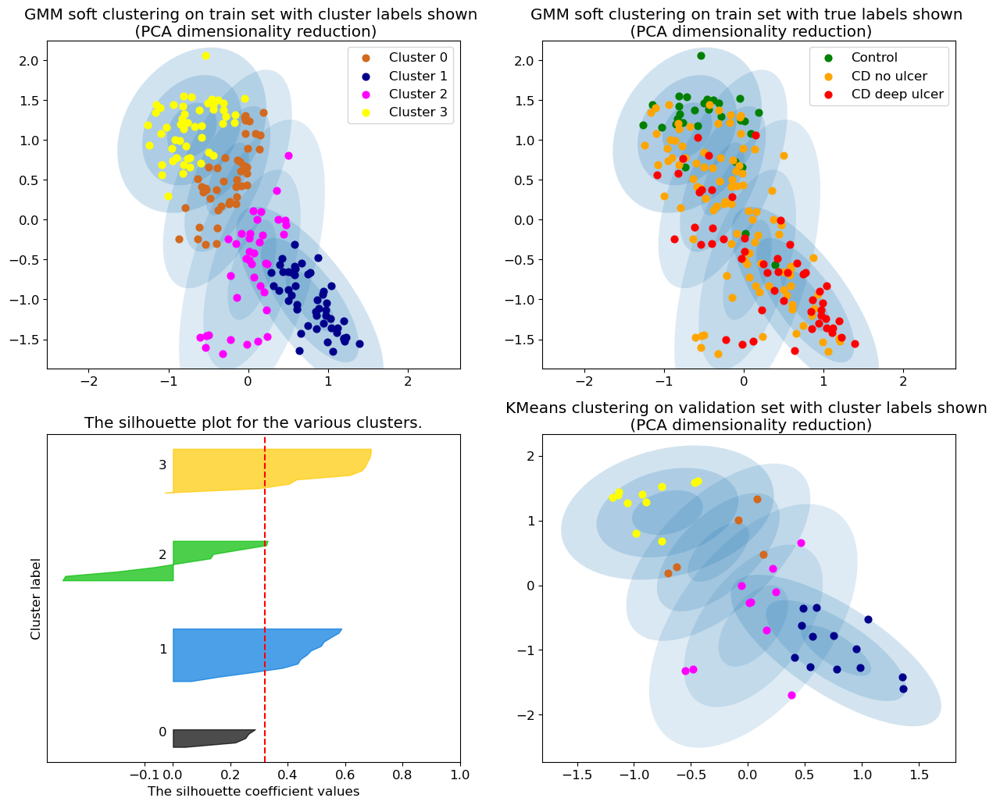

The average silhouette_score is : 0.31985158
Accuracy: 0.2564102564102564
F1 score: 0.30296370296370295


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 210
[0 1 3 1 0 1 1 1 1 1 2 2 0 1 1 2 3 1 0 1 3 3 2 3 1 3 1 0 3 3 1 3 1 0 0 1 3
 3 1 3 1 1 2 1 1 3 3 0 3 1 2 1 1 3 0 0 3 1 0 3 1 3 1 2 0 2 1 0 3 1 1 1 0 0
 0 0 3 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 3 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 1 1 1
 1 3 1 0 1 3 1 0 3 2 1 0 1 3 1 2 1 0 1 2 1 1 1 1 1 2 1 1 2 1 3 0 1 1 1 3 3
 1 3 1 1 3 3 1 1 3 3 0 1 1 0 0 3 1 2 3 1 1 0 3 0 3 0 3 3 3 2 1 0 1 1]
num_clusters 4
num_clusters 3


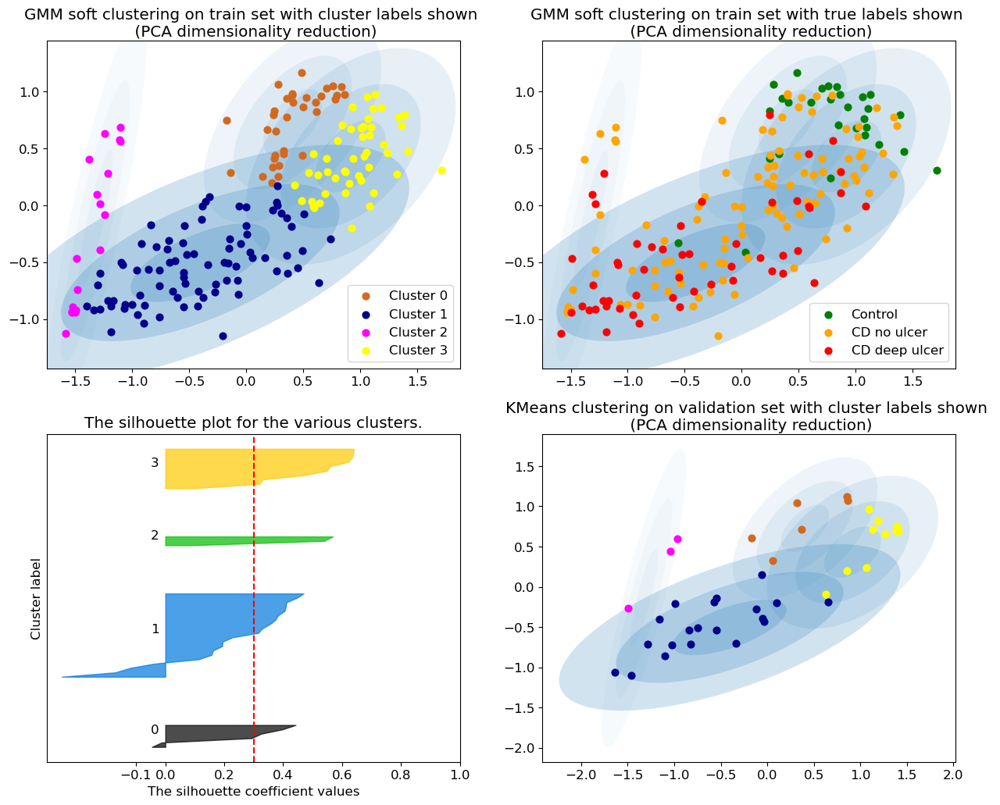

The average silhouette_score is : 0.30062222
Accuracy: 0.358974358974359
F1 score: 0.37957597957597955


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 220
[2 0 2 0 0 0 1 1 0 3 3 1 2 1 1 1 2 1 2 1 2 2 1 2 1 2 0 2 2 0 3 0 0 0 2 0 2
 2 1 0 1 1 3 3 0 0 0 2 2 1 3 1 1 0 0 2 2 1 0 2 1 0 1 3 0 1 0 2 0 1 0 0 2 2
 2 0 2 1 1 1 3 1 3 3 1 0 2 1 2 1 2 2 0 3 1 2 0 2 0 2 1 0 0 3 1 0 1 2 0 1 1
 3 2 0 0 3 2 1 0 2 1 1 2 3 2 3 1 3 2 1 3 1 1 3 0 0 1 3 1 1 1 2 0 1 0 3 2 2
 1 2 3 3 0 0 0 3 0 2 2 1 3 0 2 2 0 3 2 1 1 2 2 2 0 2 2 2 2 1 1 2 0 0]
num_clusters 4
num_clusters 3


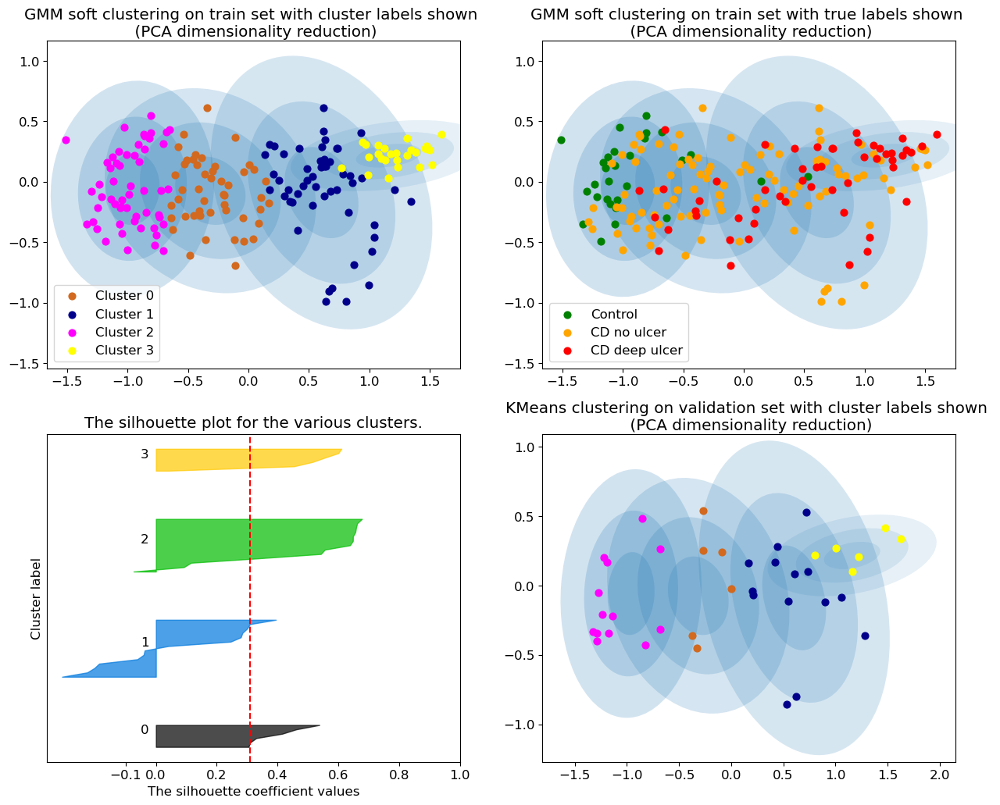

The average silhouette_score is : 0.30983597
Accuracy: 0.20512820512820512
F1 score: 0.24398860398860395


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 230
[0 1 3 1 0 1 1 1 1 1 2 2 0 1 1 2 3 1 0 1 3 3 2 3 1 3 1 0 3 3 1 3 1 0 0 1 3
 3 1 3 1 1 1 1 1 3 3 0 3 1 2 1 1 3 0 0 3 1 0 3 1 1 1 1 0 2 0 0 3 1 1 1 0 0
 0 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 0 3 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 1 1 1
 1 3 1 0 1 3 1 0 3 2 1 0 1 3 1 2 1 0 1 2 1 1 1 1 1 2 1 1 2 1 3 0 1 1 1 3 3
 1 3 1 1 3 3 3 1 3 3 0 1 1 0 0 3 1 2 3 1 1 0 3 0 3 0 3 3 3 2 1 0 1 1]
num_clusters 4
num_clusters 3


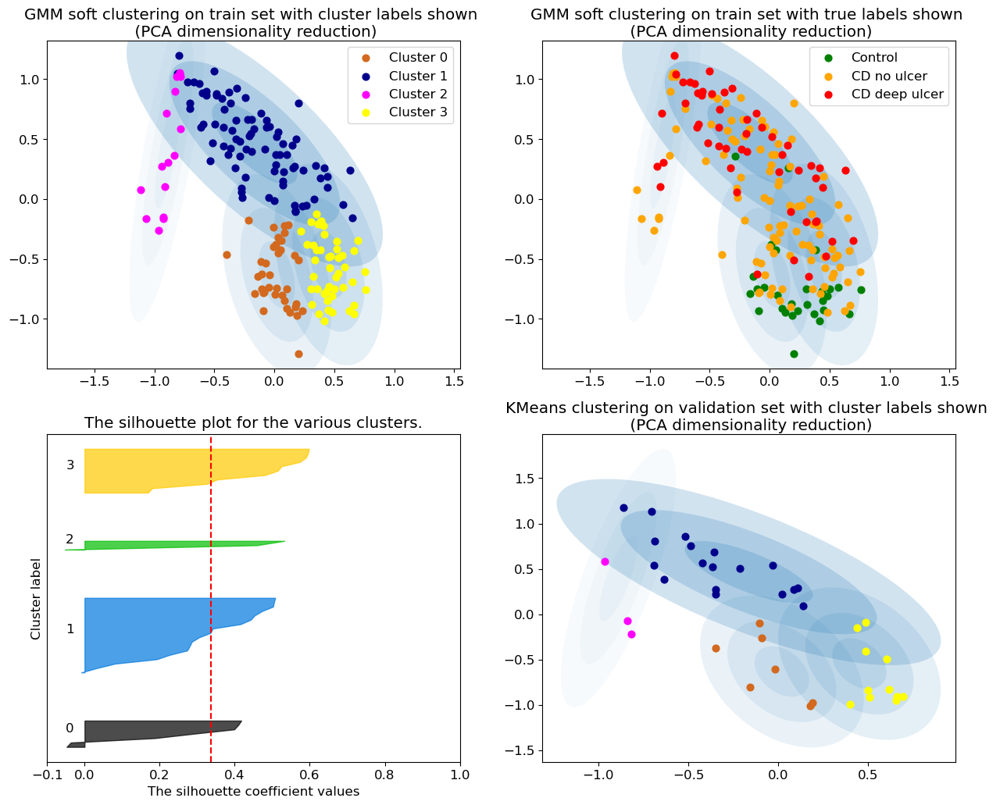

The average silhouette_score is : 0.3361531
Accuracy: 0.3333333333333333
F1 score: 0.358974358974359


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 240
[0 1 0 1 3 1 1 1 1 1 1 2 0 1 1 2 0 1 0 1 0 3 2 0 1 3 1 0 3 3 1 3 3 3 0 3 0
 3 1 3 1 1 1 1 1 3 3 0 3 1 2 1 3 3 3 0 0 1 3 3 1 3 1 1 3 2 3 0 3 3 3 3 0 0
 0 3 3 1 1 1 1 1 1 1 1 3 3 1 3 1 0 0 3 1 1 0 3 0 1 3 1 1 0 1 2 3 1 0 3 1 1
 1 0 3 0 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 1 1 1 1 1 3 2 1 1 2 3 0 0 1 1 1 0 3
 1 3 1 1 3 3 3 1 3 3 0 1 1 3 0 0 3 2 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


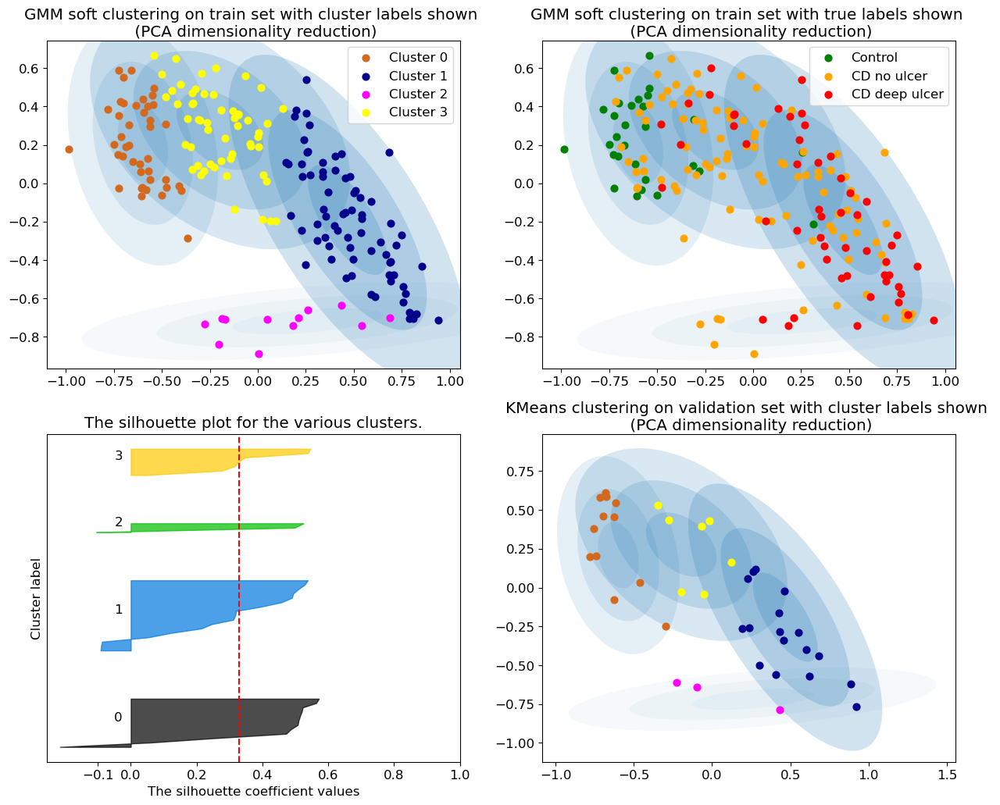

The average silhouette_score is : 0.32841927
Accuracy: 0.358974358974359
F1 score: 0.34786711528792974


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 250
[0 1 0 1 3 1 1 1 1 1 1 2 0 1 1 2 0 1 0 1 0 3 2 0 1 3 1 0 3 3 1 3 3 3 0 3 0
 3 1 3 1 1 1 1 1 3 3 0 3 1 1 1 1 3 3 0 0 1 3 3 1 3 1 1 3 2 3 0 3 1 3 3 0 0
 0 3 3 1 1 1 1 1 1 1 1 3 3 1 3 1 0 0 3 1 1 0 3 0 1 3 1 1 0 1 2 3 1 0 3 1 1
 1 0 3 0 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 1 1 1 1 1 3 2 1 1 2 3 0 0 1 1 1 0 3
 1 3 1 1 3 3 3 1 3 3 0 1 1 3 0 0 3 2 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


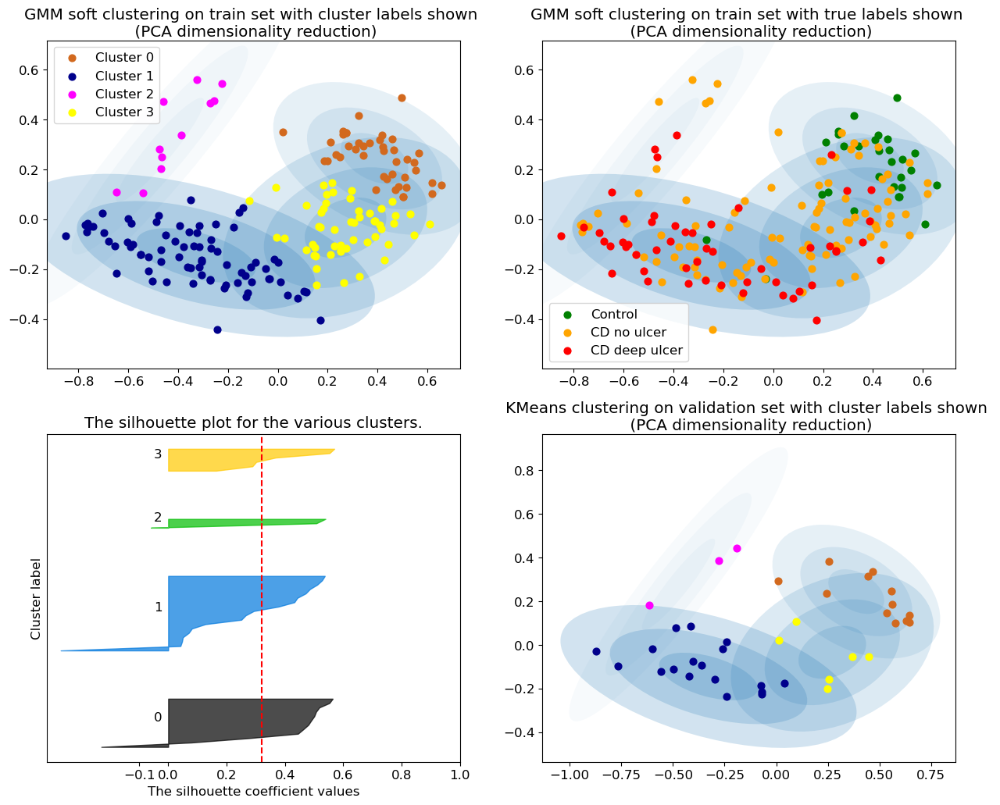

The average silhouette_score is : 0.32120243
Accuracy: 0.38461538461538464
F1 score: 0.3702865761689291


In [195]:

# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

# perplexity = 24
for perplexity in perplexities:
    gmm_pca, X_train_pca, X_test_pca, X_val_pca = fit_gmm(full_pca_dataset, perplexity, num_c)
    print("Perplexity =",perplexity)
    sil, acc, f1 = plot_gmm(gmm_pca, X_train_pca, X_val_pca, train_disease_labels, "PCA", num_c=num_c, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)
    


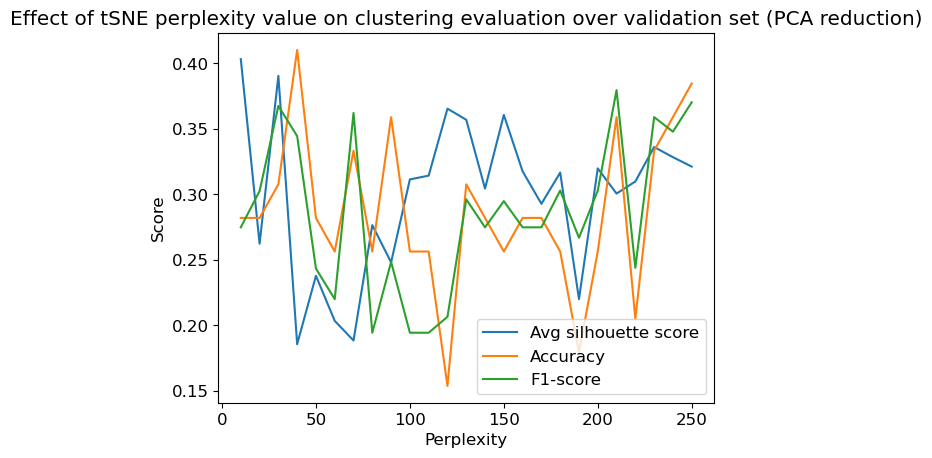

In [196]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "PCA")

#### Testing

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


[2 0 2 2 3 0 2 3 0 2 2 2 2 2 0 2 0 3 0 2 2 2 2 0 2 2 2 0 2 2 3 2 3 0 0 1 0
 2 2]
num_clusters 4
num_clusters 3


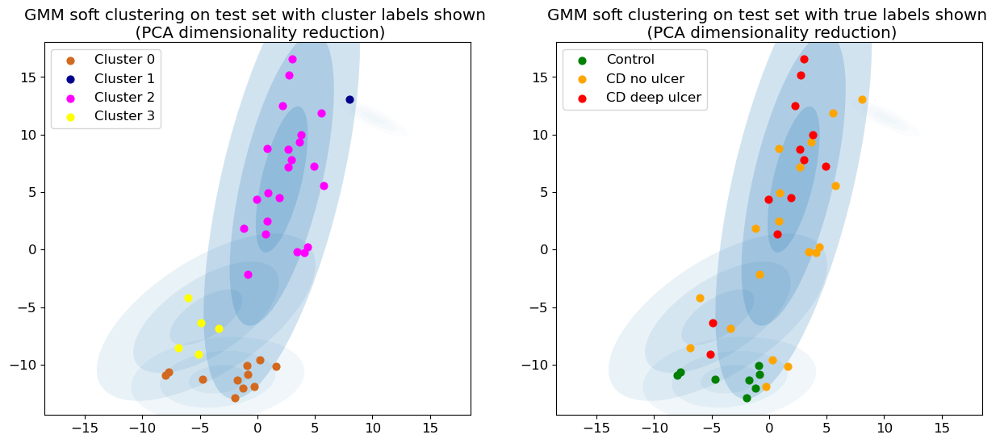

In [197]:
perplexity = 40
gmm_pca, X_train_pca, X_test_pca, X_val_pca = fit_gmm(full_pca_dataset, perplexity, num_c)
gmm_labels_pca = plot_gmm(gmm_pca, X_test_pca, X_val_pca, test_disease_labels, "PCA", num_c=num_c, test=True)


### Fit GMM with autoencoder dimensionality reduction

#### Training

In [198]:
# X_train_ae

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 10
[0 0 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 0 1 3 2 0 0 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 2 2 0 0 3 0 2 1 2 2 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 2 0 0 0 3
 3 0 0 2 0 2 1 2 1 2 2 0 3 2 0 2 3 0 0 2 2 3 0 0 0 3 2 0 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 0 0 1 2 2 1 2 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 0 2 2 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


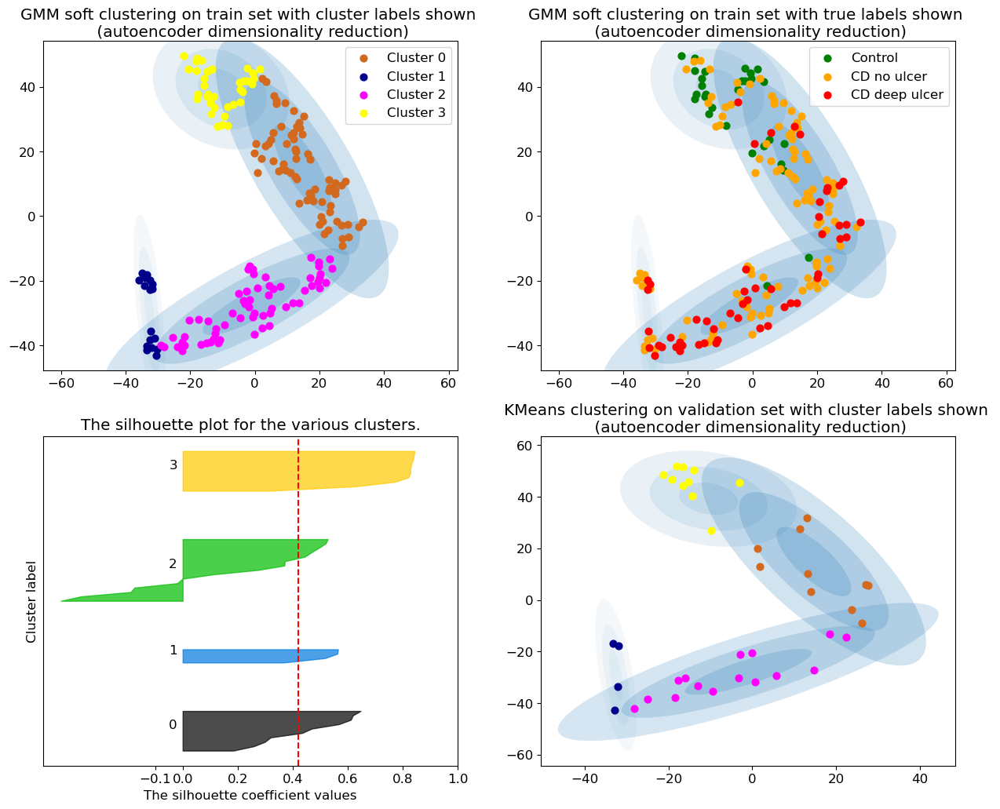

The average silhouette_score is : 0.41901475
Accuracy: 0.28205128205128205
F1 score: 0.3125136971290817


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 20
[0 0 3 0 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 0 2 3 1 0 0 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 1 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 0 0 1 2 0 2 0 3 0 1 0 0 0 3
 3 0 0 1 0 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 1 3 0 1 0 1 3 0
 1 0 1 1 0 0 0 1 0 0 0 1 1 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


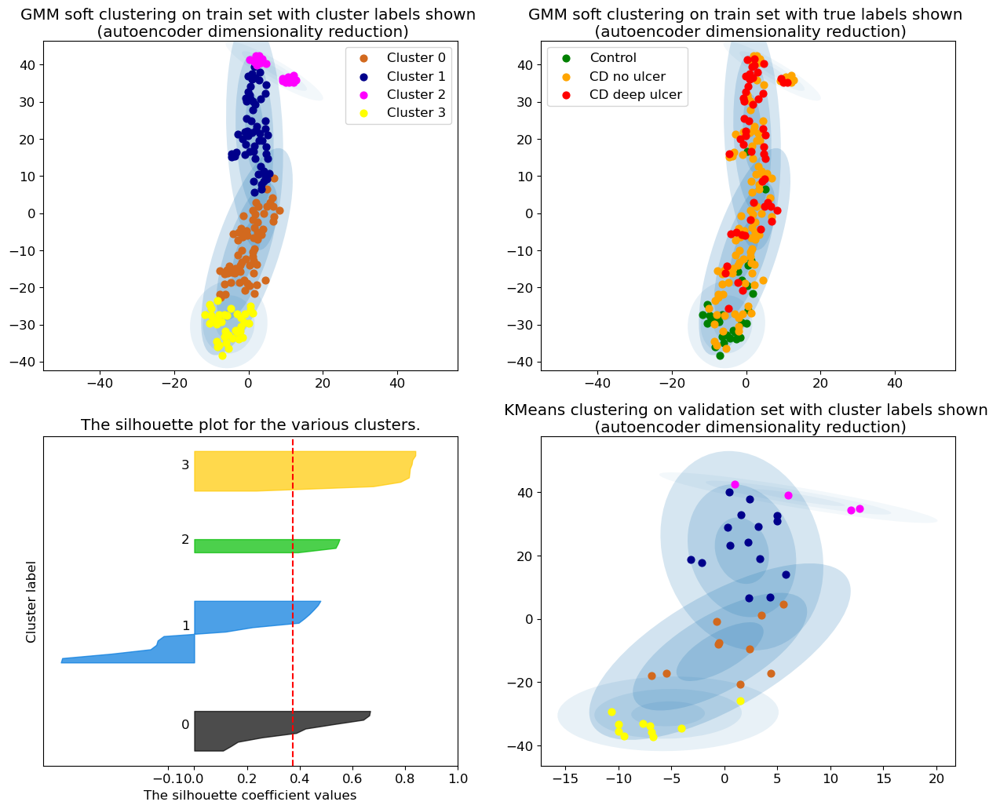

The average silhouette_score is : 0.3738248
Accuracy: 0.20512820512820512
F1 score: 0.25190575190575193


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 30
[0 2 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 0 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 2 0 0 3 0 2 1 2 2 0 0 3 0 2 0 0 2 0 2 1 0 1 0 0 0 2 0 0 0 3
 3 0 0 2 2 2 1 2 1 2 2 0 3 2 0 2 3 0 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 0 2 1 2 2 2 0 0 1 2 2 1 2 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 0 2 2 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


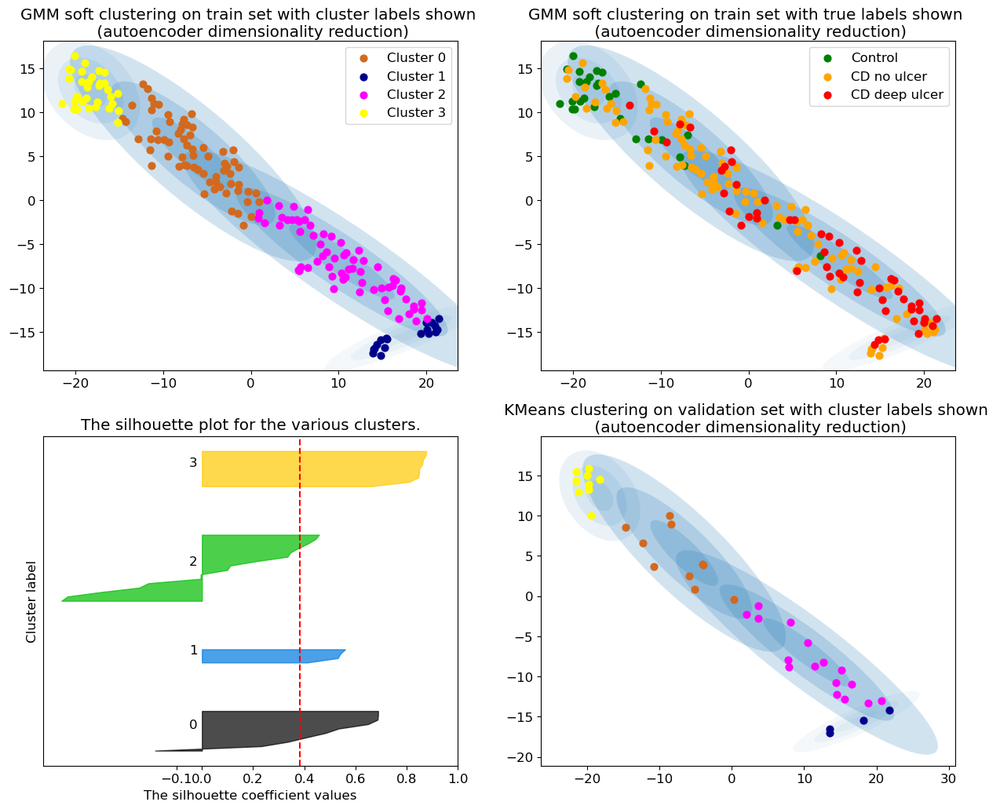

The average silhouette_score is : 0.38250357
Accuracy: 0.3333333333333333
F1 score: 0.3450737296891144


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 40
[0 2 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 0 2 3 3 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 2 0 0 3 0 2 1 2 2 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 2 0 0 0 3
 3 0 0 2 2 2 1 2 1 2 2 0 3 2 3 2 3 3 0 2 2 3 0 0 0 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 2 0 1 2 2 1 2 3 0 2 0 2 3 3
 2 0 2 2 0 0 0 2 0 0 0 2 2 0 0 3 0 2 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


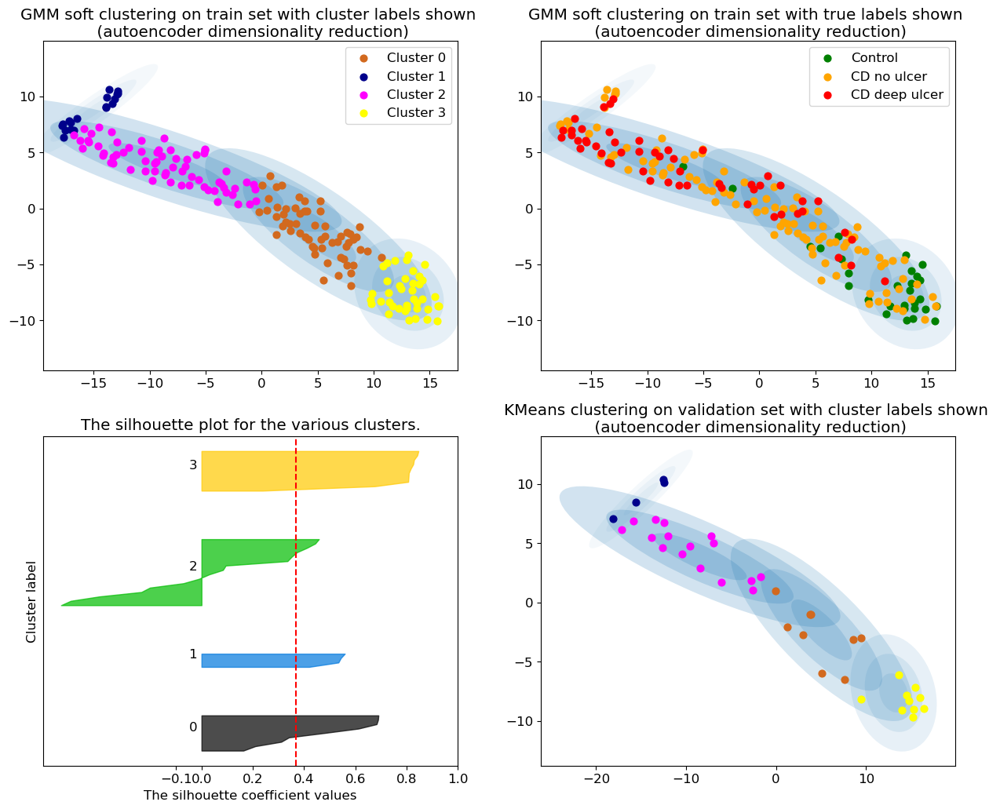

The average silhouette_score is : 0.36743987
Accuracy: 0.3076923076923077
F1 score: 0.32797971259509723


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 50
[0 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 0 2 3 1 0 0 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 1 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 1 0 0 0 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 0 1 3 0
 1 0 1 1 0 0 0 1 0 0 0 1 1 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


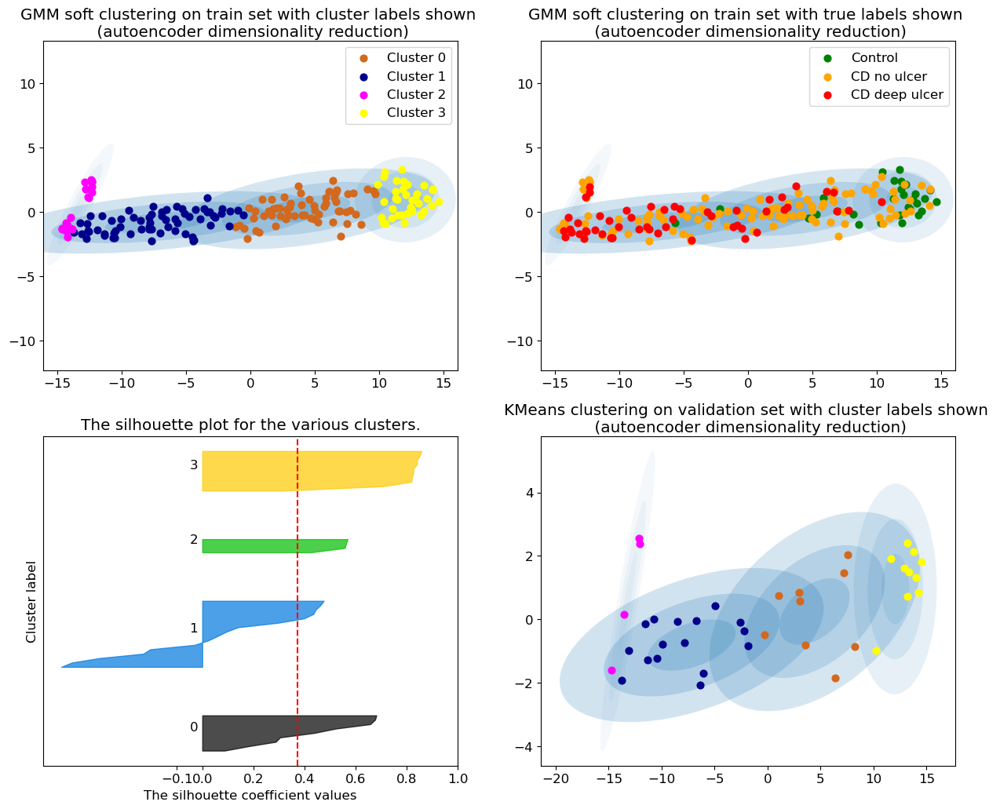

The average silhouette_score is : 0.37270144
Accuracy: 0.20512820512820512
F1 score: 0.24628879892037786


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 60
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 3 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 3 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 3 1 2 1 2 1 1 3 0 1 0 1 0 0 3 1 1 0 3 3 3 0 1 3 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 3
 1 3 1 1 3 3 3 1 3 3 3 1 1 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


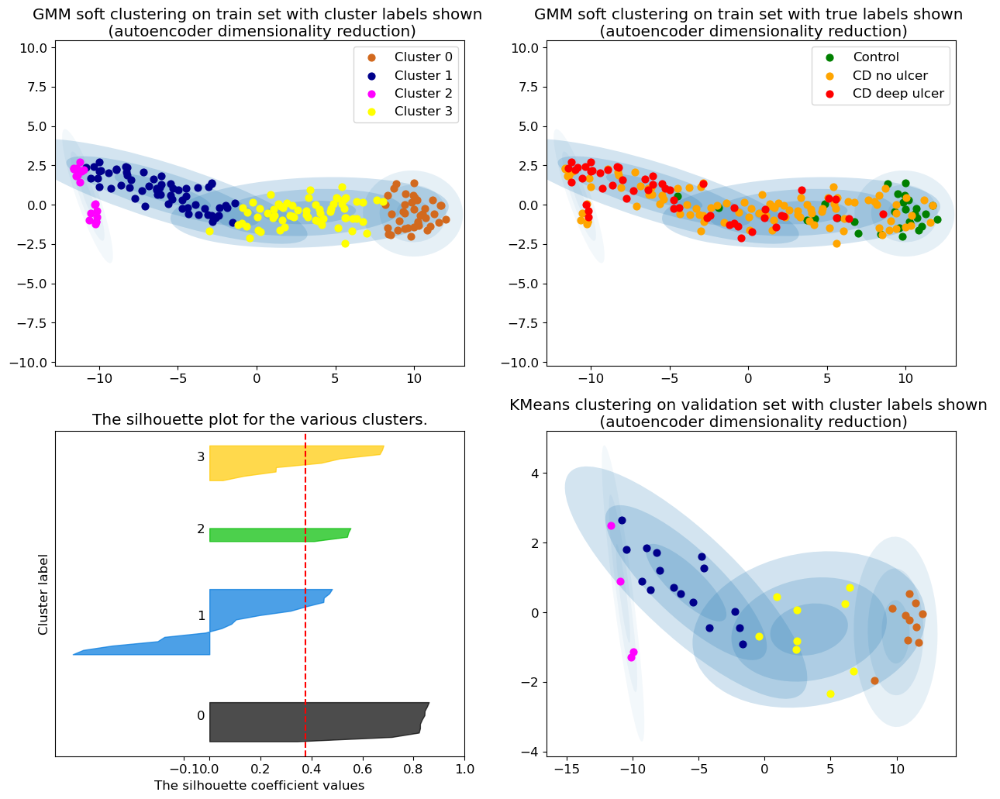

The average silhouette_score is : 0.37588677
Accuracy: 0.3333333333333333
F1 score: 0.3317588843904633


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 70
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 3 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 3 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 1 1 2 1 2 1 1 3 0 1 0 1 0 0 3 1 1 0 3 3 3 0 1 3 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 0
 1 3 1 1 3 3 3 1 3 3 3 1 1 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


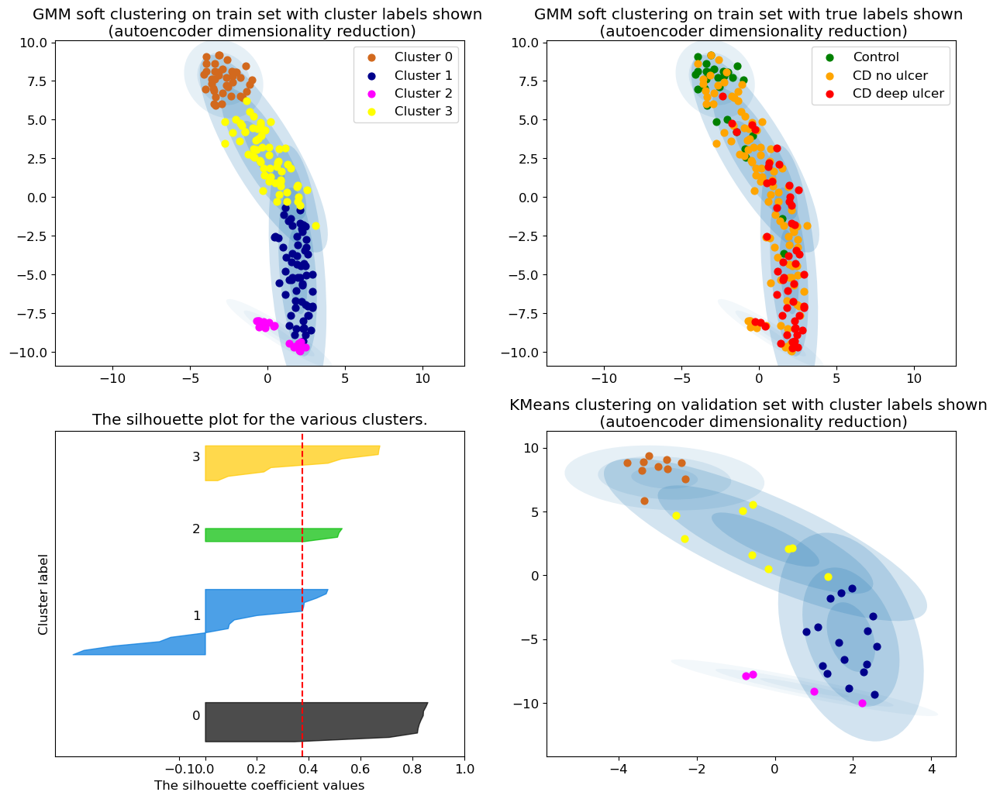

The average silhouette_score is : 0.3749284
Accuracy: 0.3333333333333333
F1 score: 0.3317588843904633


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 80
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 1 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 1 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 3 1 2 1 2 1 1 3 0 1 0 1 0 0 3 1 1 0 3 3 1 0 1 1 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 0
 1 3 1 1 3 3 3 1 3 3 3 1 1 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


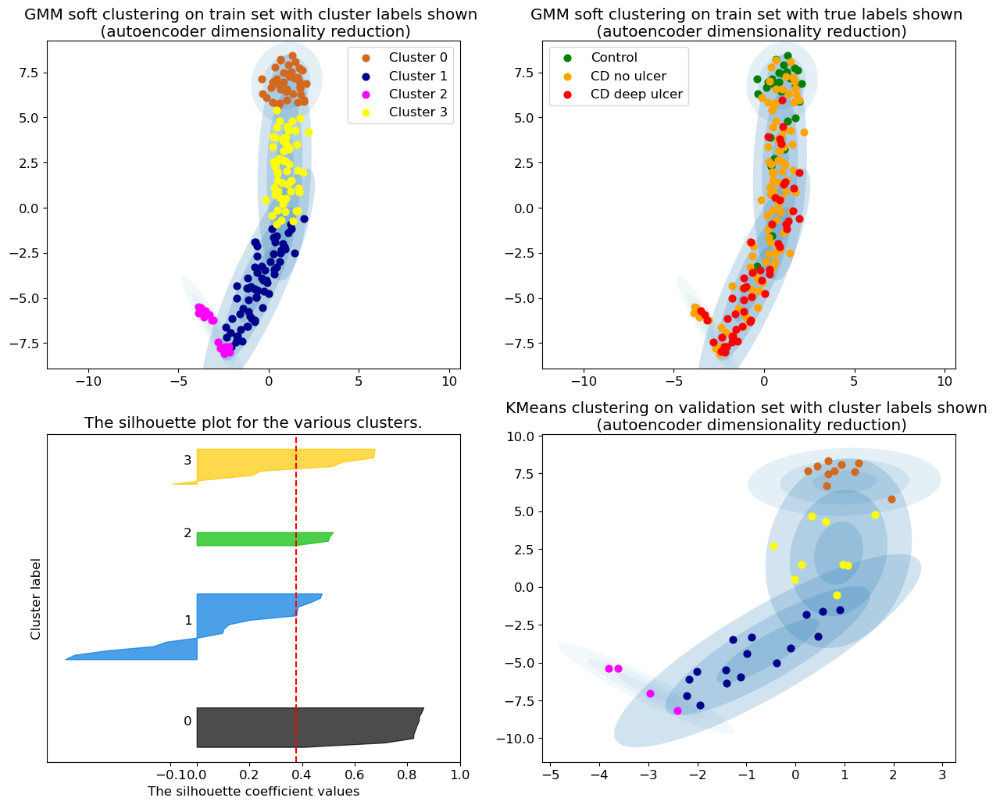

The average silhouette_score is : 0.37663656
Accuracy: 0.3333333333333333
F1 score: 0.3317588843904633


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 90
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 1 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 3 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 1 1 2 1 2 1 1 3 0 1 0 1 0 0 3 1 1 0 3 3 3 0 1 3 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 0
 1 3 1 1 3 3 3 1 3 3 3 1 1 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing th

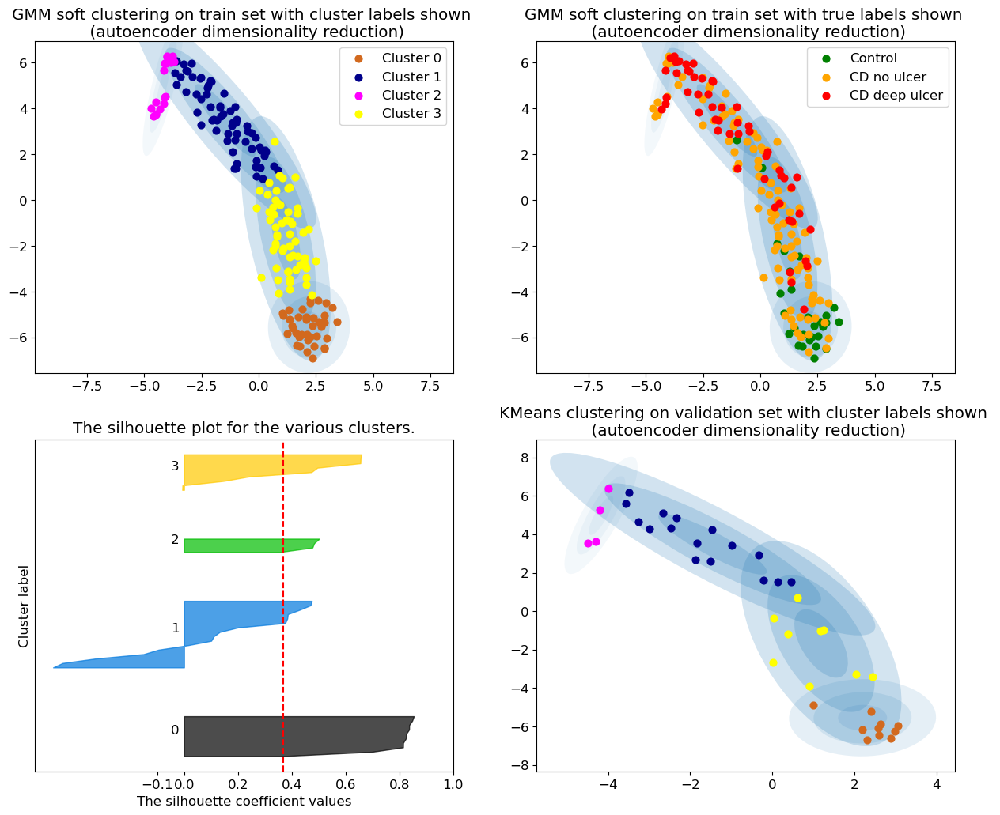

The average silhouette_score is : 0.36949423
Accuracy: 0.3333333333333333
F1 score: 0.3317588843904633


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 100
[0 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 1 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 0 0 1 2 0 2 0 3 0 1 0 0 0 3
 3 0 0 1 1 1 2 1 2 1 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 1 3 0 1 0 1 3 0
 1 0 1 1 0 0 0 1 0 0 0 1 1 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


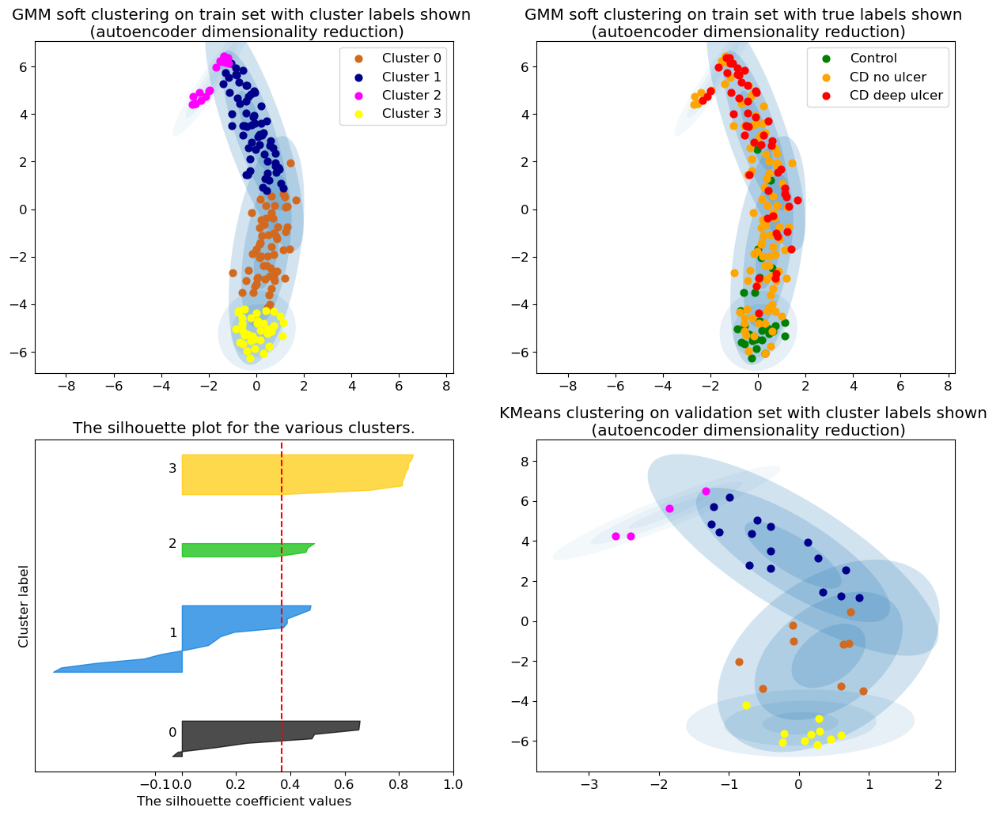

The average silhouette_score is : 0.36677614
Accuracy: 0.20512820512820512
F1 score: 0.24628879892037786


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 110
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 1 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 3 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 3 1 2 1 2 1 1 3 0 1 0 1 0 0 3 1 1 0 3 3 3 0 1 3 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 0
 1 3 1 1 3 3 3 1 3 3 3 1 1 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


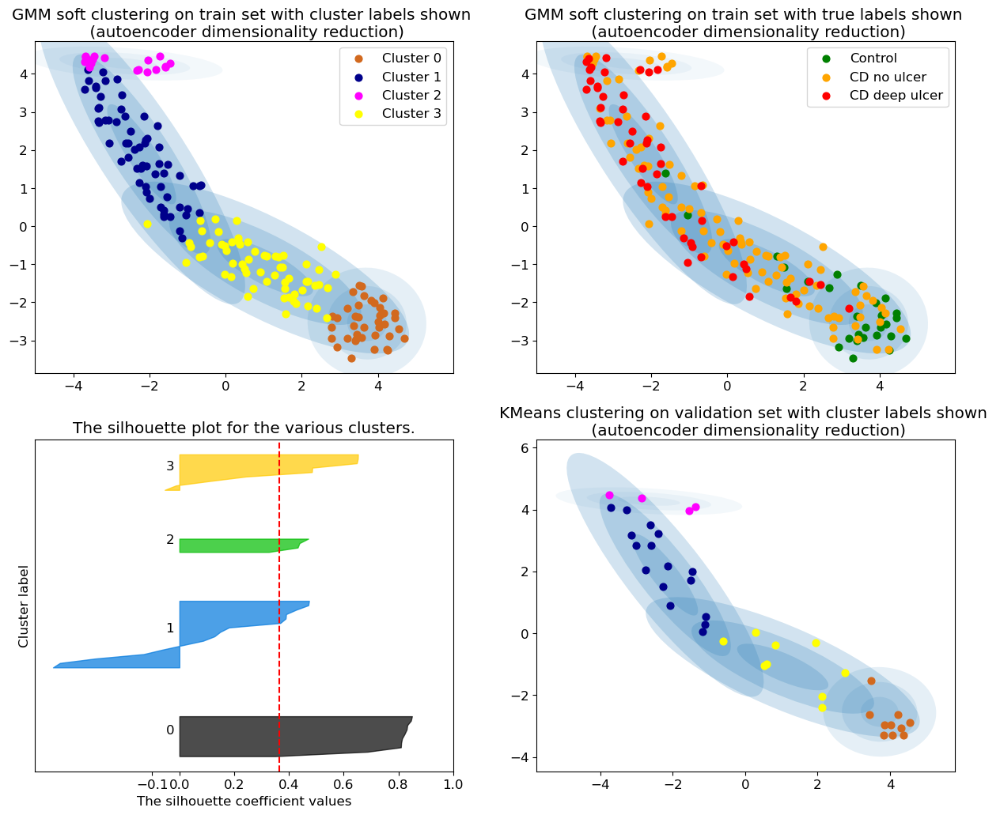

The average silhouette_score is : 0.36422297
Accuracy: 0.3333333333333333
F1 score: 0.3317588843904633


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 120
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 1 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 3 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 3 1 2 1 2 1 1 3 0 1 0 1 0 0 3 1 1 0 3 3 3 0 1 3 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 0
 1 3 1 1 3 3 3 1 3 3 3 1 1 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


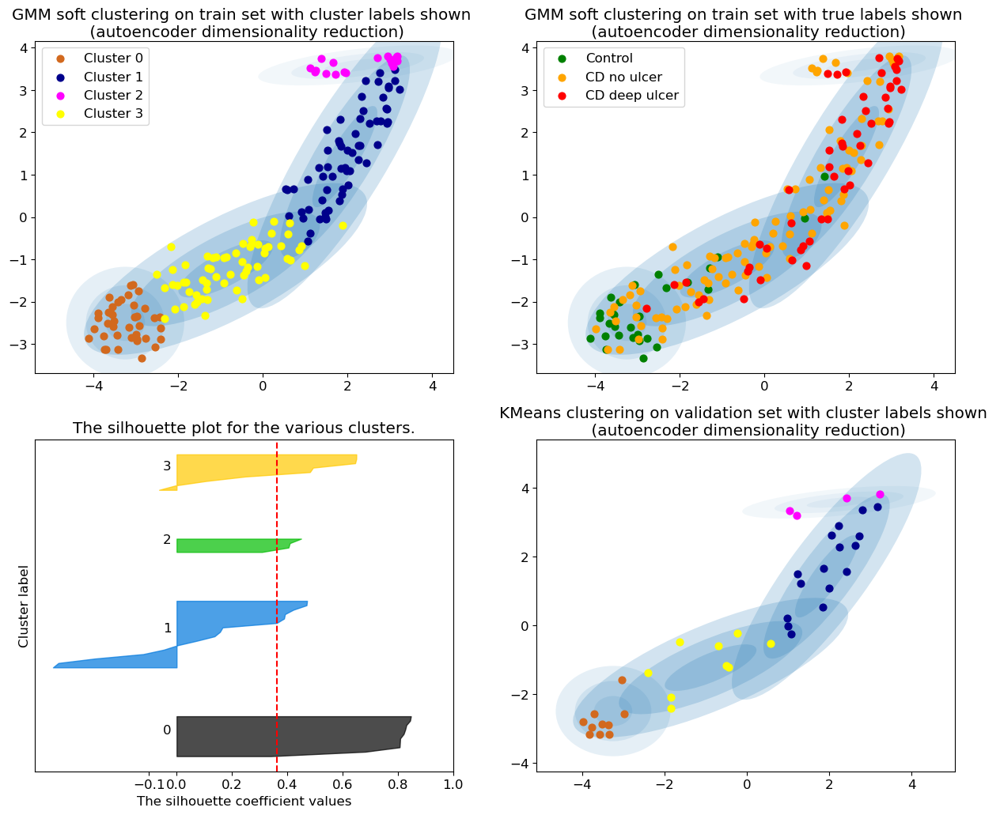

The average silhouette_score is : 0.3616569
Accuracy: 0.3333333333333333
F1 score: 0.3317588843904633


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 130
[3 1 0 1 3 3 1 1 3 1 2 2 0 1 1 2 0 1 0 1 0 0 2 0 1 3 1 0 0 3 1 3 3 3 0 3 0
 3 1 3 1 1 2 2 1 3 3 0 3 1 2 1 1 3 3 0 0 1 3 3 1 3 1 2 3 2 3 0 3 1 3 3 3 0
 0 3 3 1 3 1 2 1 2 2 1 3 0 1 0 1 0 0 3 1 1 0 3 3 1 0 1 3 3 1 2 3 1 0 3 1 1
 1 0 3 3 1 3 1 3 0 2 1 0 1 0 1 2 1 0 1 2 1 1 1 3 3 2 1 1 2 1 0 3 1 3 1 0 0
 1 3 1 1 3 3 3 1 3 3 3 1 2 3 3 0 3 1 3 1 1 0 0 0 3 0 3 0 0 2 1 0 3 3]
num_clusters 4
num_clusters 3


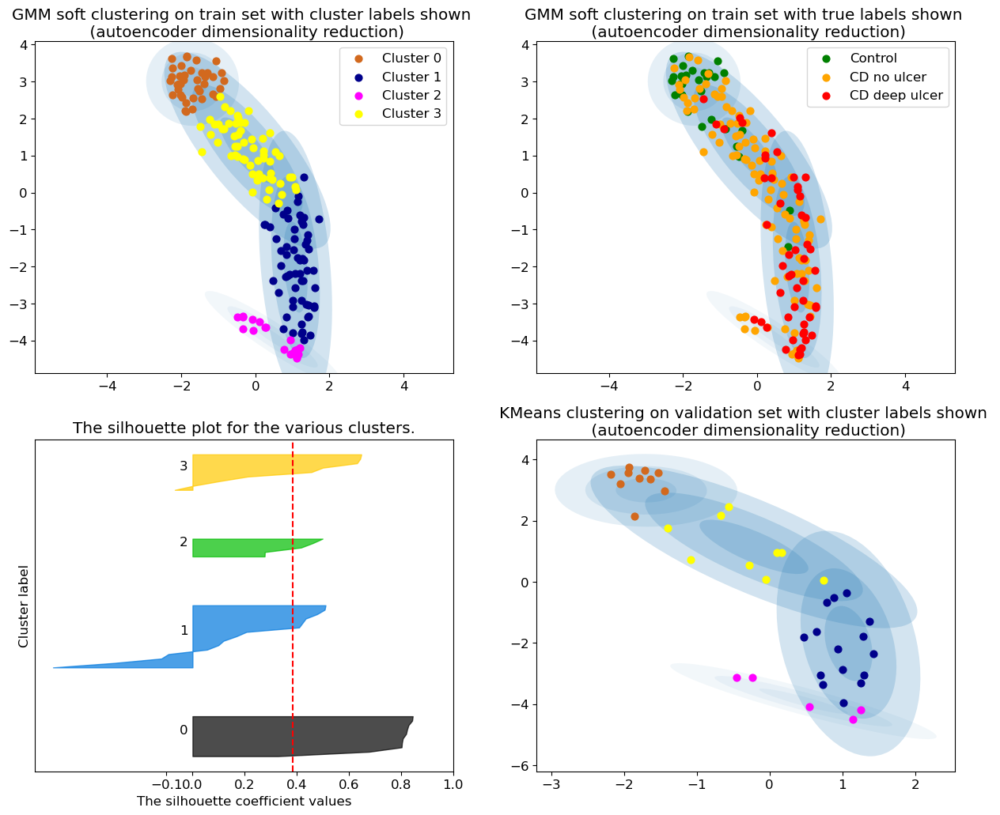

The average silhouette_score is : 0.3847038
Accuracy: 0.358974358974359
F1 score: 0.3713124889595478


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 140
[0 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 0 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 1 0 0 0 3
 3 0 0 1 0 1 2 1 2 2 1 0 3 1 3 1 3 3 0 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 1 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 0 1 2 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


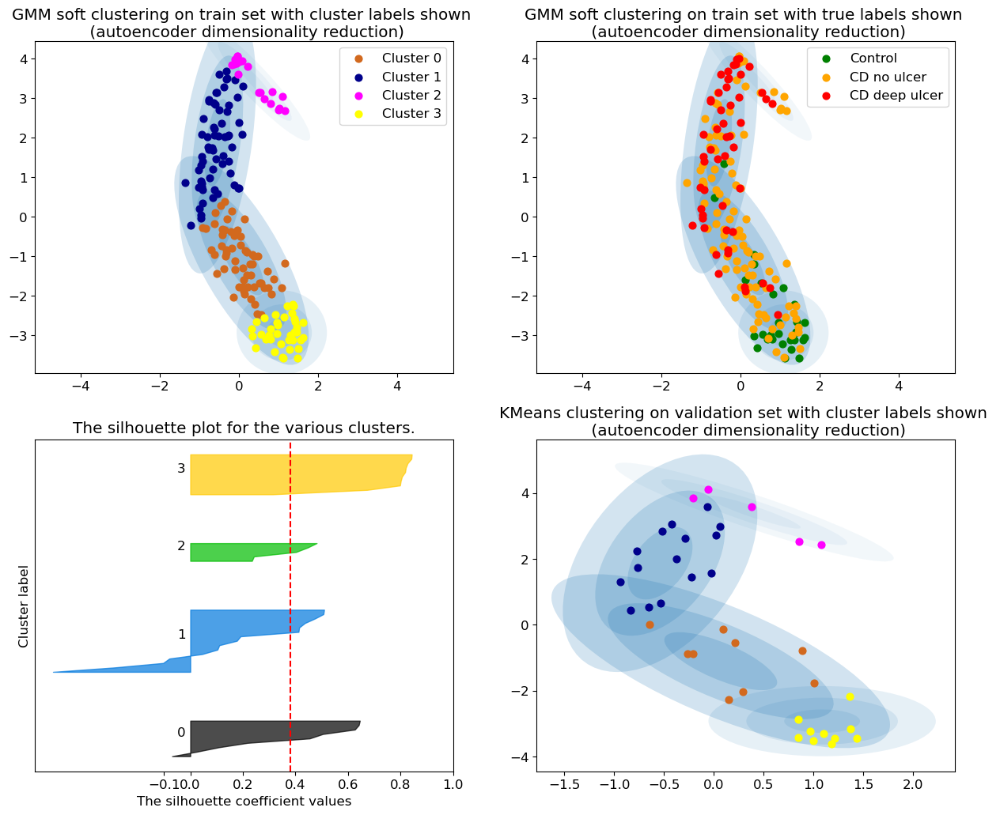

The average silhouette_score is : 0.38151255
Accuracy: 0.23076923076923078
F1 score: 0.28584240348946227


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 150
[0 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 0 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 1 0 0 3 0 1 2 1 1 0 0 3 3 1 1 0 1 0 1 2 0 2 0 3 0 1 0 0 0 3
 3 0 0 1 1 1 2 1 2 2 1 0 3 1 3 1 3 3 0 1 1 3 0 0 0 3 1 0 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 1 0 2 1 1 2 1 3 0 1 0 1 3 3
 1 0 1 1 0 0 0 1 0 0 0 1 2 0 0 3 0 2 0 1 1 3 3 3 0 3 0 3 3 2 1 3 1 0]
num_clusters 4
num_clusters 3


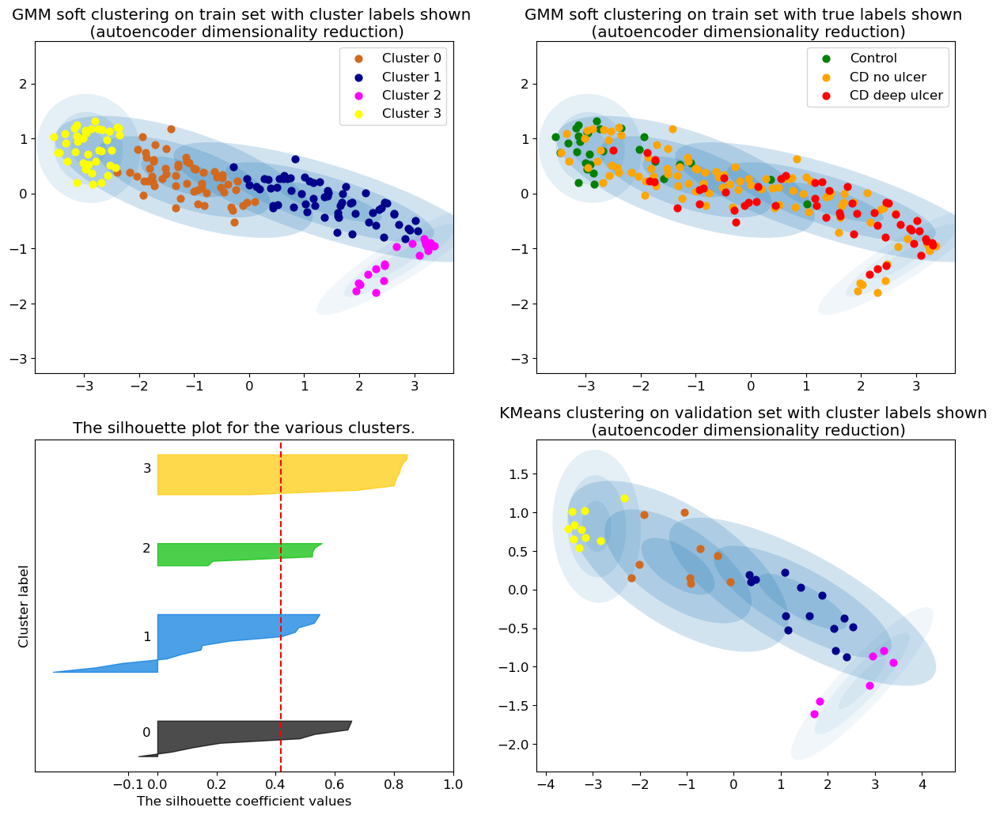

The average silhouette_score is : 0.41699728
Accuracy: 0.20512820512820512
F1 score: 0.2564102564102564


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 160
[0 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 0 0 0 3 0 1 2 1 1 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 0 0 0 0 3
 3 0 0 1 0 1 2 1 2 2 1 0 3 1 3 1 3 3 0 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 0 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 0 1 2 0 0 3 0 1 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


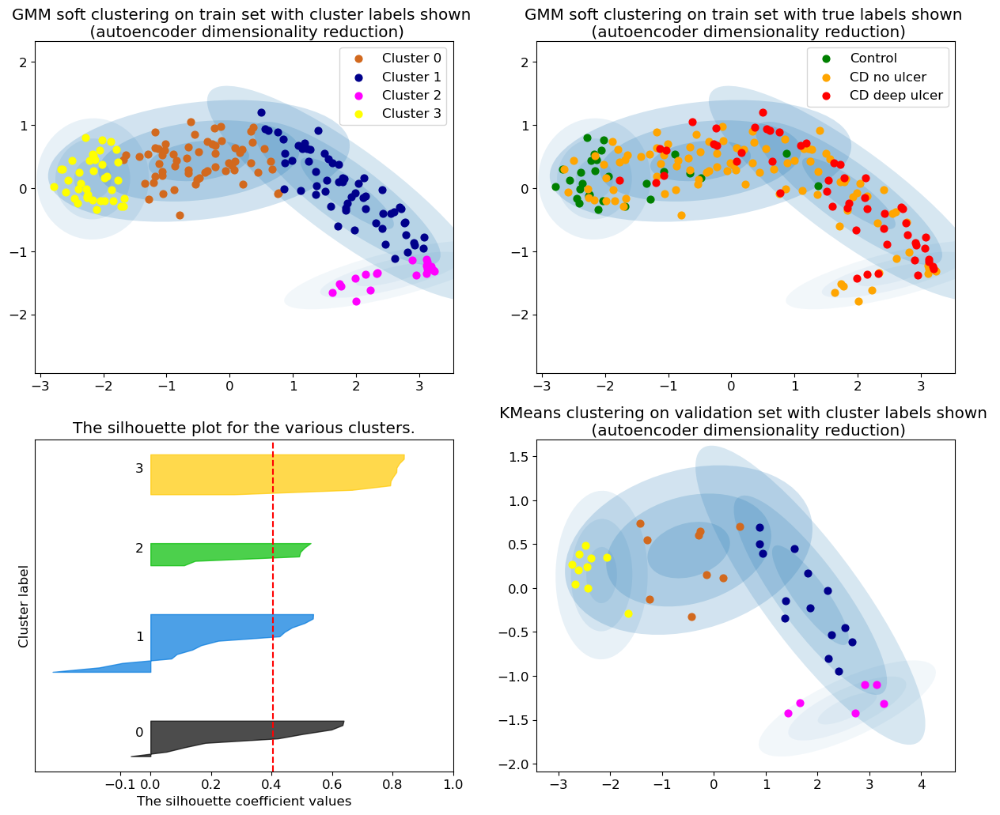

The average silhouette_score is : 0.40591452
Accuracy: 0.20512820512820512
F1 score: 0.2564102564102564


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 170
[0 1 3 1 0 0 1 1 0 1 2 2 3 1 1 2 3 1 3 1 3 3 2 3 1 0 1 3 3 0 1 0 0 0 3 0 3
 0 1 0 1 1 2 2 0 0 0 3 0 1 2 1 0 0 0 3 3 1 0 0 1 0 1 2 0 2 0 3 0 0 0 0 0 3
 3 0 0 1 0 1 2 1 2 2 1 0 3 1 3 1 3 3 0 1 1 3 0 0 1 3 1 1 0 1 2 0 1 3 0 1 1
 1 3 0 0 1 0 1 0 3 2 1 3 1 3 1 2 1 3 1 2 1 1 1 0 0 2 1 1 2 0 3 0 1 1 1 3 0
 1 0 1 1 0 0 0 1 0 0 0 1 2 0 0 3 0 2 0 1 1 3 3 3 0 3 0 3 3 2 1 3 0 0]
num_clusters 4
num_clusters 3


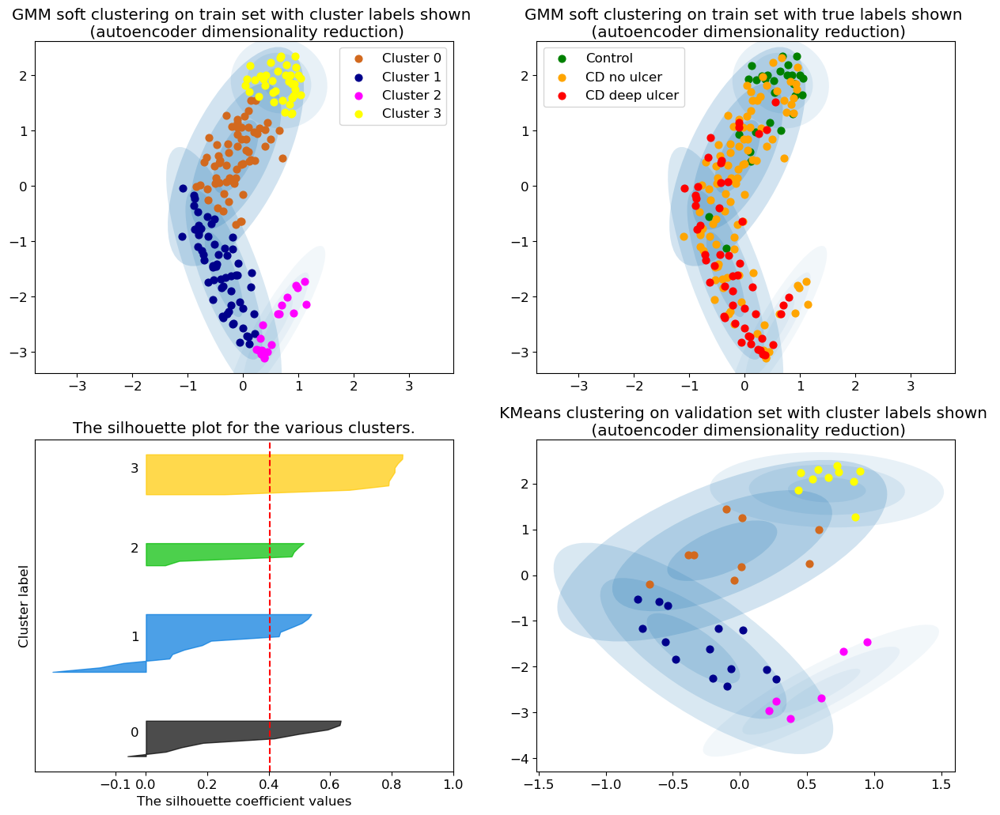

The average silhouette_score is : 0.4022866
Accuracy: 0.20512820512820512
F1 score: 0.2564102564102564


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 180
[0 3 2 3 0 0 3 3 0 3 1 1 2 3 3 1 2 3 2 3 2 2 1 2 3 0 3 2 2 0 3 0 0 0 2 0 2
 0 3 0 3 3 1 1 0 0 0 2 0 3 1 3 0 0 0 2 2 3 0 0 3 0 3 1 0 1 0 2 0 0 0 0 0 2
 2 0 0 3 0 3 1 3 1 1 3 0 2 3 2 3 2 2 0 3 3 2 0 0 3 2 3 3 0 3 1 0 3 2 0 3 3
 3 2 0 0 3 0 3 0 2 1 3 2 3 2 3 1 3 2 3 1 3 3 3 0 0 1 3 3 1 0 2 0 3 0 3 2 0
 3 0 3 3 0 0 0 3 0 0 0 3 1 0 0 2 0 1 0 3 3 2 2 2 0 2 0 2 2 1 3 2 0 0]
num_clusters 4
num_clusters 3


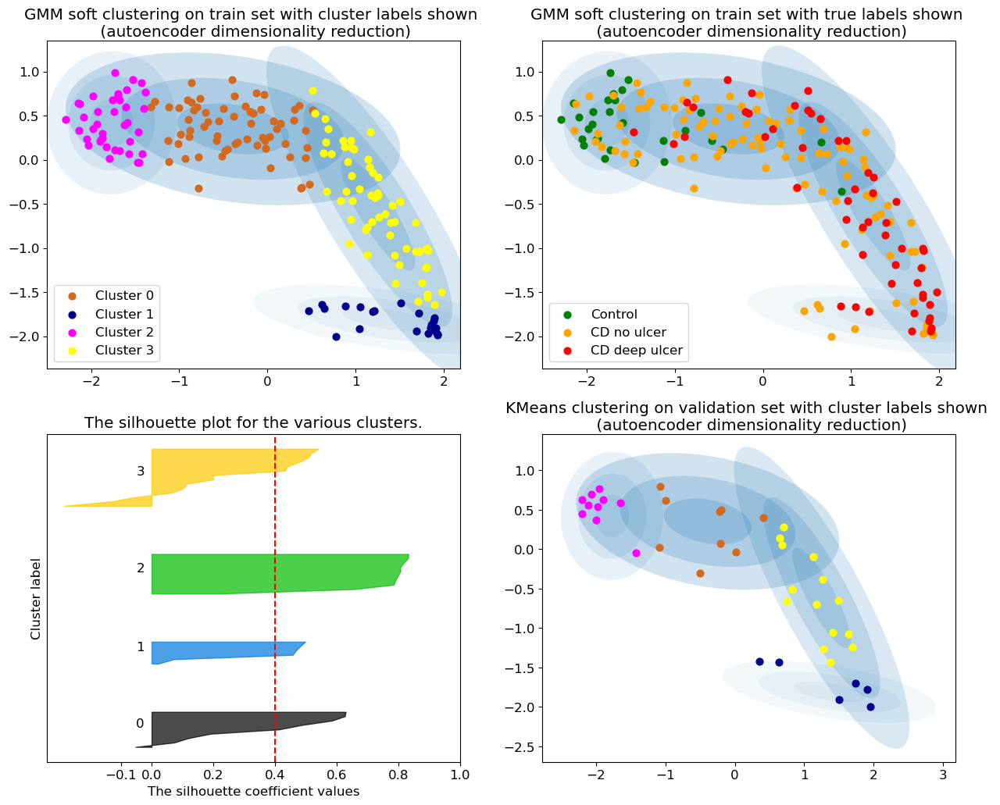

The average silhouette_score is : 0.3991971
Accuracy: 0.1282051282051282
F1 score: 0.18914418914418915


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 190
[0 2 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 0 2 3 3 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 0 0 0 3 0 2 1 2 0 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 0 0 0 0 3
 3 0 0 2 0 2 1 2 1 1 2 0 3 2 0 2 3 3 0 2 2 3 0 0 2 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 0 0 1 2 2 1 0 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 0 2 1 0 0 3 0 1 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


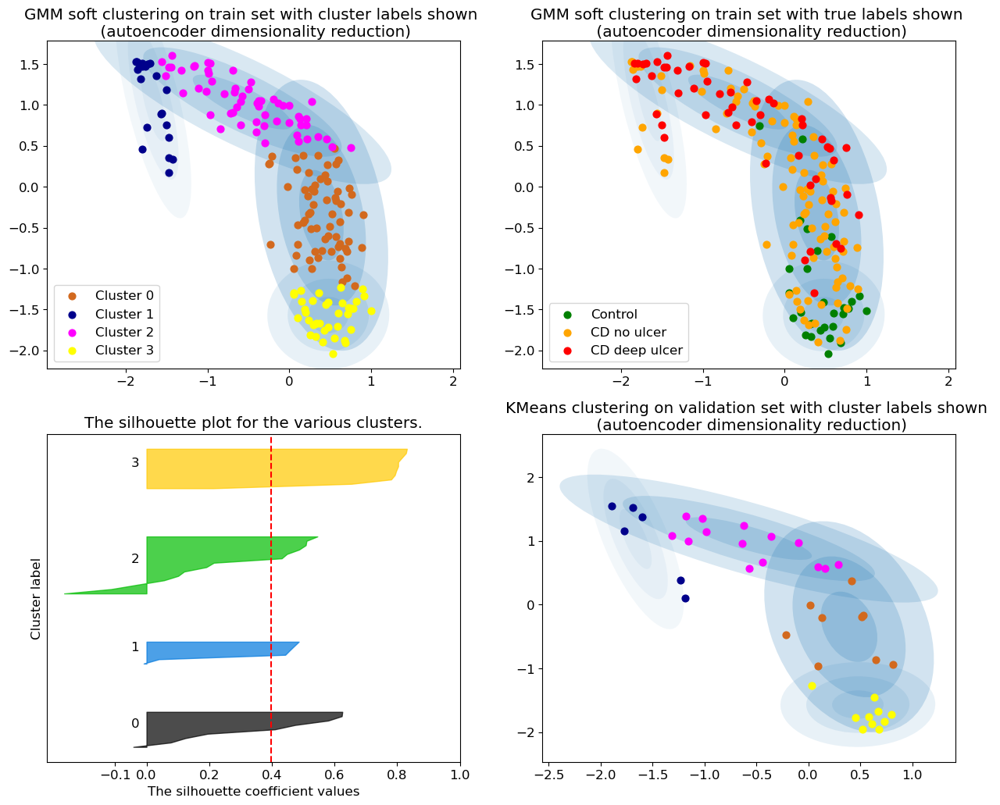

The average silhouette_score is : 0.3968735
Accuracy: 0.3076923076923077
F1 score: 0.3505212735981967


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 200
[0 2 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 0 0 0 3 0 2 1 2 0 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 0 0 0 0 3
 3 0 0 2 0 2 1 2 1 1 2 0 3 2 0 2 3 3 0 2 2 3 0 0 2 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 0 0 1 2 2 1 0 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 0 2 1 0 0 3 0 1 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


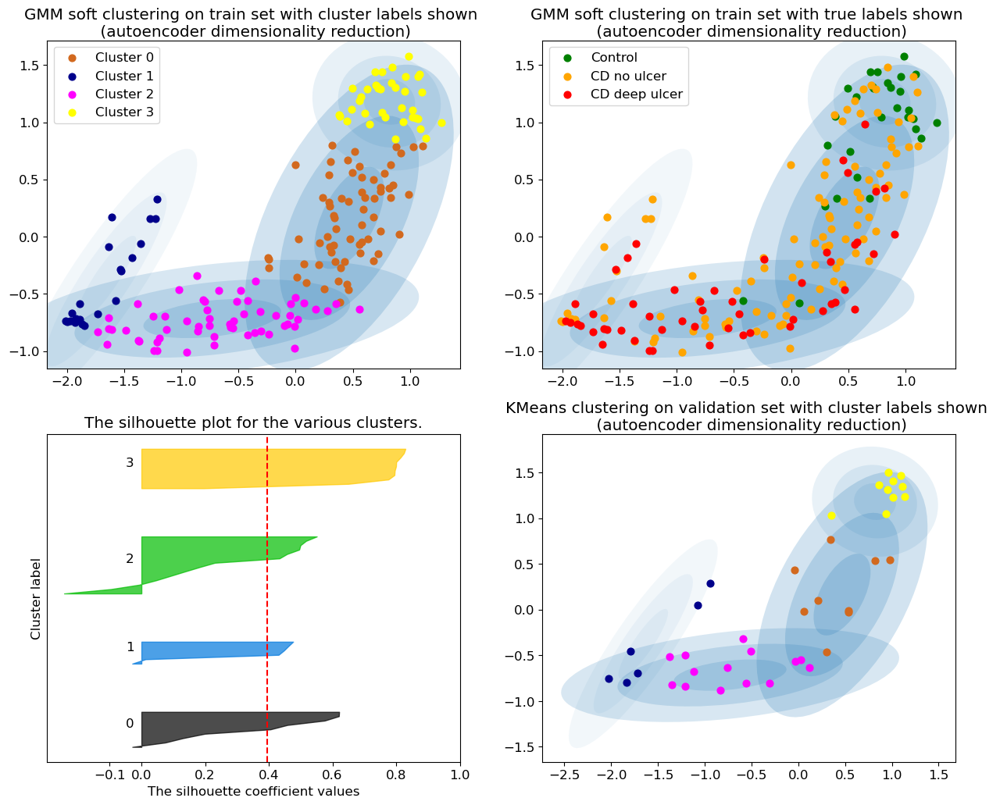

The average silhouette_score is : 0.39554358
Accuracy: 0.3076923076923077
F1 score: 0.3505212735981967


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 210
[0 2 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 0 0 0 3 0 2 1 2 0 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 0 0 0 0 3
 3 0 0 2 0 2 1 2 1 1 2 0 3 2 0 2 3 3 0 2 2 3 0 0 2 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 0 0 1 2 2 1 0 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 0 2 1 0 0 3 0 1 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


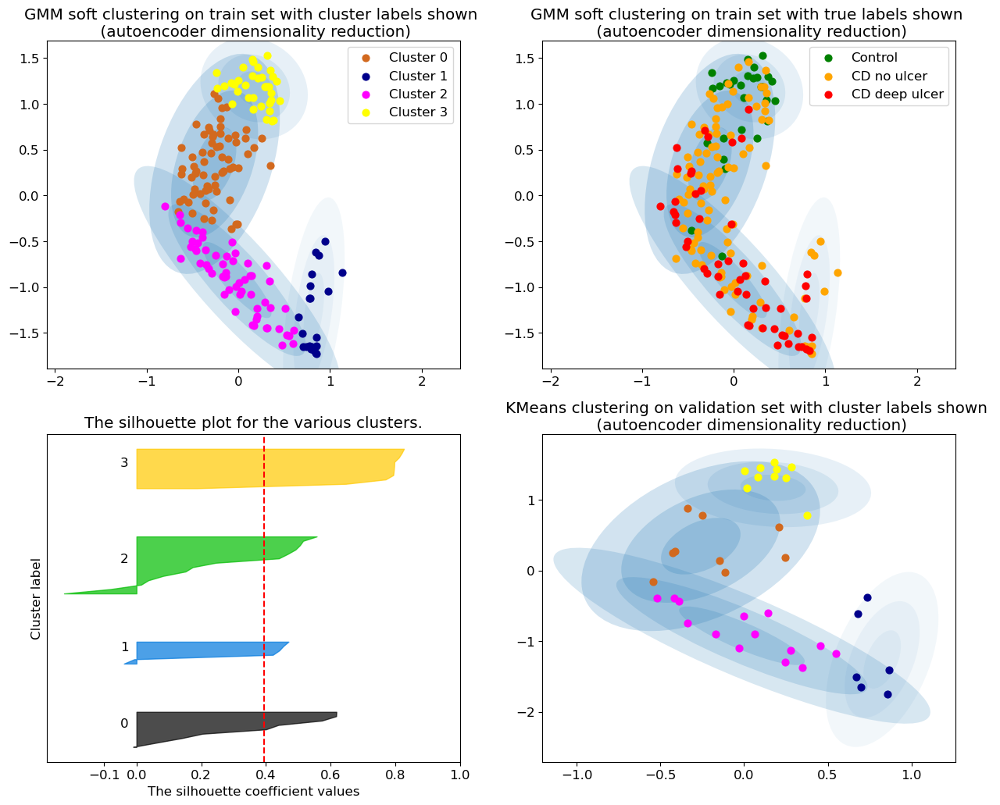

The average silhouette_score is : 0.3951281
Accuracy: 0.3076923076923077
F1 score: 0.3505212735981967


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 220
[0 2 3 2 0 0 2 2 0 2 1 1 3 2 2 1 3 2 3 2 3 3 1 3 2 0 2 3 0 0 2 0 0 0 3 0 3
 0 2 0 2 2 1 1 0 0 0 3 0 2 1 2 2 0 0 3 3 2 0 0 2 0 2 1 0 1 0 3 0 0 0 0 0 3
 3 0 0 2 0 2 1 2 1 1 2 0 3 2 0 2 3 3 0 2 2 3 0 0 2 3 2 2 0 2 1 0 2 3 0 2 2
 2 3 0 0 2 0 2 0 3 1 2 3 2 3 2 1 2 3 2 1 2 2 2 0 0 1 2 2 1 0 3 0 2 0 2 3 0
 2 0 2 2 0 0 0 2 0 0 0 2 1 0 0 3 0 1 0 2 2 3 3 3 0 3 0 3 3 1 2 3 0 0]
num_clusters 4
num_clusters 3


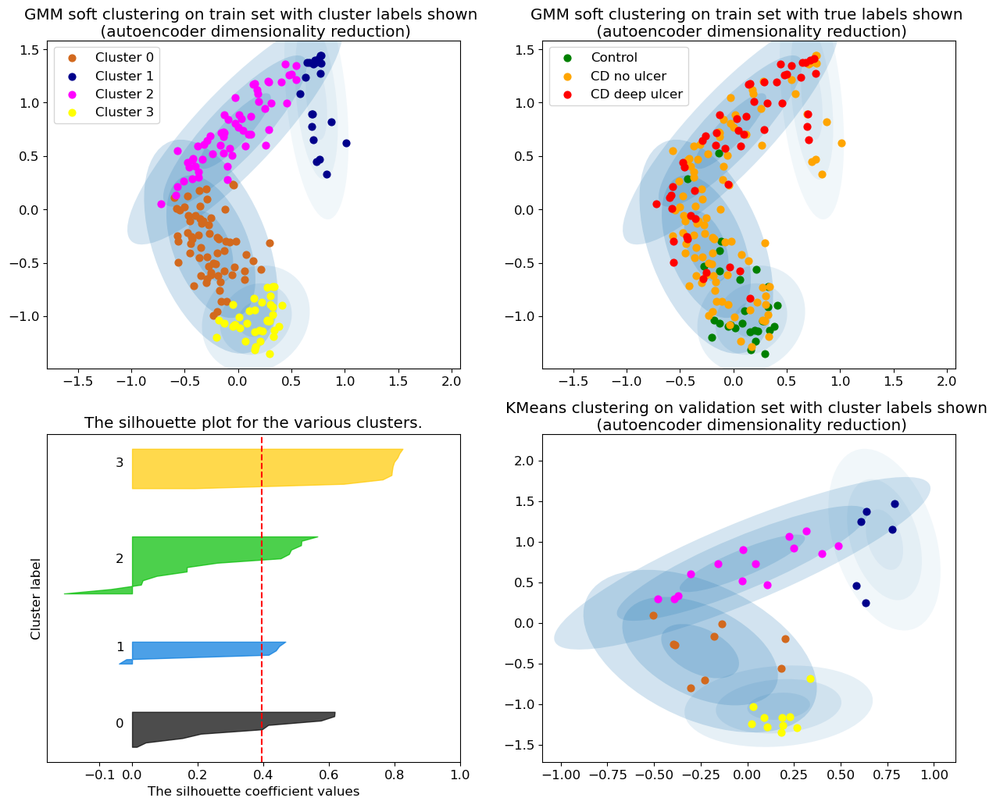

The average silhouette_score is : 0.39629334
Accuracy: 0.3076923076923077
F1 score: 0.3505212735981967


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 230
[2 3 2 3 2 2 3 3 2 3 1 1 0 3 3 1 0 3 0 3 0 2 1 0 3 2 2 0 2 2 3 2 2 2 0 2 0
 2 3 2 3 3 1 1 3 2 2 0 2 3 1 3 3 2 2 0 0 3 2 2 2 2 3 1 2 1 2 0 2 3 2 2 0 0
 0 2 0 3 2 3 1 3 1 1 3 2 0 3 2 3 0 2 2 3 3 0 2 2 3 2 3 2 0 3 1 2 3 0 2 3 3
 3 0 2 0 3 2 3 2 0 1 3 0 3 0 3 1 3 0 3 1 3 3 3 2 2 1 3 3 1 3 0 0 3 2 3 0 2
 3 2 3 3 2 2 2 3 2 2 0 3 1 2 2 0 2 1 2 3 3 0 0 0 2 0 2 2 0 1 3 0 2 2]
num_clusters 4
num_clusters 3


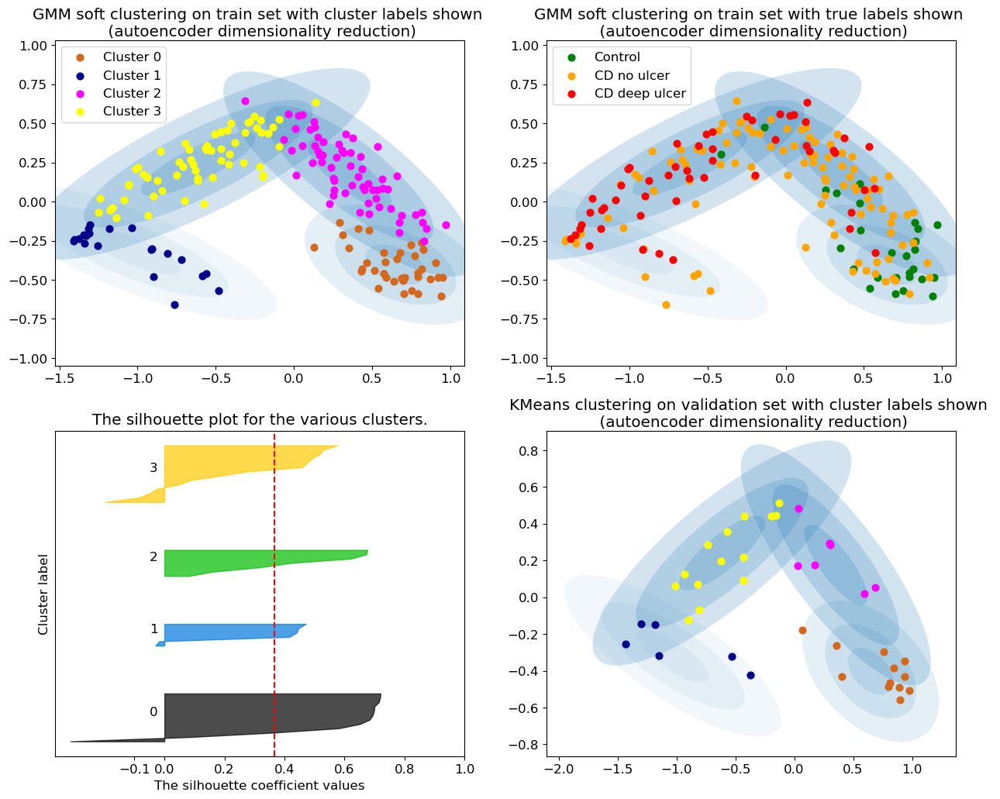

The average silhouette_score is : 0.36565813
Accuracy: 0.2564102564102564
F1 score: 0.26897560643690677


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Perplexity = 240
[2 3 0 3 2 2 3 3 2 3 1 1 0 3 3 1 0 3 0 3 0 0 1 0 3 2 3 0 2 2 3 2 2 2 0 2 0
 2 3 2 3 3 1 1 3 2 2 0 2 3 1 3 3 2 2 0 0 3 2 2 3 2 3 1 2 1 2 0 2 3 2 2 0 0
 0 2 0 3 2 3 1 3 1 1 3 2 0 3 2 3 0 2 2 3 3 0 2 2 3 2 3 2 0 3 1 2 3 0 2 3 3
 3 0 2 0 3 2 3 2 0 1 3 0 3 0 3 1 3 0 3 1 3 3 3 2 2 1 3 3 1 3 0 0 3 2 3 0 2
 3 2 3 3 2 2 2 3 2 2 0 3 1 2 2 0 2 1 2 3 3 0 0 0 2 0 2 2 0 1 3 0 2 2]
num_clusters 4
num_clusters 3


C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_val[gmm_val_labels==i, 0], X_val[gmm_val_labels==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing th

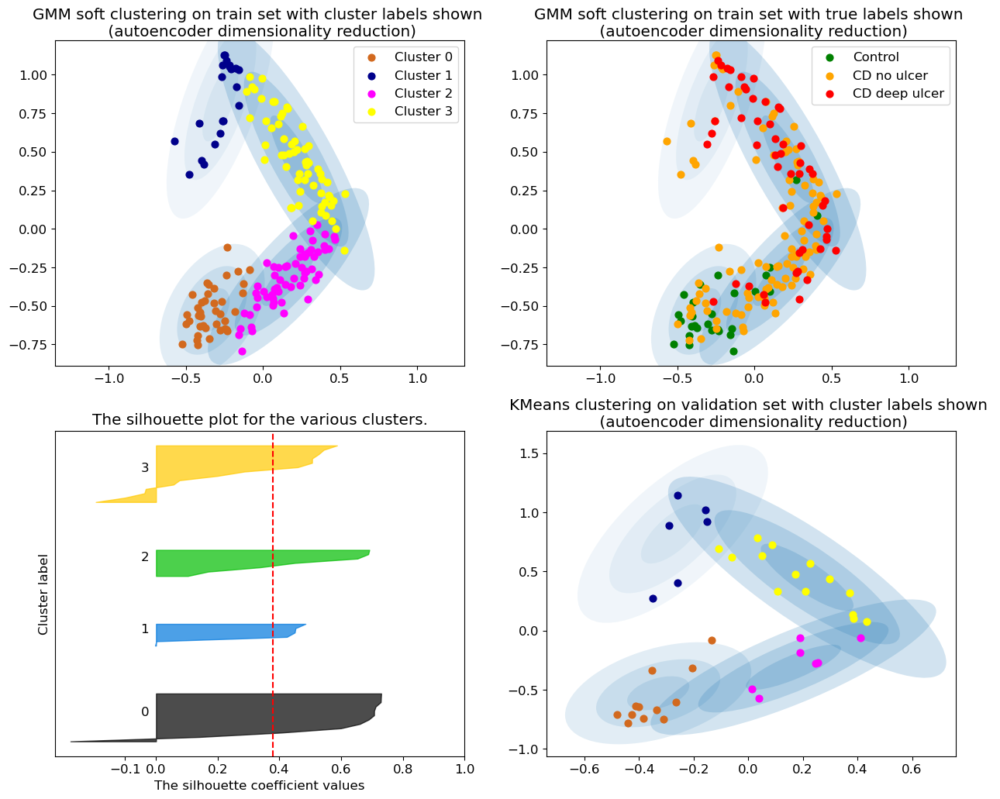

The average silhouette_score is : 0.37963307
Accuracy: 0.2564102564102564
F1 score: 0.26897560643690677


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:88: UserWarning: No data for colormapping pr

Perplexity = 250
[2 1 0 1 2 2 1 1 2 1 3 3 0 3 1 3 0 1 0 1 0 0 3 0 1 2 1 0 2 2 1 2 2 2 0 2 0
 2 3 2 1 1 3 3 1 2 2 0 2 1 3 1 1 2 2 0 0 1 2 2 1 2 1 3 2 3 2 0 2 1 2 2 0 0
 0 2 0 1 1 1 3 1 3 3 1 2 0 1 2 1 0 0 2 1 1 0 2 2 1 2 1 2 0 3 3 2 1 0 2 1 1
 1 0 2 0 1 2 1 2 0 3 1 0 1 0 1 3 1 0 1 3 1 1 1 2 2 3 1 1 3 1 0 0 1 2 1 0 0
 1 2 1 1 2 2 2 3 2 2 0 1 3 2 2 0 2 3 2 1 1 0 0 0 2 0 2 0 0 3 1 0 2 2]
num_clusters 4
num_clusters 3


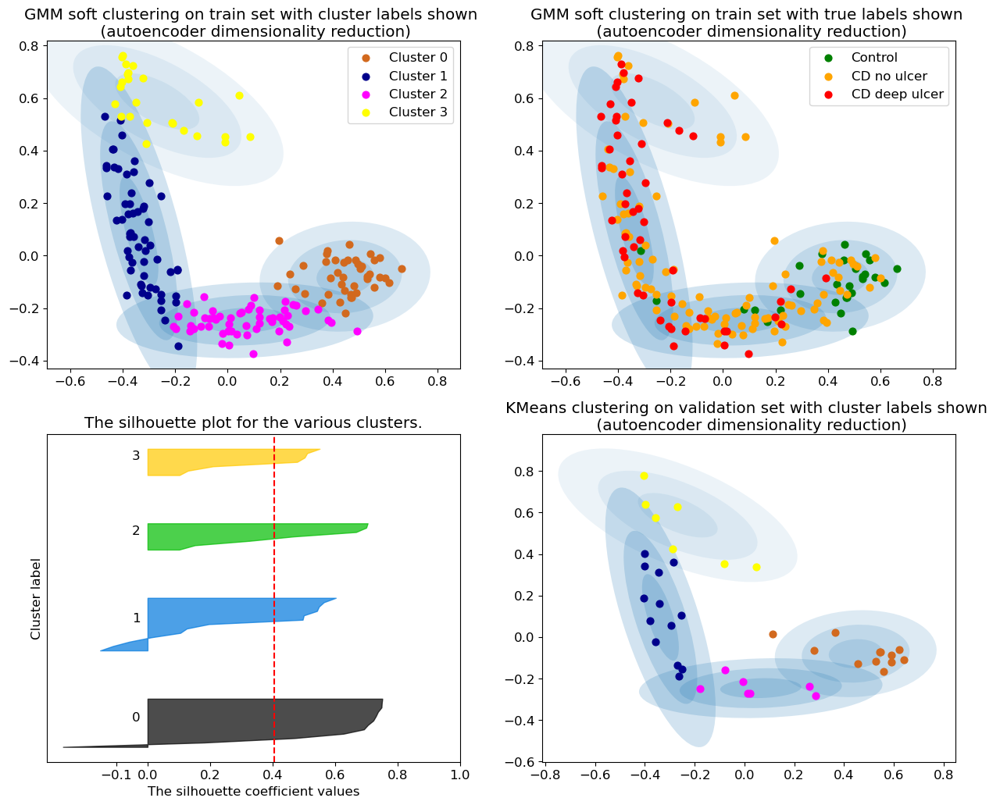

The average silhouette_score is : 0.40575725
Accuracy: 0.28205128205128205
F1 score: 0.2689756064369067


In [199]:
# perplexities = [10, 20, 50, 70]
# perplexities = [10, 20, 50, 70, 100, 150, 200, 250]
perplexities = np.arange(0, 251, 10)[1:]
sil_scores = []
acc_scores = []
f1_scores = []

# perplexity = 24
for perplexity in perplexities:
    gmm_ae, X_train_ae, X_test_ae, X_val_ae = fit_gmm(full_ae_dataset, perplexity, num_c)
    print("Perplexity =",perplexity)
    sil, acc, f1 = plot_gmm(gmm_ae, X_train_ae, X_val_ae, train_disease_labels, "autoencoder", num_c=num_c, plot_sil=True)
    sil_scores.append(sil)
    acc_scores.append(acc)
    f1_scores.append(f1)



    

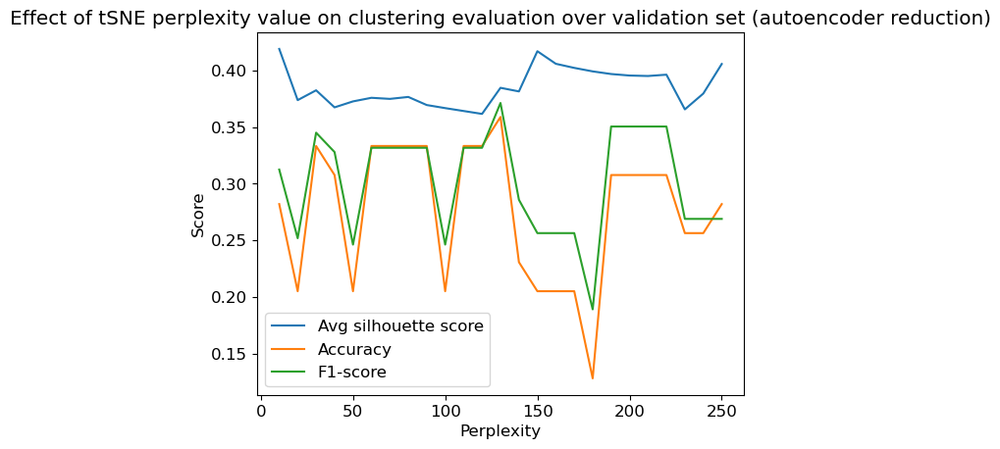

In [200]:
plot_val_scores(sil_scores, acc_scores, f1_scores, "autoencoder")

### Testing

In [201]:

# def test_gmm_prediction_ae(x_test_scaled, train_disease_labels, test_disease_labels):
#     # preprocessing
    
    
#     num_c = 4
#     full_dataset = full_ds.copy()
#     split_pt = len(full_dataset) - len(x_test_scaled)
#     full_dataset.iloc[split_pt:,:] = x_test_scaled
# #     print("split_pt:",split_pt)

#     with open("data/d_labels", "rb") as fp:   # Unpickling
#         full_disease_labels = pickle.load(fp)
# #     full_disease_labels = np.concatenate([train_disease_labels, val_disease_labels, test_disease_labels])
#     train_disease_labels = full_disease_labels[:split_pt]
#     test_disease_labels = full_disease_labels[split_pt:]
    
#     full_ae_dataset = ae_encode_dataset(full_dataset)
#     perplexity = 120
#     gmm, X_train, X_test, X_val = fit_gmm(full_ae_dataset, perplexity, num_c, split_pt=split_pt) # tSNE -> 2D pts

# #     print("X_train:",X_train.shape)
# #     print("X_test:",X_test.shape)
# #     print("test_disease_labels:",test_disease_labels.shape)
# #     print("train_disease_labels:",train_disease_labels.shape)
    
    
#     plot_gmm(gmm, X_test, X_val, test_disease_labels, "autoencoder", num_c=num_c, test=True)
    
#     test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test,train_disease_labels)
# #     cls, probs = get_class_probs(X_test, gmm, assignments, couple)
#     return test_set_clusters, probs

In [202]:
# cls, probs = test_gmm_prediction_ae(x_test_scaled.tail(39), train_disease_labels, test_disease_labels)

In [203]:
# print(probs)

In [204]:
# test_disease_labels[-15:].shape

In [205]:
# accuracy_score(test_disease_labels, cls)

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:63: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X[label_set==i, 0], X[label_set==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,


[1 3 1 1 0 0 1 3 0 3 1 3 1 1 0 1 0 0 3 1 2 1 1 0 1 1 1 0 3 3 3 1 3 0 3 2 3
 1 3]
num_clusters 4
num_clusters 3


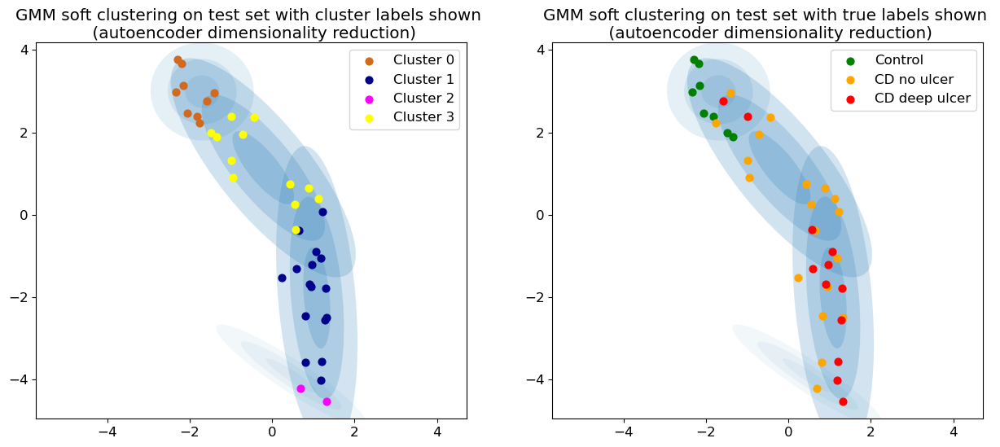

In [206]:
perplexity = 130
gmm_ae, X_train_ae, X_test_ae, X_val_ae = fit_gmm(full_ae_dataset, perplexity, num_c) # get 2D points
gmm_labels_ae = plot_gmm(gmm_ae, X_test_ae, X_val_ae, test_disease_labels, "autoencoder", num_c=num_c, test=True)

In [207]:
# np.where(X_test_ae >-30 )
# and X_test_ae[0] <-20
# (X_test_ae > -30 && X_test_ae < -20).all()
# y.logical_and(a, b)
# (X_test_ae[:,0] > -30) and (X_test_ae[:,1] < -20)
# arr = np.logical_and(X_test_ae[:,0] < -20, X_test_ae[:,1] < -12, X_test_ae[:,1] > -20)
# np.where(arr)

In [208]:
# X_test_ae[18,:]

## Process GMM cluster models

In [209]:
import scipy.stats
from scipy.stats import multivariate_normal


In [210]:
# vis
# x, y = np.mgrid[0:30:.01, 0:30:.01]
# pos = np.dstack((x, y))
# fig2 = plt.figure()
# ax2 = fig2.add_subplot(111)
# # for i in range(2):
# ax2.contourf(x, y, comps[0].pdf(pos))
# ax2.contourf(x, y, comps[2].pdf(pos))

In [211]:
def get_amount_matrix_gmm(gmm, X_train, train_disease_labels):
    mu, covar, w = gmm.means_, gmm.covariances_, gmm.weights_
    # print("means:",mu)
    # print("covariances_:",covar)
    # print("weights_:",w)
    
    comps = [multivariate_normal(mu[i], covar[i]) for i in range(num_c)]
    
    # make matrix to record amount of each class in each mixture component
    amounts = np.zeros((3, num_c))
    
    
    classes = ["control", "CD_no_ulcer", "CD_deep_ulcer"]
    for c, cls in enumerate(classes):
        for i, comp in enumerate(comps): # add up contributions for each component
            weight = w[i]
            pts = X_train[train_disease_labels==c]
            curr_sum = np.sum(comp.pdf(pts)) * weight
            amounts[c][i] = curr_sum
    print(amounts)
    #                cluster 0, cluster 1, cluster 2, cluster 3
    # control 
    # CD no ulcer
    # CD deep ulcer
    
    return amounts


def sum_to_one(vals): 
#     print(t, u)
    for i in range(vals.shape[0]):
        row = vals[i,:]
        vals[i,:] = row / row.sum()
    
    return vals


In [212]:
def get_class_probs(X_test, gmm, assignments, couple):
    clus_probs = sum_to_one(gmm.predict_proba(X_test))
#     print("clus_probs:",clus_probs)
    num_classes = 3
    
    arr = np.zeros((X_test.shape[0], num_classes))
    for c in range(num_classes):
        if assignments[c] == couple:
            arr[:,c] = np.max(clus_probs[:,couple], axis=1)
        else:
            cluster = assignments[c][0]
            arr[:,c] = clus_probs[:,cluster]
    arr = sum_to_one(arr)
            
    return np.argmax(arr, axis=1), arr

In [213]:
# gmm_prediction_ae(x_test_scaled)

In [214]:
# gmm_prediction_ae(x_test_scaled.iloc[[41],:])

In [215]:
def final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels):
    # process
    amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    assignments, couple = process_clusters(amounts, X_train, num_c)
    # retrieve clusters
#     gmm_labels = gmm.predict(X_test)
#     test_set_clusters = get_final_clusters(assignments, couple, gmm_labels)
    test_set_clusters, probs = get_class_probs(X_test, gmm, assignments, couple)
#     print(test_set_clusters)
#     print(probs)
    
    return test_set_clusters, probs



### Post-processed GMM models on test set

In [216]:
# gmm_labels_list = [gmm_labels_ae, gmm_labels_pca]
gmm_models_list = [gmm_ae, gmm_pca]
train_set_list = [X_train_ae, X_train_pca]
test_set_list = [X_test_ae, X_test_pca]


In [217]:
# X_test_ae

C:\Users\shard\AppData\Local\Temp\ipykernel_31124\2466639589.py:54: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: MatplotlibDeprecationWarning: Passing the angle parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.add_patch(Ellipse(position, nsig * width, nsig * height,
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\2466639589.py:54: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2)
C:\Users\shard\AppData\Local\Temp\ipykernel_31124\437439158.py:21: Matp

autoencoder
[[1.95550311e+00 1.66805253e-01 1.27493071e-69 6.55990550e-01]
 [1.46562675e+00 2.40810454e+00 7.58200303e-01 3.49975649e+00]
 [8.60912119e-02 2.12734375e+00 6.75369843e-01 9.94994634e-01]]
PCA
[[8.41907824e-002 1.43385451e-143 1.80115552e-002 1.37328605e-002]
 [5.10786309e-002 8.78391569e-002 1.85231142e-001 1.37016160e-001]
 [4.07953486e-004 4.91974353e-002 1.44880281e-001 3.22298325e-002]]


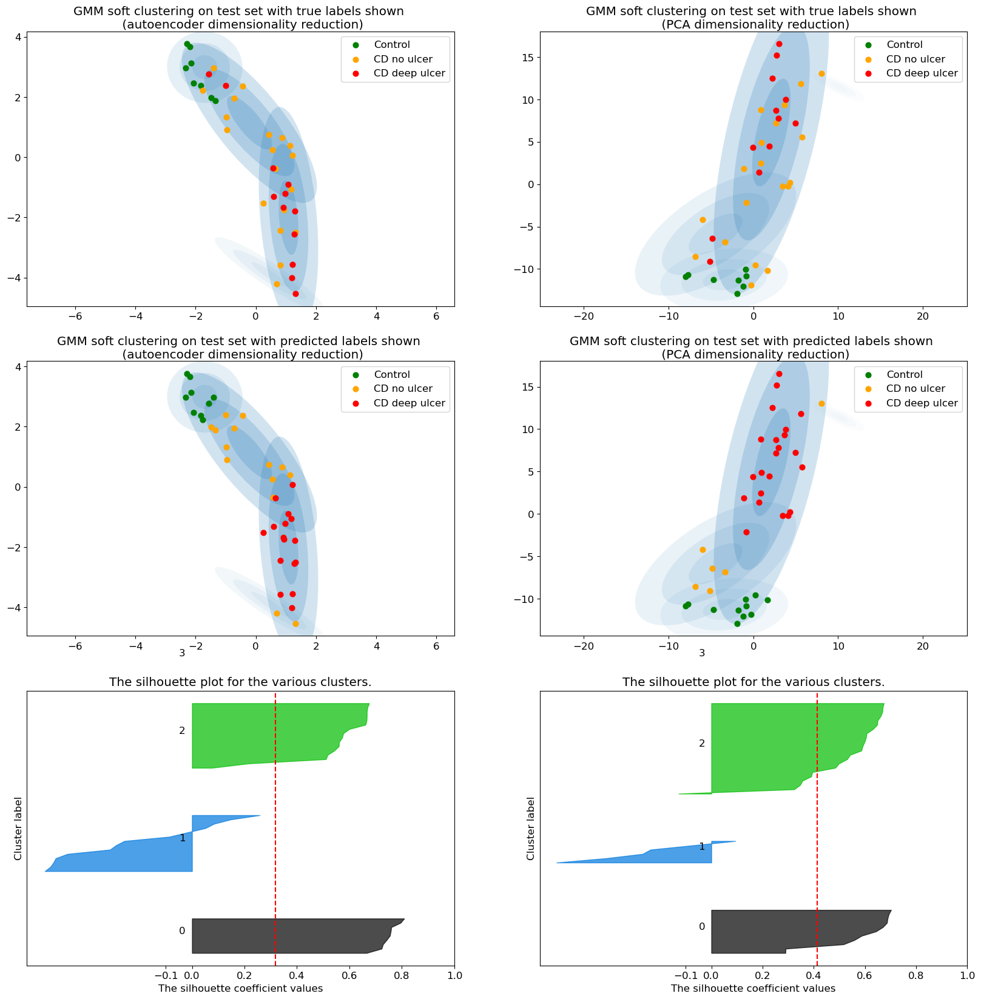

Autoencoder:
Average silhouette score: 0.31837204
Accuracy: 0.5897435897435898
F1 score: 0.5863548216489394
PCA:
Average silhouette score: 0.41418487
Accuracy: 0.5641025641025641
F1 score: 0.5096324521711519


In [218]:
plt.rcParams.update({'font.size': 12})

def plot_final_gmm_models(gmm_models_list, test_disease_labels, train_set_list, test_set_list, num_c):
#         left = -8
#         right = 8
#         ax.set_xlim(left, right)
#         ax.set_ylim(left, right)
        
        
#         if i==0:
#             num_clusters = num_c
#             cluster_names = ["Cluster " + str(i) for i in range(num_clusters)]
#             colours = ["chocolate", "darkblue", "magenta", "yellow", "blue"]
#             ax.set_title("GMM soft clustering on " + dset + " set with cluster labels shown \n (" + reduction + " dimensionality reduction)",
#                          wrap=True)
#         else:
#     fig, ax = plt.subplots()
    (fig, subplots) = plt.subplots(3, 2, figsize=(20, 20))
    reduction = ["autoencoder", "PCA"]
    final_clusters_lst = []
    final_probs_lst = []
    label_type = ["true","predicted"]
    for t in range(2):
        label = label_type[t]
        for i in range(len(gmm_models_list)):
    #         print(i)
            ax = subplots[t][i]
            gmm = gmm_models_list[i]
    #         gmm_labels = gmm_labels_list[i]
            X_train = train_set_list[i]
            X_test = test_set_list[i]
    #         amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    #         assignments, couple = process_clusters(amounts, X_train, num_c)
    #         test_set_clusters = get_final_clusters(assignments, couple, gmm_labels)
            if t > 0:
                print(reduction[i])
                test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test, train_disease_labels)
                final_clusters_lst.append(test_set_clusters)
                final_probs_lst.append(probs)
            else:
                test_set_clusters = test_disease_labels




            reduc = reduction[i]
            num_clusters = 3
            cluster_names = ["Control", "CD no ulcer", "CD deep ulcer"]
            colours = ["green", "orange", "red"]
            ax.set_title("GMM soft clustering on test set with "+ label +" labels shown \n (" + reduc + " dimensionality reduction)",
                        wrap=True)

            for i in range(num_clusters):
                ax.scatter(X_test[test_set_clusters==i, 0], X_test[test_set_clusters==i, 1], c=colours[i], label=cluster_names[i], s=40, cmap='viridis', zorder=2) 

            ax.axis('equal')


            w_factor = 0.2 / gmm.weights_.max()
            for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
                draw_ellipse(pos, covar, alpha=w * w_factor, ax=ax)
            ax.legend()

#     s_avgs = []
#     for j in range(2):
#         ax = subplots[2][j]
#         X_test = test_set_list[j]
#         test_clusters = final_clusters_lst[j]

#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
#         s_avgs.append(silhouette_avg)
#         plot_silhouette(num_c, test_clusters, sample_silhouette_values, silhouette_avg, ax)
        
#             s_avgs = []


    s_avgs = []        
    accs = []
    f1_scores = []
    for j in range(2):
        ax = subplots[2][j]
        X_test = test_set_list[j]
        test_clusters = final_clusters_lst[j]

#         silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test, test_clusters)
#         print(silhouette_avg)
        sil, sample_silhouette_values, acc, f1 = compute_metrics(X_test, test_disease_labels, test_clusters)
        s_avgs.append(sil)
        accs.append(acc)
        f1_scores.append(f1)
        plot_silhouette(num_c, test_clusters, sample_silhouette_values, sil, ax)

    plt.show()


    print_scores(s_avgs, accs, f1_scores)


    return final_clusters_lst, final_probs_lst
        
final_clusters_lst, final_probs_lst = plot_final_gmm_models(gmm_models_list, test_disease_labels, train_set_list, test_set_list, num_c)

3rd graph - substructure clustering processed in combination with true labels to obtain final 3 cluster clustering; model can now be easily coupled to shap - why better than simple k=3 clustering

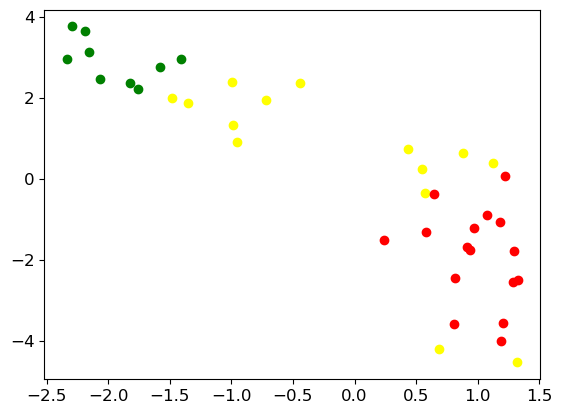

In [298]:
# plt.figure()
# plt.scatter(X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==0,0], X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==0,1], color='g')
# plt.scatter(X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==1,0], X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==1,1], color='yellow')
# plt.scatter(X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==2,0], X_test_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==2,1], color='red')
# plt.show()

In [301]:
# final_probs_gmm_ae[final_clusters_gmm_ae.reshape(1,-1)[0]==2]

array([[8.02972424e-53, 3.94059459e-05, 9.99960594e-01],
       [2.05027150e-30, 9.63039049e-02, 9.03696095e-01],
       [4.72701632e-22, 4.81079600e-01, 5.18920400e-01],
       [1.42479054e-38, 1.78022216e-03, 9.98219778e-01],
       [2.09958614e-22, 4.57720042e-01, 5.42279958e-01],
       [3.37522751e-69, 6.88919359e-07, 9.99999311e-01],
       [1.00243251e-39, 1.18895512e-03, 9.98811045e-01],
       [2.37038849e-77, 1.38523842e-01, 8.61476158e-01],
       [1.43783056e-31, 4.37641205e-03, 9.95623588e-01],
       [6.66082734e-33, 6.48355575e-02, 9.35164443e-01],
       [1.52177857e-42, 3.45216428e-03, 9.96547836e-01],
       [1.12058276e-66, 9.03852915e-03, 9.90961471e-01],
       [2.65536228e-53, 2.08733399e-05, 9.99979127e-01],
       [1.57664308e-48, 4.87127503e-06, 9.99995129e-01],
       [2.27724356e-33, 2.37090711e-02, 9.76290929e-01],
       [9.92935715e-32, 1.19833160e-02, 9.88016684e-01]])

In [295]:
# final_clusters_gmm_ae.reshape(1,-1)[0]==0

array([False, False, False, False,  True,  True, False, False,  True,
       False, False, False, False, False,  True, False,  True,  True,
       False, False, False, False, False,  True, False, False, False,
        True, False, False, False, False, False,  True, False, False,
       False, False, False])

## Evaluation of final clustering models

In [219]:
final_clusters_gmm_ae, final_clusters_gmm_pca = final_clusters_lst
final_probs_gmm_ae, final_probs_gmm_pca = final_probs_lst

In [220]:
test_disease_labels = test_disease_labels.reshape(1,-1)[0]

In [221]:
test_labels = test_disease_labels.reshape(-1,1)

In [285]:
test_disease_labels

array([1, 0, 2, 1, 1, 1, 2, 2, 0, 1, 1, 1, 2, 1, 0, 2, 0, 2, 0, 1, 2, 1,
       2, 0, 1, 2, 1, 0, 1, 1, 1, 2, 1, 0, 1, 1, 1, 2, 2])

## CD vs control (binary classification)

In [222]:
test_disease_labels_binary = test_disease_labels.copy()
test_disease_labels_binary[test_disease_labels_binary==2] = 1
test_disease_labels_binary = test_disease_labels_binary.reshape(-1,1)

### GMM

In [223]:
final_clusters_gmm_ae_binary = final_clusters_gmm_ae.copy()
final_clusters_gmm_ae_binary[final_clusters_gmm_ae_binary==2] = 1
final_clusters_gmm_ae_binary = final_clusters_gmm_ae_binary.reshape(-1,1)

In [224]:
final_clusters_gmm_pca_binary = final_clusters_gmm_pca.copy()
final_clusters_gmm_pca_binary[final_clusters_gmm_pca_binary==2] = 1
final_clusters_gmm_pca_binary = final_clusters_gmm_pca_binary.reshape(-1,1)

In [225]:
# AE
accuracy_score(test_disease_labels_binary, final_clusters_gmm_ae_binary)

0.8717948717948718

In [226]:
f1_score(test_disease_labels_binary, final_clusters_gmm_ae_binary)

0.9180327868852459

In [227]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_gmm_ae_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.41252565

In [228]:
# PCA
accuracy_score(test_disease_labels_binary, final_clusters_gmm_pca_binary)

0.9230769230769231

In [229]:
f1_score(test_disease_labels_binary, final_clusters_gmm_pca_binary)

0.9491525423728813

In [230]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_gmm_pca_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.44283912

### KMeans

In [231]:
final_clusters_km_ae_binary = final_clusters_ae.copy()
final_clusters_km_ae_binary[final_clusters_km_ae_binary==2] = 1
final_clusters_km_ae_binary = final_clusters_km_ae_binary.reshape(-1,1)

final_clusters_km_pca_binary = final_clusters_pca.copy()
final_clusters_km_pca_binary[final_clusters_km_pca_binary==2] = 1
final_clusters_km_pca_binary = final_clusters_km_pca_binary.reshape(-1,1)

In [232]:
# AE
accuracy_score(test_disease_labels_binary, final_clusters_km_ae_binary)

0.8717948717948718

In [233]:
f1_score(test_disease_labels_binary, final_clusters_km_ae_binary)

0.9122807017543859

In [234]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_km_ae_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.5490795

In [235]:
# PCA
accuracy_score(test_disease_labels_binary, final_clusters_km_pca_binary)

0.8461538461538461

In [236]:
f1_score(test_disease_labels_binary, final_clusters_km_pca_binary)

0.8928571428571428

In [237]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_km_pca_binary)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.53932613

## Control, CD no ulcer, CD deep ulcer (multiclass)

### GMM

In [238]:
final_clusters_gmm_ae = final_clusters_gmm_ae.reshape(-1,1)
final_clusters_gmm_pca = final_clusters_gmm_pca.reshape(-1,1)


In [239]:
final_clusters_gmm_ae.shape

(39, 1)

In [240]:
test_disease_labels.shape

(39,)

### Autoencoder

In [241]:
accuracy = accuracy_score(test_disease_labels, final_clusters_gmm_ae)
accuracy

0.5897435897435898

In [242]:
f1_score(test_disease_labels, final_clusters_gmm_ae, average='weighted')

0.5863548216489394

In [243]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_gmm_ae)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.31837204

### PCA

In [244]:
accuracy = accuracy_score(test_disease_labels, final_clusters_gmm_pca)
accuracy

0.5641025641025641

In [245]:
f1_score(test_disease_labels, final_clusters_gmm_pca, average='weighted')

0.5096324521711519

In [246]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_gmm_pca)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.41418487

### KMeans

In [247]:
final_clusters_ae = final_clusters_ae.reshape(-1,1)
final_clusters_pca = final_clusters_pca.reshape(-1,1)

### Autoencoder

In [248]:
km_ae_accuracy = accuracy_score(test_disease_labels, final_clusters_ae)
km_ae_accuracy

0.6410256410256411

In [249]:
f1_score(test_disease_labels, final_clusters_ae, average='weighted')

0.6059110823816706

In [250]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_ae, final_clusters_ae)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.47947982

### PCA

In [251]:
km_pca_accuracy = accuracy_score(test_disease_labels, final_clusters_pca)
km_pca_accuracy

0.5897435897435898

In [252]:
f1_score(test_disease_labels, final_clusters_pca, average='weighted')

0.5699818699818702

In [253]:
silhouette_avg, sample_silhouette_values = compute_silh_scores(X_test_pca, final_clusters_pca)
silhouette_avg

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.4042503

## Find class probabilities from cluster model

In [254]:
def get_probs(point, comps, assignments, w):
    probs = []
    for elem in assignments:
        p_cand = []
        for cluster in elem:
            p = comps[cluster].pdf(point) * w[cluster]
#             print("p:",p)
            p_cand.append(p)
#         print(p_cand)
        p = max(p_cand)
        probs.append(p)
        
    return probs

def sum_to_one(vals): 
#     print(t, u)
    for i in range(vals.shape[0]):
        row = vals[i,:]
        vals[i,:] = row / row.sum()
    
    return vals




In [255]:
def get_proba(gmm, assignments, X_test):
    # GMM mixture component distributions
    mu, covar, w = gmm.means_, gmm.covariances_, gmm.weights_
    # print("means:",mu)
    # print("covariances_:",covar)
    # print("weights_:",w)
    comps = [multivariate_normal(mu[i], covar[i]) for i in range(num_c)]

    X_test = X_test.tolist()
    new_list = []
    for point in X_test:
        probs = get_probs(point, comps, assignments, gmm.weights_)
#         print(probs)
        new_list.append(probs)
    pdf_vals = np.asarray(new_list)
#     pdf_vals = -np.log(pdf_vals)
    
#     plt.figure()
#     xr = np.arange(len(pdf_vals))
#     plt.scatter(xr, pdf_vals[:,0])
#     plt.scatter(xr, pdf_vals[:,1])
#     plt.scatter(xr, pdf_vals[:,2])
#     plt.show()

    # rescale so adds up to 1
#     proba = pdf_vals.copy()
#     for i in range(len(proba)):
#         row = proba[i,:]
#         rescaled = softmax(row)

#         proba[i,:] = rescaled
    proba = pdf_vals
    
    return proba

In [256]:
# amounts = get_amount_matrix_gmm(gmm_ae, X_train_ae, train_disease_labels)
# assignments_ae, couple_ae = process_clusters(amounts, X_train_ae, num_c)
# assignments_ae

In [257]:
# amounts = get_amount_matrix_gmm(gmm_pca, X_train_pca, train_disease_labels)
# assignments_pca, couple_pca = process_clusters(amounts, X_train_pca, num_c)
# assignments_pca

In [258]:
# gmm = gmm_ae
# assignments = assignments_ae

In [259]:
# gmm_ae_prob = get_proba(gmm_ae, assignments_ae, X_test_ae)

In [260]:
# gmm_pca_prob = get_proba(gmm_pca, assignments_pca, X_test_pca)

## Retrieving probabilities across classes using GMM model

In [261]:
def save_gmm(gmm, reduction_type):
    path = "data/models/"
    # save to file
    gmm_name = path + 'gmm_' + reduction_type
    np.save(gmm_name + '_weights', gmm.weights_, allow_pickle=False)
#     print('Saved ' + gmm_name + '_weights.npy')
    np.save(gmm_name + '_means', gmm.means_, allow_pickle=False)
    np.save(gmm_name + '_covariances', gmm.covariances_, allow_pickle=False)
    
def load_gmm(gmm_name):
    # reload
    means = np.load(gmm_name + '_means.npy')
    covar = np.load(gmm_name + '_covariances.npy')
    loaded_gmm = mixture.GaussianMixture(n_components = len(means), covariance_type='full')
    loaded_gmm.precisions_cholesky_ = np.linalg.cholesky(np.linalg.inv(covar))
    loaded_gmm.weights_ = np.load(gmm_name + '_weights.npy')
    loaded_gmm.means_ = means
    loaded_gmm.covariances_ = covar
    
    return loaded_gmm


In [262]:
full_pca_dataset.iloc[split_pt:,:] = full_pca_dataset.iloc[split_pt:,:]
full_pca_dataset

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,-1.461869,0.312784,-0.770411,1.219717,-0.725694,0.335408,0.309763,1.241698,0.610975,0.398484,...,0.550356,-0.165409,0.159807,0.003732,0.218056,0.055011,-0.036557,-0.212348,0.354704,0.029228
168_CD_plain,0.384880,-0.820272,0.155678,0.468275,-0.723663,-0.717065,0.103120,-0.169787,-0.151537,-0.105761,...,0.552342,0.314761,0.222862,0.242098,-0.368742,-0.065543,0.107414,-0.420373,0.058976,-0.147350
72_control,-2.529019,-0.096770,0.721775,1.481507,0.118808,0.463042,-0.075846,-0.199046,0.062294,-0.277856,...,-0.001288,0.071817,-0.064760,0.101796,-0.308943,-0.090795,-0.081380,-0.055851,0.269651,-0.100718
120_control,0.410865,-1.139601,-0.405603,-0.176030,0.439799,-0.037940,-0.222627,-0.055194,0.125315,-0.020766,...,0.445060,-0.143989,0.181802,-0.249087,0.016004,0.189836,0.048886,0.353471,-0.107195,-0.060670
258_CD_plain,-1.018445,-0.024037,-0.720988,-0.603787,0.251328,-0.143995,-0.655142,0.125139,0.089928,0.092564,...,0.122230,-0.062753,-0.003717,-0.035411,-0.030200,0.011619,-0.171009,-0.157764,-0.364664,0.008612
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,-0.477310,1.130148,-0.734325,0.454801,-0.584301,-0.478209,0.412543,0.029174,-0.719699,-0.309353,...,-0.095207,0.151557,-0.148757,-0.092562,0.031276,-0.145576,0.177305,0.098179,0.397369,0.255549
279_CD_plain,3.417549,1.382808,1.942401,-0.304999,0.228169,0.282687,-0.475716,0.917496,-0.446248,-0.228216,...,-0.157664,0.037941,0.013190,0.280216,-0.419030,-0.057590,-0.289570,-0.117828,-0.191845,0.280406
179_CD_plain,-1.196468,0.592322,-1.228231,-0.347368,-0.185726,-0.228885,0.016700,-0.151075,0.140716,0.162066,...,0.189723,0.003094,0.245083,0.037956,-0.056109,0.026790,0.248756,0.113736,-0.067010,0.140892


In [263]:
full_ds

,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,C1QTNF5,ZBTB8B,EEF1A1P16,SLX1A_SULT1A3,SF3A3P1,ZNRF2P1,IGLV2_5,C6orf106,RPL7AP54,LCE2A
Patient_ID,,,,,,,,,,,,,,,,,,,,,
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.0,0.71077,0.0,0.564155,0.0,0.410548,0.0,0.466889,0.0,1.000000
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.0,0.00000,0.0,0.619646,0.0,0.576526,0.0,0.247033,0.0,0.008198
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.0,0.00000,0.0,0.978062,0.0,0.322280,0.0,0.809681,0.0,0.618383
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.0,0.00000,0.0,0.630496,0.0,0.633583,0.0,0.568599,0.0,0.208173
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.0,0.00000,0.0,0.575404,0.0,0.754246,0.0,0.349619,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,0.736123,0.658232,0.772323,0.685637,0.658755,0.250970,0.247307,0.422075,0.555944,0.603675,...,0.0,0.00000,0.0,0.486418,0.0,0.625206,0.0,0.722622,0.0,0.000000
279_CD_plain,0.220614,0.202090,0.182810,0.113245,0.105744,0.699851,0.000000,0.908485,0.688912,0.178259,...,0.0,0.00000,0.0,0.217050,0.0,0.889784,0.0,0.514313,0.0,0.000000
179_CD_plain,0.724476,0.726774,0.766943,0.776284,0.690339,0.380637,0.440449,0.318944,0.558600,0.738787,...,0.0,0.00000,0.0,0.492356,0.0,0.744538,0.0,0.494143,0.0,0.165054


In [264]:
x_test_scaled.shape

(78, 220)

In [265]:
x_test_scaled[0:70].shape

(70, 220)

In [266]:

# def gmm_prediction_ae(x_test_scaled):
#     # preprocessing

#     full_dataset = full_ds.copy()
#     split_pt = len(full_dataset) - len(x_test_scaled)
#     full_dataset.iloc[split_pt:,:] = x_test_scaled

        
#     # dim redction - autoencoder
#     full_ae_dataset = ae_encode_dataset(full_dataset)
    
#     # tsne
#     tsne = manifold.TSNE(
#         n_components=2,
#         init="random",
#         random_state=0,
#         perplexity=24,
#         n_iter=750,
#         method='exact'
#     )
#     X = tsne.fit_transform(full_ae_dataset)
#     X_test = X[split_pt:]
    
#     path = "data/models/"
#     filename_assignments = path + "autoencoder_assignments"
#     filename_couple = path + "autoencoder_couple"
#     load_gmm_name = path + "gmm_autoencoder"
#     # load gmm model
#     gmm = load_gmm(load_gmm_name)
#     # load assignments
#     with open(filename_assignments, "rb") as fp:   # Unpickling
#         assignments = pickle.load(fp)
#     with open(filename_couple, "rb") as fp:   # Unpickling
#         couple = pickle.load(fp)
#     _, probs = get_class_probs(X_test, gmm, assignments, couple)
#     return probs

def gmm_prediction_ae(x_test_scaled):
    num_c = 4
    full_dataset = full_ds.copy()
    split_pt = len(full_dataset) - len(x_test_scaled)
    full_dataset.iloc[split_pt:,:] = x_test_scaled

    # format disease labels
    with open("data/d_labels", "rb") as fp:   # Unpickling
        full_disease_labels = pickle.load(fp)
    train_disease_labels = full_disease_labels[:split_pt]
    test_disease_labels = full_disease_labels[split_pt:]
    
    split_pt = None if split_pt == 0 else split_pt
    full_ae_dataset = ae_encode_dataset(full_dataset)
    perplexity = 120
    gmm, X_train, X_test, X_val = fit_gmm(full_ae_dataset, perplexity, num_c, split_pt=split_pt) # tSNE -> 2D pts
    
    if X_val is None:
        X = np.concatenate([X_train, X_test])
    else:
        X = np.concatenate([X_train, X_val, X_test])
        
    X_test = X[split_pt:]
    test_set_clusters, probs = final_gmm_model_get_clusters(gmm, X_train, X_test,train_disease_labels)
    print("probs shape:",probs.shape)
    return probs

def gmm_model_get_prediction_ae(x_test_scaled):
    full_length = 260
    if len(x_test_scaled) <= full_length:
        return gmm_prediction_ae(x_test_scaled)
    else:
        full_resp = np.empty((0,3))
        for i in range(0, len(x_test_scaled), full_length):
            end = i + full_length
            if end > len(x_test_scaled):
                end = len(x_test_scaled)
            next_resp = gmm_prediction_ae(x_test_scaled[i:end])
            full_resp = np.concatenate([full_resp, next_resp])
            print(full_resp.shape)
        return full_resp

In [267]:
def gmm_prediction_pca(x_test_scaled):
    # preprocessing
    full_dataset = full_ds.copy()
    split_pt = len(full_dataset) - len(x_test_scaled)
    full_dataset.iloc[split_pt:,:] = x_test_scaled
    
    # dim redction - PCA
    full_pca_dataset, _ = encode_pca(full_dataset)
    
    # tsne
    tsne = manifold.TSNE(
        n_components=2,
        init="random",
        random_state=0,
        perplexity=24,
        n_iter=750,
        method='exact'
    )
    X = tsne.fit_transform(full_pca_dataset)
    X_test = X[split_pt:]

    path = "data/models/"
    filename_assignments = path + "PCA_assignments"
    filename_couple = path + "PCA_couple"
    load_gmm_name = path + "gmm_PCA"
    # load gmm model
    gmm = load_gmm(load_gmm_name)
    # load assignments
    with open(filename_assignments, "rb") as fp:   # Unpickling
        assignments = pickle.load(fp)
    with open(filename_couple, "rb") as fp:   # Unpickling
        couple = pickle.load(fp)
    _, probs = get_class_probs(X_test, gmm, assignments, couple)
    return probs

def gmm_model_get_prediction_pca(x_test_scaled):
    if len(x_test_scaled) <= len(full_ds):
        return gmm_prediction_pca(x_test_scaled)
    else:
        full_resp = np.empty((0,3))
        for i in range(0, len(x_test_scaled), len(full_ds)):
            end = i + len(full_ds)
            if end > len(x_test_scaled):
                end = len(x_test_scaled)
            next_resp = gmm_prediction_pca(x_test_scaled[i:end])
            full_resp = np.concatenate([full_resp, next_resp])
        return full_resp

In [268]:
def final_gmm_model_get_prob(gmm, X_train, X_test, train_disease_labels, reduction_type, save = False):
    # process
    amounts = get_amount_matrix_gmm(gmm, X_train, train_disease_labels)
    assignments, couple = process_clusters(amounts, X_train, num_c)
    path = "data/models/"
    if save:
        # save gmm model
        save_gmm(gmm, reduction_type)
        # save assignments
        filename = path + reduction_type + "_assignments"
        filename_c = path + reduction_type + "_couple"
        with open(filename, "wb") as fp:   #Pickling
            pickle.dump(assignments, fp)
        with open(filename_c, "wb") as fp:   #Pickling
            pickle.dump(couple, fp)
    # retrieve clusters
#     probs = get_proba(gmm, assignments, X_test)
    _, probs = get_class_probs(X_test, gmm, assignments, couple)
    
    return probs



## GMM prediction with autoencoder dimensionality reduction

In [269]:
# save required components
gmm_ae_prob = final_gmm_model_get_prob(gmm_ae, X_train_ae, X_test_ae, train_disease_labels, "autoencoder", save=True)
# gmm_ae_prob

[[1.95550311e+00 1.66805253e-01 1.27493071e-69 6.55990550e-01]
 [1.46562675e+00 2.40810454e+00 7.58200303e-01 3.49975649e+00]
 [8.60912119e-02 2.12734375e+00 6.75369843e-01 9.94994634e-01]]


In [270]:
# x_test_scaledvv = np.empty((0,219))
# for i in range(100):
#     x_test_scaledvv = np.concatenate([x_test_scaledvv, x_test_scaled.values])
# x_test_scaledvv.shape

In [271]:
# x_test_scaledvv = pd.concat([x_test_scaled,x_test_scaled,x_test_scaled,x_test_scaled, x_test_scaled])
# x_test_scaledvv.shape

In [272]:
# x_test_scaledv = x_test_scaled.copy()
# for i in range(5):
#     x_test_scaledv = pd.concat([x_test_scaledv,x_test_scaledv])
    
# x_test_scaled.shape

In [273]:

gmm_ae_prob = gmm_model_get_prediction_ae(x_test_scaled)
gmm_ae_prob.shape

<class 'pandas.core.frame.DataFrame'>
[[1.61986897e+00 1.38257041e-01 1.50471986e-83 5.27573863e-01]
 [1.22591500e+00 2.01802541e+00 6.55558818e-01 2.85254808e+00]
 [7.34210137e-02 1.79307635e+00 5.35713082e-01 8.21209709e-01]]
probs shape: (78, 3)


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


(78, 3)

In [274]:
gmm_ae_prob

array([[9.54929002e-01, 4.50709982e-02, 5.09362519e-17],
       [7.72467222e-02, 9.22749647e-01, 3.63032677e-06],
       [2.67641136e-87, 7.18797707e-01, 2.81202293e-01],
       [1.79789390e-19, 6.67847334e-01, 3.32152666e-01],
       [7.34294124e-11, 9.99708128e-01, 2.91872066e-04],
       [9.61454550e-01, 3.85454496e-02, 2.52014448e-14],
       [1.24299632e-81, 3.77979230e-01, 6.22020770e-01],
       [2.62699100e-51, 2.93244864e-04, 9.99706755e-01],
       [3.58612930e-61, 7.07287193e-07, 9.99999293e-01],
       [9.54548162e-01, 4.54518376e-02, 7.00463647e-20],
       [2.89124272e-46, 5.68750320e-05, 9.99943125e-01],
       [3.97143060e-10, 9.95887389e-01, 4.11261085e-03],
       [5.32466937e-02, 9.46753306e-01, 2.86772977e-12],
       [5.91418487e-38, 3.57679930e-04, 9.99642320e-01],
       [1.95057118e-26, 1.83063916e-01, 8.16936084e-01],
       [1.80129164e-75, 2.31132692e-01, 7.68867308e-01],
       [5.82687778e-76, 9.76088888e-01, 2.39111118e-02],
       [1.08075183e-36, 5.15665

In [275]:
# accuracy_score(test_disease_labels, preds)

In [276]:
# X_train_ae

In [277]:
# path = "data/models/"
# #     filename_assignments = path + "autoencoder_assignments"
# #     filename_couple = path + "autoencoder_couple"
# load_gmm_name = path + "gmm_autoencoder"
# # load gmm model
# gmm_ae = load_gmm(load_gmm_name)
# cls, _ = final_gmm_model_get_clusters(gmm_ae, X_train_ae, X_test_ae, train_disease_labels)
# accuracy_score(test_disease_labels, cls)

In [278]:
# x_test_scaled.iloc[41,:]

In [279]:
# gmm_model_get_prediction_ae(x_test_scaled.head(1))

## GMM prediction with PCA dimensionality reduction

In [280]:
# save required components
gmm_pca_prob = final_gmm_model_get_prob(gmm_pca, X_train_pca, X_test_pca, train_disease_labels, "PCA", save=True)

[[8.41907824e-002 1.43385451e-143 1.80115552e-002 1.37328605e-002]
 [5.10786309e-002 8.78391569e-002 1.85231142e-001 1.37016160e-001]
 [4.07953486e-004 4.91974353e-002 1.44880281e-001 3.22298325e-002]]


In [281]:

gmm_pca_prob = gmm_model_get_prediction_pca(x_test_scaled)
gmm_pca_prob.shape

(78, 3)